# pop_decoding2

In [5]:
# General
import sys
import os.path as op
from time import time
from collections import OrderedDict as od
from glob import glob
import itertools
import warnings
from importlib import reload

# Scientific
import numpy as np
import pandas as pd
pd.options.display.max_rows = 100
pd.options.display.max_columns = 999

# Stats
import statsmodels.api as sm
from sklearn.utils.fixes import loguniform
import scipy.stats as stats
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import minmax_scale, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.model_selection import KFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics.pairwise import cosine_similarity

# Plots
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import matplotlib as mpl
from matplotlib.lines import Line2D
import matplotlib.patches as patches
# from mpl_toolkits.mplot3d import Axes3D
mpl.rcParams['grid.linewidth'] = 0.1
mpl.rcParams['grid.alpha'] = 0.75
mpl.rcParams['lines.linewidth'] = 1
mpl.rcParams['lines.markersize'] = 3
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
mpl.rcParams['xtick.major.width'] = 0.8
mpl.rcParams['ytick.major.width'] = 0.8
colors = ['1f77b4', 'd62728', '2ca02c', 'ff7f0e', '9467bd', 
          '8c564b', 'e377c2', '7f7f7f', 'bcbd22', '17becf']
mpl.rcParams['axes.prop_cycle'] = mpl.cycler('color', colors)
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.formatter.offset_threshold'] = 2
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['axes.labelpad'] = 8
mpl.rcParams['axes.titlesize'] = 16
mpl.rcParams['axes.grid'] = False
mpl.rcParams['axes.axisbelow'] = True
mpl.rcParams['legend.loc'] = 'upper right'
mpl.rcParams['legend.fontsize'] = 14
mpl.rcParams['legend.frameon'] = False
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['figure.titlesize'] = 16
mpl.rcParams['figure.figsize'] = (10, 4) 
mpl.rcParams['figure.subplot.wspace'] = 0.25 
mpl.rcParams['figure.subplot.hspace'] = 0.25 
mpl.rcParams['font.sans-serif'] = ['Helvetica']
mpl.rcParams['savefig.format'] = 'pdf'
mpl.rcParams['pdf.fonttype'] = 42

# Personal
sys.path.append('/home1/dscho/code/general')
sys.path.append('/home1/dscho/code/projects/manning_replication')
sys.path.append('/home1/dscho/code/projects')
import data_io as dio
import array_operations as aop
from eeg_plotting import plot_trace, plot_trace2
from time_cells import spike_sorting, spike_preproc, events_preproc, events_proc, time_bin_analysis, remapping, pop_decoding

font = {'tick': 12,
        'label': 14,
        'annot': 12,
        'fig': 16}

# Colors
n = 4
c = 2
colors = [sns.color_palette('Blues', n)[c], 
          sns.color_palette('Reds', n)[c], 
          sns.color_palette('Greens', n)[c],
          sns.color_palette('Purples', n)[c],
          sns.color_palette('Oranges', n)[c],
          sns.color_palette('Greys', n)[c],
          sns.color_palette('YlOrBr', n+3)[c],
          'k']
cmap = sns.palettes.blend_palette((colors[0], 
                                   'w',
                                   colors[1]), 501)

colws = od([('1', 6.55),
            ('2-1/2', 3.15),
            ('2-1/3', 2.1),
            ('2-2/3', 4.2),
            ('3', 2.083),
            ('4', 1.525),
            ('5', 1.19),
            ('6', 0.967),
            (1, 2.05),
            (2, 3.125),
            (3, 6.45),
            ('nat1w', 3.50394),
            ('nat2w', 7.20472),
            ('natl', 9.72441)])

proj_dir = '/home1/dscho/projects/time_cells'

In [3]:
def plot_lda(_df,
             x,
             y,
             hue=None,
             size=None,
             _cmap=None,
             **kws):
    # Separate odd from even trials.
    df = od([])
    centroids = od([])
    for trial_type in ('odd', 'even'):
        is_odd = True if (trial_type == 'odd') else False
        df[trial_type] = _df.loc[_df['is_odd']==is_odd].copy()
        
        # Min-max scale x and y columns.
        df[trial_type][[x, y]] = minmax_scale(df[trial_type][[x, y]].values, axis=0)
        
        # Get centroids for each gameStateTime.
        centroids[trial_type] = df[trial_type].groupby(['gameStateTime'])[[x, y]].apply(np.mean)

    # Plot params.
    colws = od([('1', 6.55),
                ('2-1/2', 3.2),
                ('2-1/3', 2.108),
                ('2-2/3', 4.292),
                ('3', 2.083),
                ('4', 1.525),
                ('5', 1.19),
                ('6', 0.967),
                (1, 2.05),
                (2, 3.125),
                (3, 6.45)])
    figsize = kws.pop('figsize', (colws['2-1/2'], colws['2-1/2'] * 0.5))
    dpi = kws.pop('dpi', 600)
    font = kws.pop('font', {'tick': 6, 'label': 7, 'annot': 6, 'fig': 9})
    alpha_points = kws.pop('alpha_points', 0.8)
    alpha_stars = kws.pop('alpha_stars', 1)
    linewidth = kws.pop('linewidth', 0.4)
    ax_linewidth = kws.pop('ax_linewidth', 0.5)
    ticklength = kws.pop('ticklength', 2)
    tickpad = kws.pop('tickpad', 1)
    show_legend = kws.pop('show_legend', False)
    bbox_to_anchor = kws.pop('bbox_to_anchor', [1.8, 1])
    if (hue) and (_cmap is None):
        n_cats = np.unique(df[trial_type][hue]).size
        if n_cats == 8:
            _cmap = [sns.color_palette('Blues')[4],
                     sns.color_palette('Reds')[5],
                     sns.color_palette('Reds')[3],
                     sns.color_palette('Reds')[1],
                     sns.color_palette('Greens')[4],
                     sns.color_palette('Purples')[5],
                     sns.color_palette('Purples')[3],
                     sns.color_palette('Purples')[1]]
        else:
            _cmap = list(sns.color_palette('viridis', n_cats))
    
    # Make the plot.
    plt.close()
    fig = plt.figure(figsize=figsize, dpi=1200)
    n_rows = 50
    n_cols = 100
    ax = [plt.subplot2grid((n_rows, n_cols), (0, 0), rowspan=50, colspan=38),
          plt.subplot2grid((n_rows, n_cols), (0, 42), rowspan=50, colspan=38)]
    ax = np.ravel(ax)
    
    for iax, trial_type in enumerate(['odd', 'even']):
        if show_legend:
            _show_legend = True if (iax != 0) else False
        else:
            _show_legend = False
        ax[iax] = sns.scatterplot(x=x, y=y, hue=hue, data=df[trial_type], ax=ax[iax],
                                  marker='.', s=size, palette=_cmap, alpha=alpha_points, 
                                  linewidth=linewidth, edgecolor='k', legend=_show_legend)
        ax[iax] = sns.scatterplot(x=x, y=y, hue=yvar, data=centroids[trial_type], ax=ax[iax],
                                  marker='*', s=size*3, palette=_cmap, alpha=alpha_stars, 
                                  linewidth=linewidth*1.5, edgecolor='k', legend=False)
        ax[iax].set_aspect('equal')
        ax[iax].tick_params(axis='both', width=ax_linewidth, length=ticklength, pad=tickpad, color='k', labelsize=font['tick'])
        for axis in ['left', 'bottom']:
            ax[iax].spines[axis].set_linewidth(ax_linewidth)
        ax[iax].set_xlim([-0.05, 1.05])
        xticks = [0, 0.25, 0.5, 0.75, 1]
        ax[iax].set_xticks(xticks)
        ax[iax].set_xticklabels(xticks)
        ax[iax].set_xlabel('')
        ax[iax].set_ylim(ax[iax].get_xlim())
        ax[iax].set_yticks(ax[iax].get_xticks())
        if iax == 0:
            ax[iax].set_yticklabels(ax[iax].get_xticklabels())
        else:
            ax[iax].set_yticklabels([''] * len(xticks))
        ax[iax].set_ylabel(ax[iax].get_xlabel())
        ax[iax].set_title('{} Trials'.format(trial_type.capitalize()), fontsize=font['fig'], pad=4)
        if _show_legend:
            legend = ax[iax].legend(loc=1, fontsize=font['annot'], frameon=False, 
                                    handletextpad=0, borderaxespad=0, bbox_to_anchor=bbox_to_anchor)
    return fig, ax

def plot_lda_3d(df,
                x,
                y,
                z,
                hue=None,
                **kws):
    # Min-max scale X.
    df[[x, y, z]] = minmax_scale(df[[x, y, z]].values, axis=0)
    
    # Plot params.
    colws = kws.pop('colws', {1: 2.05, 2: 3.125, 3: 6.45})
    figsize = (colws[2], colws[2] * 1)
    dpi = kws.pop('dpi', 600)
    font = kws.pop('font', {'tick': 8, 'label': 10, 'annot': 8, 'fig': 12})
    _cmap = od([('Delay 1:  0-10s', sns.color_palette('Blues')[4],),
                ('Encoding:  0-10s', sns.color_palette('Reds')[5]),
                ('Encoding: 10-20s', sns.color_palette('Reds')[3]),
                ('Encoding: 20-30s', sns.color_palette('Reds')[1]),
                ('Delay 2:  0-10s', sns.color_palette('Greens')[4]),
                ('Retrieval:  0-10s', sns.color_palette('Purples')[5]),
                ('Retrieval: 10-20s', sns.color_palette('Purples')[3]),
                ('Retrieval: 20-30s', sns.color_palette('Purples')[1])])
    colors = np.array([_cmap[x] for x in df['gameStateTime']])
    
    # Make the plot.
    plt.close()
    fig = plt.figure(figsize=figsize, dpi=dpi)
    ax = fig.add_subplot(111, projection='3d')
    
    ax.scatter(df[x], df[y], df[z], c=colors, data=df,
               linewidth=0.4, edgecolor='k')
    ax.set_aspect('equal')
    ax.tick_params(labelsize=font['tick'], length=2, width=0.8, pad=2, color='k')
    ax.set_xlim([-0.05, 1.05])
    xticks = [0, 0.25, 0.5, 0.75, 1]
    ax.set_xticks(xticks)
    ax.set_xticklabels(xticks)
    ax.set_xlabel('')
    ax.set_ylim(ax.get_xlim())
    ax.set_yticks(ax.get_xticks())
    ax.set_yticklabels(ax.get_xticklabels())
    ax.set_ylabel(ax.get_xlabel())
    ax.set_zlim(ax.get_xlim())
    ax.set_zticks(ax.get_xticks())
    ax.set_zticklabels(ax.get_xticklabels())
    ax.set_zlabel(ax.get_xlabel())
    #legend = ax.legend(loc=1, fontsize=font['annot'], handletextpad=0, bbox_to_anchor=[1.5, 1])
    
    return fig, ax

In [2]:
# Get sessions.
sessions = np.unique([op.basename(f).split('-')[0] 
                      for f in glob(op.join(proj_dir, 'analysis', 'events', '*-Events.pkl'))])
print('{} subjects, {} sessions'.format(len(np.unique([x.split('_')[0] for x in sessions])), len(sessions)))

10 subjects, 12 sessions


In [5]:
# Get spike counts in each time bin, for all neurons in the study.
pop_spikes = pop_decoding.load_pop_spikes()

print(pop_spikes)

457 neurons
500 ms time bins
36 trials
160 time bins/trial
pop_spikes: (5760, 460)


In [5]:
load_single_file = True

start_time = time()

# Load all time OLS result files.
filename = op.join(proj_dir, 'analysis', 'unit_to_behav', 'all_units_time',
                   'ols-time_bin-model_pairs-457units.pkl')
if load_single_file and op.exists(filename):
    ols_pairs = dio.open_pickle(filename)
else:
    ols_pairs_files = glob(op.join(proj_dir, 'analysis', 'unit_to_behav', '*-time_bin-model_pairs.pkl'))
    print('Found OLS outputs for {} neurons'.format(len(ols_pairs_files)))

    warnings.filterwarnings('ignore')
    bad_files = []
    ols_pairs = pd.DataFrame([])
    for filename in ols_pairs_files:
        try:
            ols_pairs = pd.concat((ols_pairs, dio.open_pickle(filename)))
        except:
            bad_files.append(filename)
    ols_pairs = ols_pairs.sort_values(['subj_sess', 'neuron']).reset_index(drop=True)
    warnings.resetwarnings()

    # Restrict dataframe rows to navigation periods.
    keep_cols = ['subj_sess', 'neuron', 'gameState', 'testvar', 'full', 'llf_full', 'lr', 'z_lr', 'emp_pval']
    # ols_pairs = ols_pairs.query("(gameState==['Encoding', 'Retrieval'])")[keep_cols].reset_index(drop=True)
    ols_pairs = ols_pairs[keep_cols].reset_index(drop=True)

    # Organize categorical columns.
    test_vars = ['time', 'place', 'head_direc', 'is_moving', 'base_in_view', 'gold_in_view', 'dig_performed']
    test_var_cat = pd.CategoricalDtype(test_vars, ordered=True)
    ols_pairs['testvar'] = ols_pairs['testvar'].astype(test_var_cat)

#     full_models = ['time', 'time_place', 'full']
#     full_model_cat = pd.CategoricalDtype(full_models, ordered=True)
#     ols_pairs['full'] = ols_pairs['full'].astype(full_model_cat)

    # Add new columns.
    roi_map = spike_preproc.roi_mapping(n=3)
    val_map = od([('hem', []),
                  ('roi', []),
                  ('roi_gen', []),
                  ('spike_mat'        , []),
                  ('mean_frs'         , []),
                  ('sem_frs'          , []),
                  ('fr_mean'          , []),
                  ('fr_max'           , []),
                  ('fr_max_ind'       , []),
                  ('sparsity'         , [])])
    for idx, row in ols_pairs.iterrows():
        if 'event_spikes' not in dir():
            event_spikes = time_bin_analysis.load_event_spikes(row['subj_sess'], verbose=False)
        elif event_spikes.subj_sess != row['subj_sess']:
            event_spikes = time_bin_analysis.load_event_spikes(row['subj_sess'], verbose=False)
        hemroi = spike_preproc.roi_lookup(row['subj_sess'], row['neuron'].split('-')[0])
        hem = hemroi[0]
        roi = hemroi[1:]
        roi_gen = roi_map.get(roi, np.nan)
        spike_mat = event_spikes.get_spike_mat(row['neuron'], row['gameState'])
        mean_frs = time_bin_analysis.get_mean_frs(spike_mat) * 2
        sem_frs = time_bin_analysis.get_sem_frs(spike_mat) * 2
        fr_mean = np.mean(mean_frs.values)
        fr_max = np.max(mean_frs.values)
        fr_max_ind = np.argmax(mean_frs.values)
        sparsity = time_bin_analysis.get_sparsity(spike_mat)

        val_map['hem'].append(hem)
        val_map['roi'].append(roi)
        val_map['roi_gen'].append(roi_gen)
        val_map['spike_mat'].append(spike_mat.values.tolist())
        val_map['mean_frs'].append(mean_frs.tolist())
        val_map['sem_frs'].append(sem_frs.tolist())
        val_map['fr_mean'].append(fr_mean)
        val_map['fr_max'].append(fr_max)
        val_map['fr_max_ind'].append(fr_max_ind)
        val_map['sparsity'].append(sparsity)

    ols_pairs.insert(0, 'subj', ols_pairs['subj_sess'].apply(lambda x: x.split('_')[0]))
    ols_pairs.insert(2, 'subj_sess_unit', ols_pairs.apply(lambda x: '{}-{}'.format(x['subj_sess'], x['neuron']), axis=1))
    ols_pairs.insert(4, 'hem', val_map['hem'])
    ols_pairs.insert(5, 'roi', val_map['roi'])
    ols_pairs.insert(6, 'roi_gen', val_map['roi_gen'])
    for col_name in val_map:
        if col_name not in ols_pairs:
            ols_pairs[col_name] = val_map[col_name]
    roi_gen_cat = ['Hippocampus', 'MTL', 'Cortex']
    ols_pairs['roi_gen'] = ols_pairs['roi_gen'].astype(pd.CategoricalDtype(roi_gen_cat, ordered=True))
    ols_pairs.insert(ols_pairs.columns.tolist().index('roi_gen')+1, 'roi_gen2', ols_pairs['roi_gen'].tolist())
    ols_pairs.loc[ols_pairs['roi_gen']=='Hippocampus', 'roi_gen2'] = 'MTL'
    ols_pairs['roi_gen2'] = ols_pairs['roi_gen2'].astype(pd.CategoricalDtype(['MTL', 'Cortex'], ordered=True))
    
    # Test significance.
    alpha = 0.05
    ols_pairs['sig'] = False
    ols_pairs.loc[((ols_pairs['emp_pval']<alpha)), 'sig'] = True
    ols_pairs['sig_holm'] = ols_pairs.groupby(['subj_sess_unit', 'gameState', 'full'])['emp_pval'].transform(lambda x: sm.stats.multipletests(x, alpha, method='holm')[0])

    print('{} bad files'.format(len(bad_files)))

    
def _fr_max_ind(spike_mat, bins=10):
    return np.argmax([v.sum() for v in np.split(np.sum(spike_mat, axis=0), bins)])

icol = ols_pairs.columns.tolist().index('fr_max_ind') + 1
if 'fr_max_ind10' not in ols_pairs:
    ols_pairs.insert(icol, 'fr_max_ind10', ols_pairs['spike_mat'].apply(lambda x: _fr_max_ind(x, 10)))
if 'fr_max_ind5' not in ols_pairs:
    ols_pairs.insert(icol+2, 'fr_max_ind5', ols_pairs['spike_mat'].apply(lambda x: _fr_max_ind(x, 5)))

print('ols_pairs:', ols_pairs.shape)

print('Done in {:.1f}s'.format(time() - start_time))

Found OLS outputs for 0 neurons


KeyError: 'subj_sess'

# Representational similarity

In [62]:
# Trial bound corrs across only time cells.
def trial_bound_corrs(time_step_size=5000,
                      only_time_cells=False,
                      save_results=True,
                      overwrite=False,
                      verbose=True,
                      proj_dir='/home1/dscho/projects/time_cells'):
    """Calculate Pearson correlation between trial interval boundaries for diff. trial pairs."""
    # Load ols_pairs and find all significant time cells across trial intervals.
    filename = op.join(proj_dir, 'analysis', 'unit_to_behav', 'all_units_time',
                       'ols-time_bin-model_pairs-457units.pkl')
    ols_pairs = dio.open_pickle(filename)
    all_time_cells = ols_pairs.query("(testvar=='time') & (sig==True) & (beta_abs_max>0)")['subj_sess_unit'].unique().tolist()
    
    # Load output file, if it exists.
    if only_time_cells:
        filename = op.join(proj_dir, 'analysis', 'trial_interval_boundaries',
                           'trial_pair_corrs-{}ms_bins-{}_time_cells-{}_units.pkl'
                           .format(time_step_size, len(all_time_cells), ols_pairs['subj_sess_unit'].unique().size))
    else:
        filename = op.join(proj_dir, 'analysis', 'trial_interval_boundaries',
                           'trial_pair_corrs-{}ms_bins-{}_units.pkl'
                           .format(time_step_size, ols_pairs['subj_sess_unit'].unique().size))
    if op.exists(filename) and not overwrite:
        pwise_corrs = dio.open_pickle(filename)
        return pwise_corrs
    
    # Load pop_spikes.
    pop_spikes = pop_decoding.load_pop_spikes()
    
    # Aggregate spikes within time steps.
    _pop_spikes = pop_spikes.combine_time_bins(time_step_size=time_step_size)

    # Keep only time cells.
    if only_time_cells:
        neurons = all_time_cells
    else:
        neurons = ols_pairs['subj_sess_unit'].unique().tolist()
    keep_cols = ['trial', 'gameState', 'iGameState', 'iGameStateTime', 'time_step'] + neurons
    _pop_spikes = _pop_spikes[keep_cols]

    # Z-score each neuron's firing across time steps.
    _pop_spikes[neurons] = stats.zscore(_pop_spikes[neurons], axis=0)

    # Get all non-matching trial pairs.
    trials = _pop_spikes['trial'].unique().tolist()
    n_trials = len(trials)
    trial_pairs = remapping.pairwise_combs(n_trials)

    # Get time bin pairs that we want to analyze.
    gsts = _pop_spikes.groupby('gameState')['iGameStateTime'].apply(np.unique)
    time_pairs = od([('Delay1_Encoding', {'hypo'         : (gsts['Delay1'][-1],    gsts['Encoding'][0]),
                                          'wrong_time1'  : (gsts['Delay1'][0],     gsts['Encoding'][0]),
                                          'wrong_time2'  : (gsts['Delay1'][-1],    gsts['Encoding'][-1]),
                                          'wrong_gs1'    : (gsts['Delay2'][-1],    gsts['Encoding'][0]),
                                          'wrong_gs2'    : (gsts['Delay1'][-1],    gsts['Retrieval'][0])}),
                     ('Encoding_Delay2', {'hypo'         : (gsts['Encoding'][-1],  gsts['Delay2'][0]),
                                          'wrong_time1'  : (gsts['Encoding'][0],   gsts['Delay2'][0]),
                                          'wrong_time2'  : (gsts['Encoding'][-1],  gsts['Delay2'][-1]),
                                          'wrong_gs1'    : (gsts['Retrieval'][-1], gsts['Delay2'][0]),
                                          'wrong_gs2'    : (gsts['Encoding'][-1],  gsts['Delay1'][0])}),
                     ('Delay2_Retrieval', {'hypo'        : (gsts['Delay2'][-1],    gsts['Retrieval'][0]),
                                           'wrong_time1' : (gsts['Delay2'][0],     gsts['Retrieval'][0]),
                                           'wrong_time2' : (gsts['Delay2'][-1],    gsts['Retrieval'][-1]), 
                                           'wrong_gs1'   : (gsts['Delay1'][-1],    gsts['Retrieval'][0]),
                                           'wrong_gs2'   : (gsts['Delay2'][-1],    gsts['Encoding'][0])}),
                     ('Retrieval_Delay1', {'hypo'        : (gsts['Retrieval'][-1], gsts['Delay1'][0]),
                                           'wrong_time1' : (gsts['Retrieval'][0],  gsts['Delay1'][0]),
                                           'wrong_time2' : (gsts['Retrieval'][-1], gsts['Delay1'][-1]),
                                           'wrong_gs1'   : (gsts['Encoding'][-1],  gsts['Delay1'][0]),
                                           'wrong_gs2'   : (gsts['Retrieval'][-1], gsts['Delay2'][0])})
                    ])

    # Calculate the Pearson correlations between each time pair, within each trial pair.
    qry = "(trial=={}) & (iGameStateTime=={})"
    ctrls = ['wrong_time1', 'wrong_time2', 'wrong_gs1', 'wrong_gs2']
    pwise_corrs = []
    for iTrial1, iTrial2 in trial_pairs:
        trial1 = trials[iTrial1]
        trial2 = trials[iTrial2]
        for cond in time_pairs:
            gstime1_hypo, gstime2_hypo = time_pairs[cond]['hypo']
            corr_hypo = stats.pearsonr(_pop_spikes.query(qry.format(trial1, gstime1_hypo))[neurons].values.flatten(),
                                       _pop_spikes.query(qry.format(trial2, gstime2_hypo))[neurons].values.flatten())[0]
            for ctrl in ctrls:
                gstime1_ctrl, gstime2_ctrl = time_pairs[cond][ctrl]
                corr_ctrl = stats.pearsonr(_pop_spikes.query(qry.format(trial1, gstime1_ctrl))[neurons].values.flatten(),
                                           _pop_spikes.query(qry.format(trial2, gstime2_ctrl))[neurons].values.flatten())[0]
                corr_diff = corr_hypo - corr_ctrl
                pwise_corrs.append([trial1, trial2, cond, ctrl,
                                    gstime1_hypo, gstime2_hypo, gstime1_ctrl, gstime2_ctrl,
                                    corr_hypo, corr_ctrl, corr_diff])

    col_names = ['trial1', 'trial2', 'cond', 'ctrl',
                 'gstime1_hypo', 'gstime2_hypo', 'gstime1_ctrl', 'gstime2_ctrl',
                 'corr_hypo', 'corr_ctrl', 'corr_diff']
    pwise_corrs = pd.DataFrame(pwise_corrs, columns=col_names)
    pwise_corrs.insert(2, 'trial1_block', pwise_corrs['trial1'].apply(lambda x: 1 + int((x-1)/12)))
    pwise_corrs.insert(3, 'trial2_block', pwise_corrs['trial2'].apply(lambda x: 1 + int((x-1)/12)))
    pwise_corrs.insert(4, 'within_block', 1 * (pwise_corrs['trial1_block']==pwise_corrs['trial2_block']))

    if save_results:
        dio.save_pickle(pwise_corrs, filename, verbose)
    
    return pwise_corrs

In [67]:
# Calculate representational similarity across trial interval boundaries.
save_results = True
overwrite = False
time_step_size = 5000
only_time_cells = False

start_time = time()

pwise_corrs = trial_bound_corrs(time_step_size,
                                only_time_cells=only_time_cells,
                                save_results=save_results,
                                overwrite=overwrite)
    
print('Done in {:.1f}s'.format(time() - start_time))

# # -------------------------------------------------------------
# only_time_cells = False
# time_step_size = 2500

# start_time = time()

# pwise_corrs = trial_bound_corrs(time_step_size,
#                                 only_time_cells=only_time_cells)
    
# print('Done in {:.1f}s'.format(time() - start_time))

Done in 0.8s


In [66]:
# All cells, 2500ms windows.
def mean_sem(x):
    return '{:.4f} ± {:.4f}'.format(np.mean(x), stats.sem(x))
    
for ctrl_type in ['wrong_gs', 'wrong_time']:
    _df = pwise_corrs.query("(ctrl==['{}1', '{}2'])".format(ctrl_type, ctrl_type))
    dof = len(_df) - 1
    tval, pval = stats.ttest_rel(_df['corr_hypo'], _df['corr_ctrl'])
    print(ctrl_type, '-'*len(ctrl_type), sep='\n')
    for col in ['corr_hypo', 'corr_ctrl', 'corr_diff']:
        print('{}: {}'.format(col, mean_sem(_df[col])))
    print('corr > hypo: t({}) = {:.1f}, p = {}'.format(dof, tval, pval), end='\n'*2)

wrong_gs
--------
corr_hypo: 0.0045 ± 0.0009
corr_ctrl: -0.0063 ± 0.0008
corr_diff: 0.0108 ± 0.0010
corr > hypo: t(5039) = 10.8, p = 9.114519270132805e-27

wrong_time
----------
corr_hypo: 0.0045 ± 0.0009
corr_ctrl: -0.0012 ± 0.0008
corr_diff: 0.0058 ± 0.0011
corr > hypo: t(5039) = 5.5, p = 4.486080759485384e-08



In [69]:
# All cells, 5000ms windows.
def mean_sem(x):
    return '{:.4f} ± {:.4f}'.format(np.mean(x), stats.sem(x))
    
for ctrl_type in ['wrong_gs', 'wrong_time']:
    _df = pwise_corrs.query("(ctrl==['{}1', '{}2'])".format(ctrl_type, ctrl_type))
    dof = len(_df) - 1
    tval, pval = stats.ttest_rel(_df['corr_hypo'], _df['corr_ctrl'])
    print(ctrl_type, '-'*len(ctrl_type), sep='\n')
    for col in ['corr_hypo', 'corr_ctrl', 'corr_diff']:
        print('{}: {}'.format(col, mean_sem(_df[col])))
    print('corr > hypo: t({}) = {:.1f}, p = {}'.format(dof, tval, pval), end='\n'*2)

wrong_gs
--------
corr_hypo: 0.0026 ± 0.0010
corr_ctrl: -0.0133 ± 0.0009
corr_diff: 0.0159 ± 0.0010
corr > hypo: t(5039) = 15.2, p = 3.24283482600019e-51

wrong_time
----------
corr_hypo: 0.0026 ± 0.0010
corr_ctrl: -0.0107 ± 0.0009
corr_diff: 0.0132 ± 0.0010
corr > hypo: t(5039) = 12.7, p = 2.1005815309461354e-36



In [58]:
# Time cells, 5000ms windows.
def mean_sem(x):
    return '{:.4f} ± {:.4f}'.format(np.mean(x), stats.sem(x))
    
for ctrl_type in ['wrong_gs', 'wrong_time']:
    _df = pwise_corrs.query("(ctrl==['{}1', '{}2'])".format(ctrl_type, ctrl_type))
    dof = len(_df) - 1
    tval, pval = stats.ttest_rel(_df['corr_hypo'], _df['corr_ctrl'])
    print(ctrl_type, '-'*len(ctrl_type), sep='\n')
    for col in ['corr_hypo', 'corr_ctrl', 'corr_diff']:
        print('{}: {}'.format(col, mean_sem(_df[col])))
    print('corr > hypo: t({}) = {:.1f}, p = {}'.format(dof, tval, pval), end='\n'*2)

wrong_gs
--------
corr_hypo: 0.0069 ± 0.0014
corr_ctrl: -0.0153 ± 0.0014
corr_diff: 0.0222 ± 0.0016
corr > hypo: t(5039) = 13.5, p = 7.929245133656069e-41

wrong_time
----------
corr_hypo: 0.0069 ± 0.0014
corr_ctrl: -0.0142 ± 0.0014
corr_diff: 0.0211 ± 0.0017
corr > hypo: t(5039) = 12.2, p = 8.770108373140158e-34



In [21]:
pwise_corrs[['corr_hypo', 'corr_ctrl']].max().max()

0.666062367642679

In [45]:
pwise_corrs.query("(ctrl==['wrong_time1', 'wrong_time2'])").shape

(5040, 14)

In [31]:
tval, pval = stats.ttest_1samp(pwise_corrs.query("(ctrl=={})".format(ctrls[0]))['corr_diff'], popmean=0)

Ttest_1sampResult(statistic=12.20462128381088, pvalue=8.770108373140158e-34)

0.01 ± 0.00 (t(5039) = 12.2, p = 8.770108373140158e-34)
0.01 ± 0.00 (t(5039) = 13.5, p = 7.929245133656069e-41)


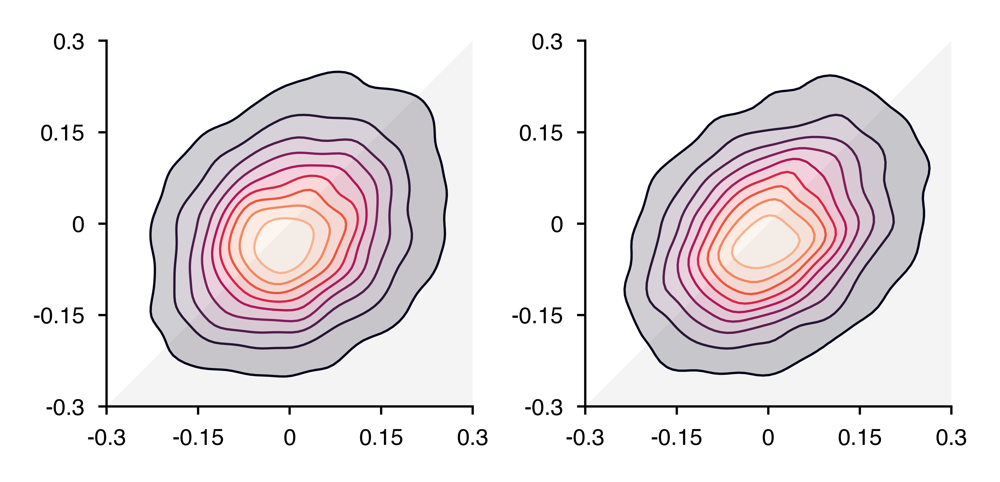

In [46]:
savefig = 1
overwrite = 0
figsize = (colws['2-1/2'], colws['2-1/2'] * 0.5)
dpi = 1200
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 12}
lw = 0.5
ticklength = 3
tickpad = 3
spine_lw = 0.5
spine_len = 1.8

fig, ax = plt.subplots(1, 2, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)


# cols = ['locked_mrl_z', 'locked_freq_ind_z']
# labs = ['Phase-locking strength (Z)', 'Phase-locking frequency (Hz)']
# rois = bilat_pl['unit_roi3'].tolist()
lims = [(-0.3, 0.3, [-.3, -0.15, 0, 0.15, 0.3]),
        (-0.3, 0.3, [-.3, -0.15, 0, 0.15, 0.3])]

ctrls = [['wrong_time1', 'wrong_time2'], ['wrong_gs1', 'wrong_gs2']]
for iax in range(len(ax)):
    _df = pwise_corrs.query("(ctrl=={})".format(ctrls[iax]))
    tval, pval = stats.ttest_1samp(_df['corr_diff'], popmean=0)
    print('{:.2f} ± {:.2f} (t({}) = {:.1f}, p = {})'.format(np.mean(_df['corr_hypo']), stats.sem(_df['corr_hypo']),
                                                            len(_df)-1, tval, pval))
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].set_aspect('equal')
    ax[iax].set_xlim(lims[iax][:2])
    ax[iax].set_ylim(lims[iax][:2])
#     ax[iax].hlines(0, ax[iax].get_xlim()[0], ax[iax].get_xlim()[1], lw=lw)
#     ax[iax].vlines(0, ax[iax].get_ylim()[0], ax[iax].get_ylim()[1], lw=lw)
    patch = patches.Polygon([(lims[iax][0], lims[iax][0]), (lims[iax][1], lims[iax][0]), (lims[iax][1], lims[iax][1])], 
                              linewidth=0, color='#999999', alpha=0.1, zorder=0)
    ax[iax].add_patch(patch)
    ax[iax] = sns.kdeplot(x='corr_hypo', y='corr_ctrl', data=_df,
                          clip=(_df[['corr_hypo', 'corr_ctrl']].min().min(),
                                _df[['corr_hypo', 'corr_ctrl']].max().max()),
                          ax=ax[iax], linewidths=lw, cmap='rocket',
                          shade=False, thresh=0.05, gridsize=100)
    ax[iax] = sns.kdeplot(x='corr_hypo', y='corr_ctrl', data=_df,
                          clip=(_df[['corr_hypo', 'corr_ctrl']].min().min(),
                                _df[['corr_hypo', 'corr_ctrl']].max().max()),
                          ax=ax[iax], cmap='rocket',
                          alpha=0.2, shade=True, thresh=0.05, gridsize=100)
    mean_point = [np.mean(_df['corr_hypo']), np.mean(_df['corr_ctrl'])]
#     ax[iax].annotate('+', mean_point, xycoords='data', fontsize=font['tick'])
    ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    ax[iax].set_xticks(lims[iax][2])
    ax[iax].set_xticklabels(lims[iax][2], fontsize=5)
    ax[iax].set_yticks(lims[iax][2])
    ax[iax].set_yticklabels(lims[iax][2], fontsize=5)
    ax[iax].set_xlabel('')
    ax[iax].set_ylabel('')
    
    
fig.tight_layout(w_pad=0.5)

if savefig:
    filename = op.join(proj_dir, 'figs', 'plot_trial_bounds', 'trial_bound_corr_kde_2plots.pdf')
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
    
fig.show()

In [88]:
trial_sum = pwise_corrs.drop_duplicates(['trial1', 'trial2'])[['trial1', 'trial2']].sum(axis=1).values
pwise_corrs.drop_duplicates(['trial1', 'trial2', 'cond'])

,trial1,trial2,cond,level,gstime1,gstime2,corr
0,1,2,Delay1_Encoding,hypo,1,2,0.144869
3,1,2,Delay2_Retrieval,hypo,9,10,0.002091
6,1,2,Encoding_Delay2,hypo,7,8,0.148151
9,1,2,Retrieval_Delay1,hypo,15,0,0.173591
12,1,3,Delay1_Encoding,hypo,1,2,0.105626
...,...,...,...,...,...,...,...
7545,34,36,Retrieval_Delay1,hypo,15,0,0.226101
7548,35,36,Delay1_Encoding,hypo,1,2,0.152359
7551,35,36,Delay2_Retrieval,hypo,9,10,0.297665
7554,35,36,Encoding_Delay2,hypo,7,8,0.042522


In [143]:
block_inds = {1: pwise_corrs.drop_duplicates(['trial1', 'trial2']).reset_index(drop=True).query("(trial1_block==1) & (trial2_block==1)").index.tolist(),
              2: pwise_corrs.drop_duplicates(['trial1', 'trial2']).reset_index(drop=True).query("(trial1_block==2) & (trial2_block==2)").index.tolist(),
              3: pwise_corrs.drop_duplicates(['trial1', 'trial2']).reset_index(drop=True).query("(trial1_block==3) & (trial2_block==3)").index.tolist()}

In [151]:
for iax, k in enumerate(pwise_diffs.keys()):
    df = pd.DataFrame(np.concatenate((np.vstack(([1] * len(block_inds[1]), pwise_diffs[k][block_inds[1]])).T,
                                      np.vstack(([2] * len(block_inds[2]), pwise_diffs[k][block_inds[2]])).T,
                                      np.vstack(([3] * len(block_inds[3]), pwise_diffs[k][block_inds[3]])).T))
                      columns=['block', 'corr_diff'])
    
    

(198, 2)

In [164]:
font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}

plt.close()
fig, ax = plt.subplots(2, 4, figsize=(12, 8), dpi=1200)
ax = np.ravel(ax)

iax = 0
for iax, k in enumerate(pwise_diffs.keys()):
    df = pd.DataFrame(np.concatenate((np.vstack(([1] * len(block_inds[1]), pwise_diffs[k][block_inds[1]])).T,
                                      np.vstack(([2] * len(block_inds[2]), pwise_diffs[k][block_inds[2]])).T,
                                      np.vstack(([3] * len(block_inds[3]), pwise_diffs[k][block_inds[3]])).T)),
                      columns=['block', 'corr_diff'])
    ax[iax] = sns.boxplot(x='block', y='corr_diff', data=df, ax=ax[iax],
                          color='#296eb4', showfliers=False, saturation=1)
    ax[iax].set_title('{}: {}'.format(k[0], k[1]), fontsize=font['fig'])
# ax[iax] = sns.regplot(x=trial_sum[0::3], y=pwise_diffs['wrong_gs'][0::3], ax=ax[iax])

fig.tight_layout()
fig.show()

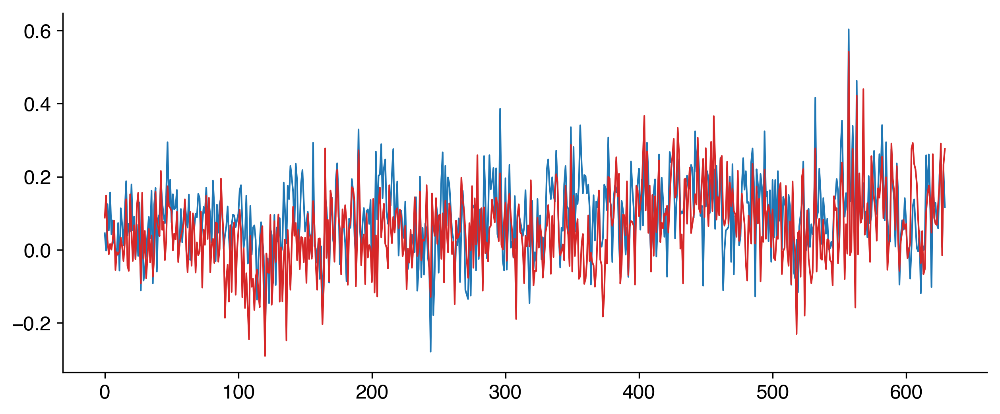

In [81]:
plt.plot(pwise_diffs['wrong_time'])
plt.plot(pwise_diffs['wrong_gs'])

In [153]:
levels = ['hypo', 'wrong_time', 'wrong_gs']
qry = "(cond=='{}') & (level=='{}')"
pwise_diffs = od([])
for cond in time_pairs:
    for level in ['wrong_time', 'wrong_gs']:
        pwise_diffs[(cond, level)] = (pwise_corrs.query(qry.format(cond, 'hypo'))['corr'].values - pwise_corrs.query(qry.format(cond, level))['corr'].values)

In [179]:
pwise_corrs

,trial1,trial2,trial1_block,trial2_block,within_block,cond,ctrl,gstime1_hypo,gstime2_hypo,gstime1_ctrl,gstime2_ctrl,corr_hypo,corr_ctrl,corr_diff
0,1,2,1,1,1,Delay1_Encoding,wrong_time1,1,2,0,2,0.144869,0.104725,0.040144
1,1,2,1,1,1,Delay1_Encoding,wrong_time2,1,2,1,7,0.144869,0.078654,0.066215
2,1,2,1,1,1,Delay1_Encoding,wrong_gs1,1,2,9,2,0.144869,-0.002542,0.147411
3,1,2,1,1,1,Delay1_Encoding,wrong_gs2,1,2,1,10,0.144869,-0.030127,0.174995
4,1,2,1,1,1,Delay2_Retrieval,wrong_time1,9,10,8,10,0.002091,0.083943,-0.081852
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10075,35,36,3,3,1,Encoding_Delay2,wrong_gs2,7,8,7,0,0.042522,-0.102435,0.144957
10076,35,36,3,3,1,Retrieval_Delay1,wrong_time1,15,0,10,0,0.173651,0.057504,0.116148
10077,35,36,3,3,1,Retrieval_Delay1,wrong_time2,15,0,15,1,0.173651,0.235854,-0.062203
10078,35,36,3,3,1,Retrieval_Delay1,wrong_gs1,15,0,7,0,0.173651,-0.102435,0.276086


In [25]:
def mean_sem(v):
    return '{:.2f} ± {:.4f}'.format(np.mean(v), stats.sem(v))

conds = pwise_corrs['cond'].unique().tolist()
ctrls = pwise_corrs['ctrl'].unique().tolist()
qry = "(cond=='{}') & (ctrl=='{}')"
for cond in conds:
    print(cond, '-' * len(cond), sep='\n')
    corrs = {ctrl:pwise_corrs.query(qry.format(cond, ctrl))['corr_diff'].values for ctrl in ctrls}
    for ctrl in ctrls:
        print('{}: {}, {}'.format(ctrl, mean_sem(corrs[ctrl]), stats.ttest_1samp(corrs[ctrl], 0)))
    print('')

Delay1_Encoding
---------------
wrong_time1: 0.02 ± 0.0047, Ttest_1sampResult(statistic=4.428346103686458, pvalue=1.1197228329226406e-05)
wrong_time2: 0.02 ± 0.0047, Ttest_1sampResult(statistic=3.5030984813193555, pvalue=0.0004924914487696446)
wrong_gs1: 0.03 ± 0.0046, Ttest_1sampResult(statistic=6.7732137639653685, pvalue=2.8965782415872717e-11)
wrong_gs2: 0.02 ± 0.0045, Ttest_1sampResult(statistic=4.964399221798699, pvalue=8.88600122425339e-07)

Encoding_Delay2
---------------
wrong_time1: 0.02 ± 0.0047, Ttest_1sampResult(statistic=4.611174563716696, pvalue=4.851921507731456e-06)
wrong_time2: 0.01 ± 0.0045, Ttest_1sampResult(statistic=2.855764221550847, pvalue=0.004434983287262735)
wrong_gs1: 0.00 ± 0.0044, Ttest_1sampResult(statistic=0.910587765684807, pvalue=0.3628614316289347)
wrong_gs2: 0.02 ± 0.0046, Ttest_1sampResult(statistic=3.5954795218923814, pvalue=0.0003491727461096136)

Delay2_Retrieval
----------------
wrong_time1: 0.01 ± 0.0047, Ttest_1sampResult(statistic=1.5082983080

In [29]:
def mean_sem(v):
    return '{:.2f} ± {:.4f}'.format(np.mean(v), stats.sem(v))

conds = pwise_corrs['cond'].unique().tolist()
ctrls = pwise_corrs['ctrl'].unique().tolist()
qry = "(cond=='{}') & (ctrl=='{}')"
for cond in conds:
    print(cond, '-' * len(cond), sep='\n')
    corrs = {ctrl:pwise_corrs.query(qry.format(cond, ctrl))['corr_diff'].values for ctrl in ctrls}
    for ctrl in ctrls:
        print('{}: {}, {}'.format(ctrl, mean_sem(corrs[ctrl]), stats.ttest_1samp(corrs[ctrl], 0)))
    print('')

Delay1_Encoding
---------------
wrong_time1: 0.03 ± 0.0042, Ttest_1sampResult(statistic=6.727056793837246, pvalue=3.896800019814219e-11)
wrong_time2: 0.02 ± 0.0050, Ttest_1sampResult(statistic=4.1562962796120875, pvalue=3.682630276062802e-05)
wrong_gs1: 0.03 ± 0.0045, Ttest_1sampResult(statistic=6.153952287657066, pvalue=1.3458309593625389e-09)
wrong_gs2: 0.04 ± 0.0047, Ttest_1sampResult(statistic=8.17852317038271, pvalue=1.5912737397675348e-15)

Encoding_Delay2
---------------
wrong_time1: 0.04 ± 0.0048, Ttest_1sampResult(statistic=9.296075437593455, pvalue=2.362040688223865e-19)
wrong_time2: 0.01 ± 0.0044, Ttest_1sampResult(statistic=1.98959603943057, pvalue=0.04706804367811594)
wrong_gs1: 0.00 ± 0.0046, Ttest_1sampResult(statistic=0.3671177280783657, pvalue=0.7136546799935821)
wrong_gs2: 0.02 ± 0.0044, Ttest_1sampResult(statistic=4.075482615954452, pvalue=5.180060752988689e-05)

Delay2_Retrieval
----------------
wrong_time1: 0.01 ± 0.0043, Ttest_1sampResult(statistic=3.4453005984791

In [15]:
def mean_sem(v):
    return '{:.4f} ± {:.4f}'.format(np.mean(v), stats.sem(v))

conds = pwise_corrs['cond'].unique().tolist()
ctrls = pwise_corrs['ctrl'].unique().tolist()
qry = "(cond=='{}') & (ctrl=='{}')"
for cond in conds:
    print(cond, '-' * len(cond), sep='\n')
    corrs = {ctrl:pwise_corrs.query(qry.format(cond, ctrl))['corr_diff'].values for ctrl in ctrls}
    for ctrl in ctrls:
        print('{}: {}, {}'.format(ctrl, mean_sem(corrs[ctrl]), stats.ttest_1samp(corrs[ctrl], 0)))
    print('')

Delay1_Encoding
---------------
wrong_time1: 0.0283 ± 0.0042, Ttest_1sampResult(statistic=6.727056793837246, pvalue=3.896800019814219e-11)
wrong_time2: 0.0207 ± 0.0050, Ttest_1sampResult(statistic=4.1562962796120875, pvalue=3.682630276062802e-05)
wrong_gs1: 0.0274 ± 0.0045, Ttest_1sampResult(statistic=6.153952287657066, pvalue=1.3458309593625389e-09)
wrong_gs2: 0.0384 ± 0.0047, Ttest_1sampResult(statistic=8.17852317038271, pvalue=1.5912737397675348e-15)

Encoding_Delay2
---------------
wrong_time1: 0.0446 ± 0.0048, Ttest_1sampResult(statistic=9.296075437593455, pvalue=2.362040688223865e-19)
wrong_time2: 0.0087 ± 0.0044, Ttest_1sampResult(statistic=1.98959603943057, pvalue=0.04706804367811594)
wrong_gs1: 0.0017 ± 0.0046, Ttest_1sampResult(statistic=0.3671177280783657, pvalue=0.7136546799935821)
wrong_gs2: 0.0180 ± 0.0044, Ttest_1sampResult(statistic=4.075482615954452, pvalue=5.180060752988689e-05)

Delay2_Retrieval
----------------
wrong_time1: 0.0147 ± 0.0043, Ttest_1sampResult(statist

In [32]:
pwise_corrs.groupby('cond')['corr_hypo'].mean()

cond
Delay1_Encoding     0.004776
Delay2_Retrieval   -0.023637
Encoding_Delay2     0.007296
Retrieval_Delay1    0.039018
Name: corr_hypo, dtype: float64

In [14]:
savefig = 0
overwrite = 1
figsize = (10, 4)
dpi = 1200

# ------------------
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.boxplot(x='cond', y='corr_diff', hue='ctrl', data=pwise_corrs, ax=ax[iax],
                      showfliers=False, palette='rocket', saturation=1)
ax[iax].axhline(0, ax[iax].get_xlim()[0], ax[iax].get_xlim()[1], color='k', linewidth=0.8, linestyle='--', zorder=0)
ax[iax].set_xlabel('')
ax[iax].set_ylabel('$r_{diff}$')
legend = ax[iax].legend()
legend.set(bbox_to_anchor=(1.25, 1))

if savefig:
    all_time_cells = ols_pairs.query("(testvar=='time') & (sig==True) & (beta_abs_max>0)")['subj_sess_unit'].unique().tolist()
    filename = op.join(proj_dir, 'figs', 'plot_trial_bounds', 
                       'time_cell_pattern_similarity-trial_interval_bounds-{}ms_bins-{}time_cells-{}units.pdf'.format(time_step_size, len(all_time_cells), pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

In [33]:
savefig = 0
overwrite = 1
figsize = (10, 4)
dpi = 1200

# ------------------
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.boxplot(x='cond', y='corr_diff', hue='ctrl', data=pwise_corrs, ax=ax[iax],
                      showfliers=False, palette='rocket', saturation=1)
ax[iax].axhline(0, ax[iax].get_xlim()[0], ax[iax].get_xlim()[1], color='k', linewidth=0.8, linestyle='--', zorder=0)
ax[iax].set_xlabel('')
ax[iax].set_ylabel('Repr. sim. difference')
legend = ax[iax].legend()
legend.set(bbox_to_anchor=(1.25, 1))

if savefig:
    filename = op.join(proj_dir, 'figs', 'plot_remapping', 
                       'time_cell_pattern_similarity-trial_interval_bounds-{}ms_bins-{}time_cells-{}units.pdf'.format(time_step_size, len(all_time_cells), pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

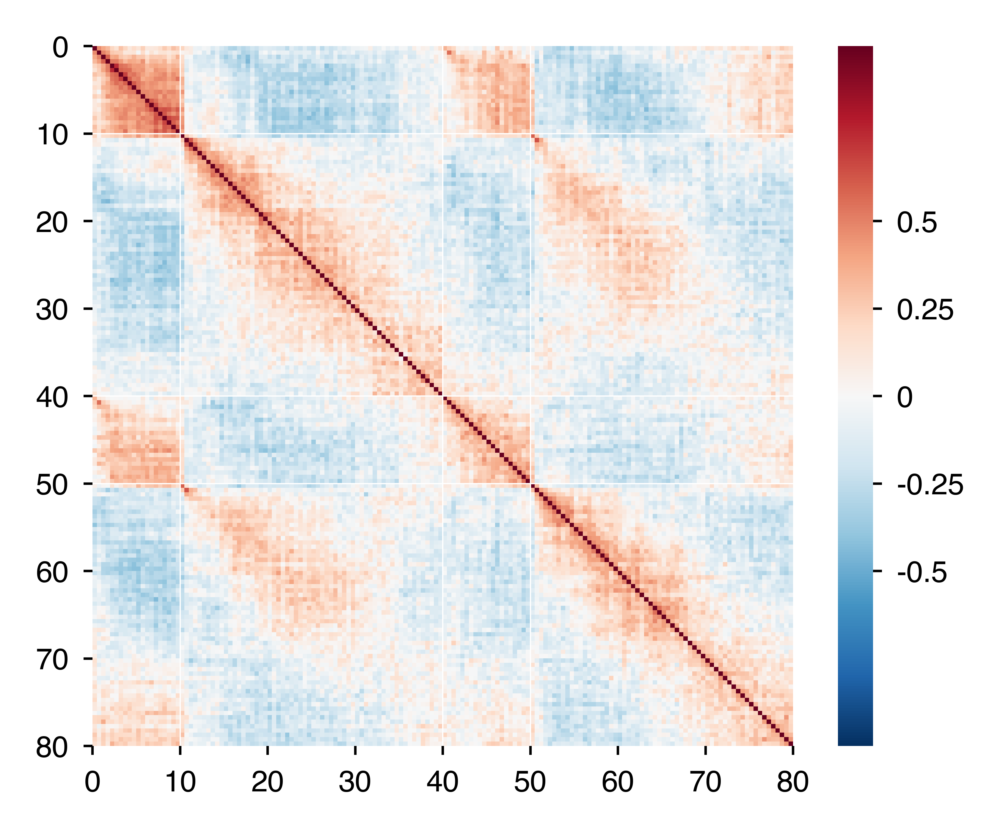

In [40]:
savefig = 0
overwrite = 0
time_step_size = 500
place_adj = False
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.5, -0.25, 0, 0.25, 0.5]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
all_time_cells = ols_pairs.query("(testvar=='time') & (sig==True) & (beta_abs_max>0)")['subj_sess_unit'].unique().tolist()
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)
_pop_spikes = pop_spikes.combine_time_bins(pop_spikes.pop_spikes, time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[all_time_cells].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[all_time_cells].sum(), axis=0) # time_step x neuron
zfrs = stats.zscore(_pop_spikes.groupby('iGameStateTime')[all_time_cells].sum(), axis=0)
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
# cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
#                          stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
cmat = cosine_similarity(stats.zscore(zfrs, axis=1),
                         stats.zscore(zfrs, axis=1)) # time_step x time_step; pearson corrs
vmax = np.max(np.abs((cmat.min(), cmat.max())))
vmin = -vmax

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square, cmap='RdBu_r')
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers',
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-redBlue-{}time_cells-{}units.pdf'.format(time_step_size, len(all_time_cells), pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

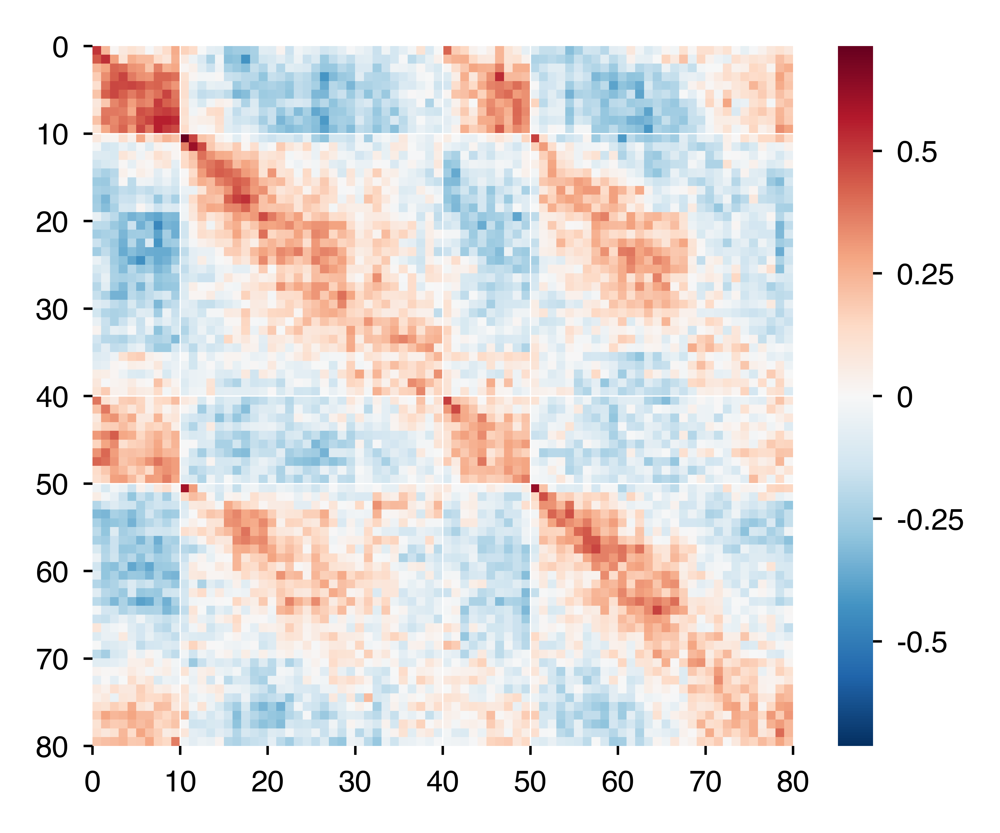

In [38]:
savefig = 0
overwrite = 0
time_step_size = 1000
place_adj = False
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.5, -0.25, 0, 0.25, 0.5]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
all_time_cells = ols_pairs.query("(testvar=='time') & (sig==True) & (beta_abs_max>0)")['subj_sess_unit'].unique().tolist()
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[all_time_cells].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[all_time_cells].sum(), axis=0) # time_step x neuron
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
                         stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
vmax = np.max(np.abs((cmat.min(), cmat.max())))
vmin = -vmax

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square, cmap='RdBu_r')
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers',
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-redBlue-{}time_cells-{}units.pdf'.format(time_step_size, len(all_time_cells), pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

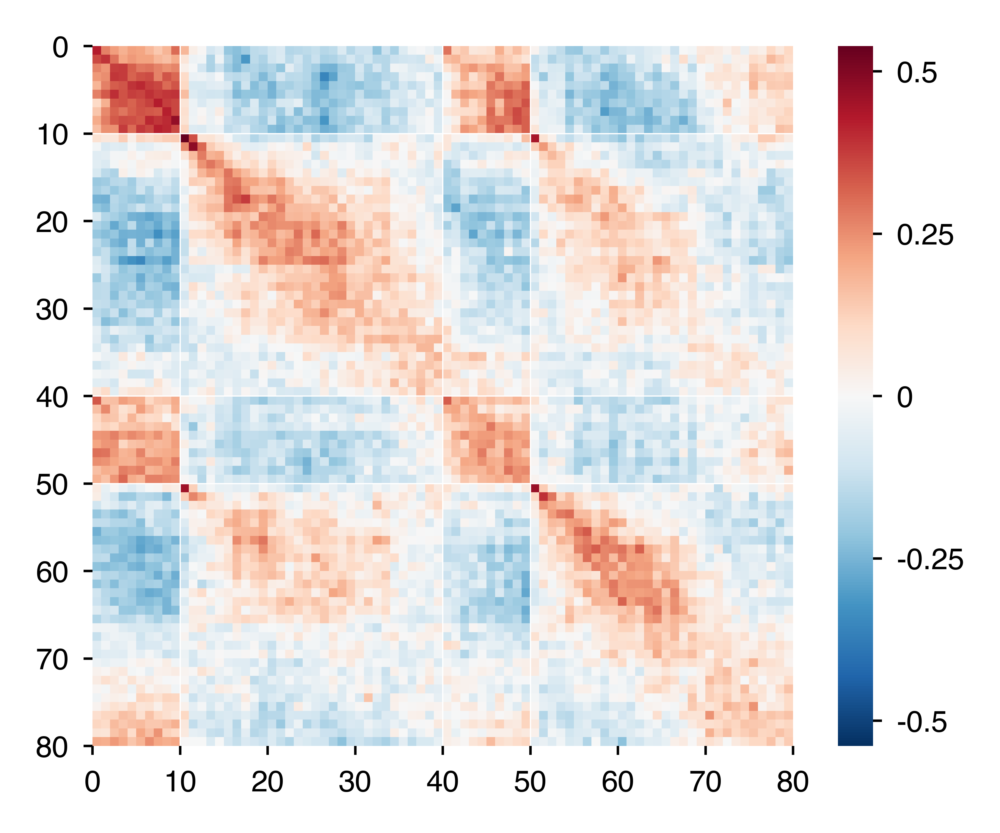

In [74]:
savefig = 0
overwrite = 0
time_step_size = 1000
place_adj = False
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.5, -0.25, 0, 0.25, 0.5]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
                         stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
vmax = np.max(np.abs((cmat.min(), cmat.max())))
vmin = -vmax

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square, cmap='RdBu_r')
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-redBlue-{}units.pdf'.format(time_step_size, pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

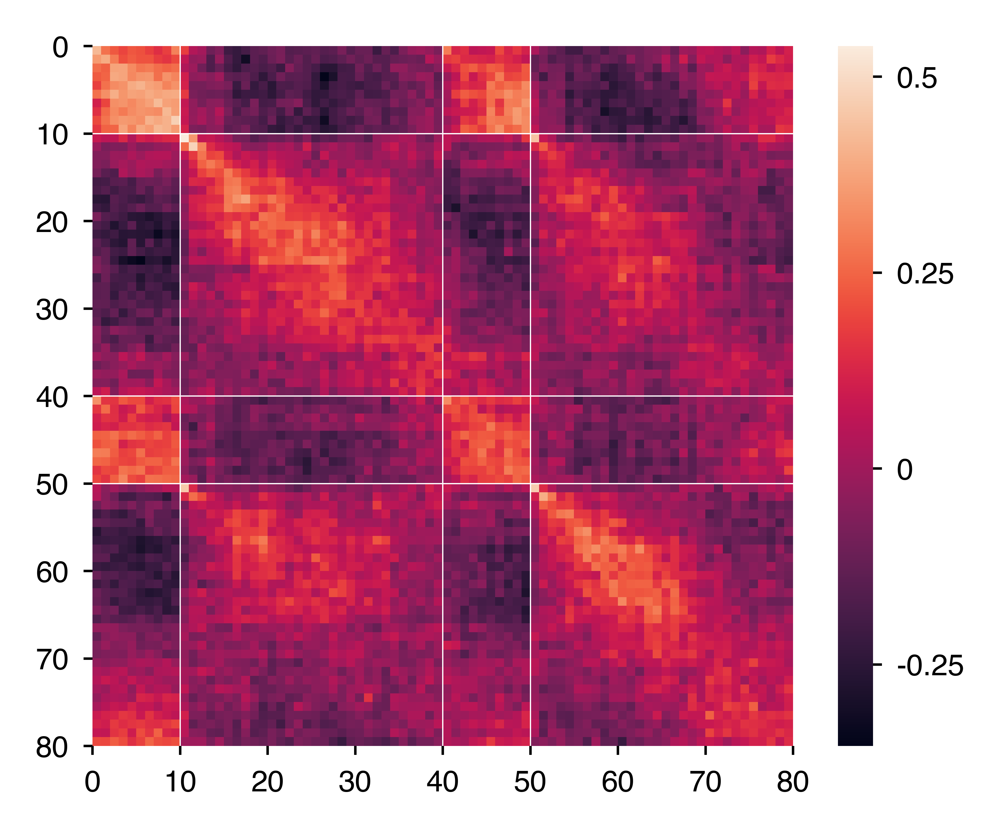

In [75]:
savefig = 0
overwrite = 0
time_step_size = 1000
place_adj = False
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.25, 0, 0.25, 0.5]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
                         stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
vmin = cmat.min()
vmax = cmat.max()

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square)
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-{}units.pdf'.format(time_step_size, pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

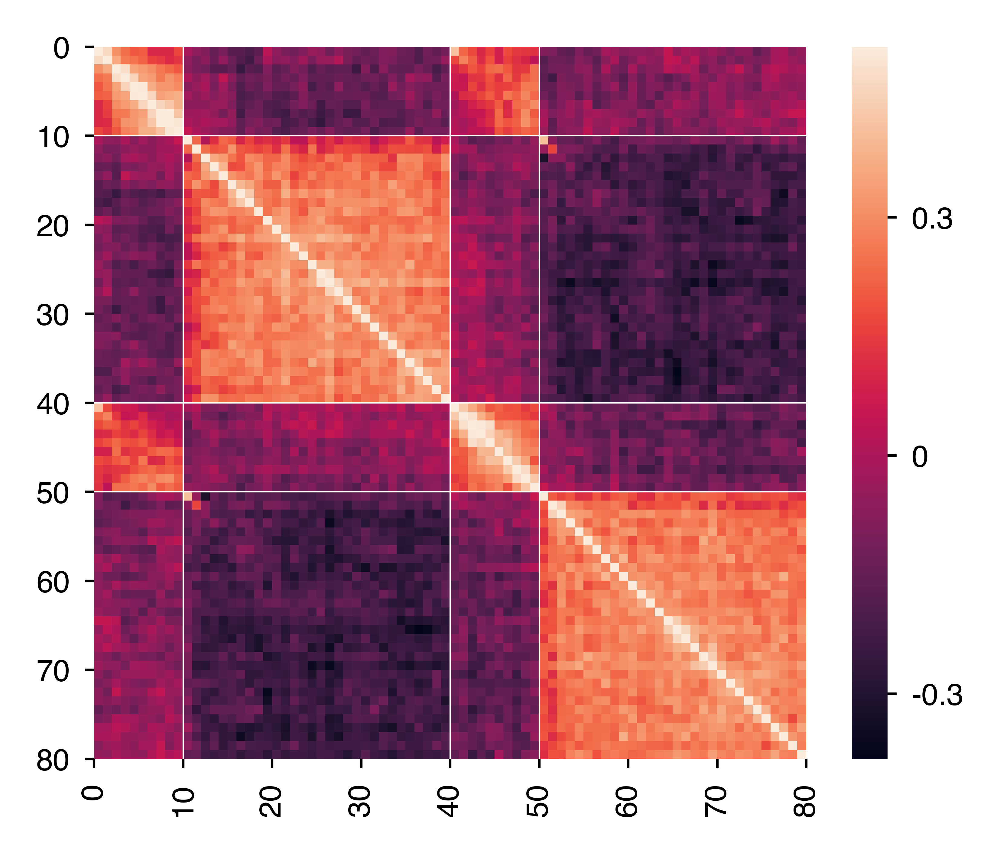

In [76]:
savefig = 0
overwrite = 0
time_step_size = 1000
place_adj = True
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(vlines[0], vlines[-1]+1, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.3, 0, 0.3, 0.6]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
_pop_spikes = pop_spikes.combine_time_bins(time_step_size=time_step_size)
zfrs = stats.zscore(_pop_spikes.groupby(['iGameStateTime'])[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
#cmat = cosine_similarity(zfrs) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs, axis=1)) # time_step x time_step; pearson corrs
vmin = cmat.min()
vmax = np.tril(cmat, -1).max()

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square)
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'pearson_corrs_between_{}ms_time_step_pairs-place_adj-{}units.pdf'.format(time_step_size, pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

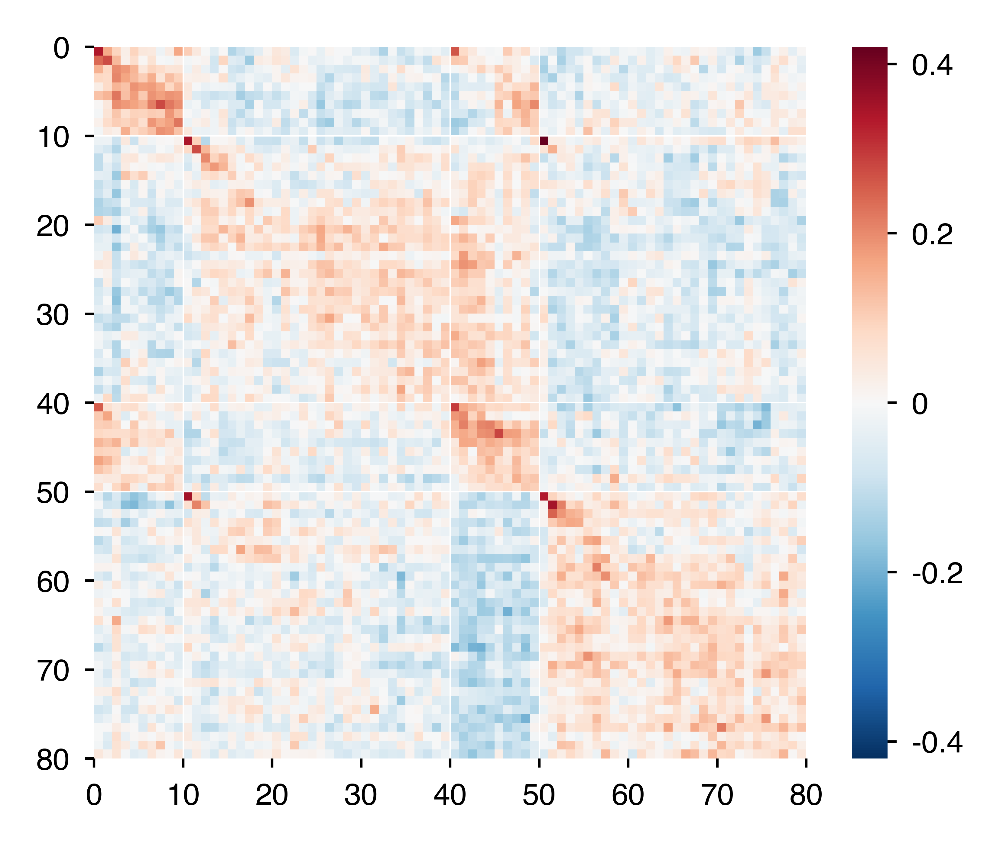

In [77]:
savefig = 0
overwrite = 0
place_adj = True
time_step_size = 1000
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.4, -0.2, 0, 0.2, 0.4]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)
# pop_spikes_all = pop_spikes.combine_time_bins(pop_spikes.pop_spikes, time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# zfrs = stats.zscore(pop_spikes_all.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
                         stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
# cmat = cosine_similarity(stats.zscore(zfrs, axis=1))
vmax = np.max(np.abs((cmat.min(), cmat.max())))
# vmax = np.max(np.abs((cmat.min(), np.tril(cmat, -1).max())))
vmin = -vmax

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square, cmap='RdBu_r')
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-place_adj-redBlue-{}units.pdf'.format(time_step_size, pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

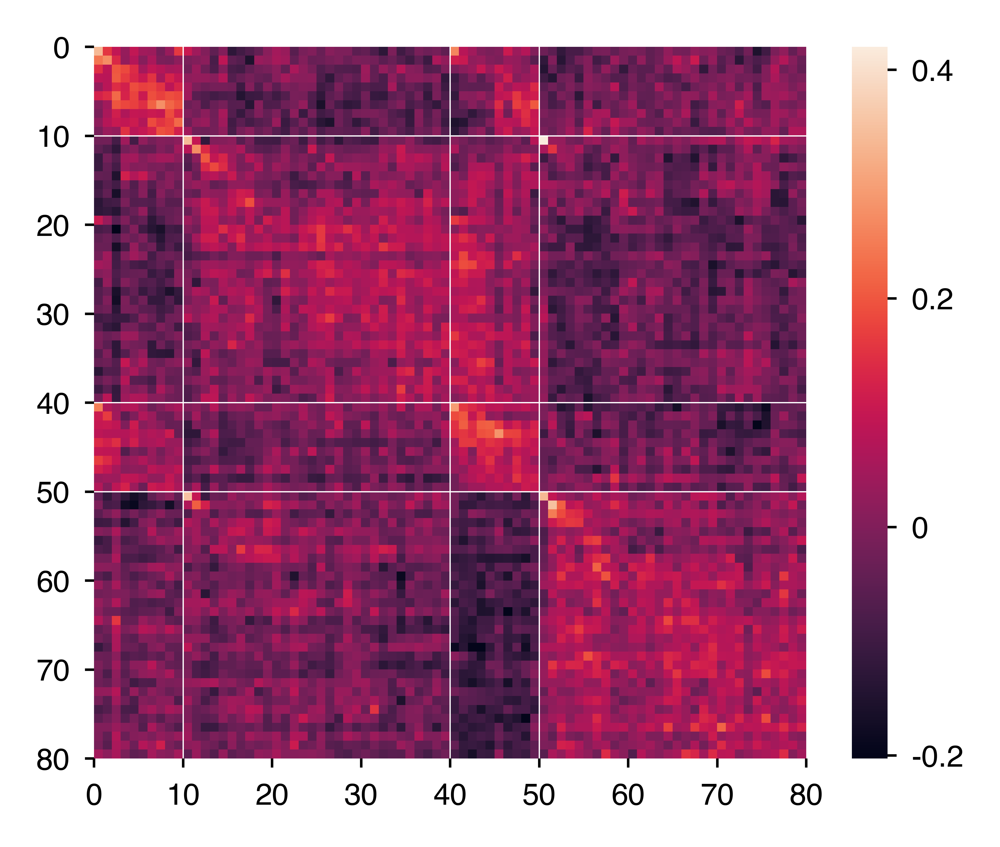

In [78]:
savefig = 0
overwrite = 0
place_adj = True
time_step_size = 1000
figsize = (3.25, 2.6)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
vlines = np.array([0, 10, 40, 50, 80]) * (1000/time_step_size)
square = True
xticks = np.arange(vlines[0], vlines[-1]+1, step=int(10 * (1000/time_step_size)), dtype=int)
xticklabels = np.arange(0, 81, step=10, dtype=int)
add_cbar = 1
cbar_ticks = [-0.4, -0.2, 0, 0.2, 0.4]
ticklength = 3
tickpad = 3
xlinewidth = 0.25
spine_lw = 0.5
spine_len = 1.8

# Z-score each neuron's firing across time steps, then calculate the Pearson correlation
# between population firing rates in each pair of time steps.
pop_spikes = pop_decoding.load_pop_spikes(place_adj=place_adj)
if 'is_odd' not in pop_spikes.pop_spikes.columns:
    pop_spikes.pop_spikes.insert(1, 'is_odd', (pop_spikes.pop_spikes['trial']%2==1).astype(int))
pop_spikes_odd = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd==1)"), time_step_size)
pop_spikes_even = pop_spikes.combine_time_bins(pop_spikes.pop_spikes.query("(is_odd!=1)"), time_step_size)
# pop_spikes_all = pop_spikes.combine_time_bins(pop_spikes.pop_spikes, time_step_size)

zfrs_train = stats.zscore(pop_spikes_odd.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
zfrs_test = stats.zscore(pop_spikes_even.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# zfrs = stats.zscore(pop_spikes_all.groupby('iGameStateTime')[pop_spikes.neurons].sum(), axis=0) # time_step x neuron
# cmat = cosine_similarity(zfrs_train, zfrs_test) # time_step x time_step; cosine sims
cmat = cosine_similarity(stats.zscore(zfrs_train, axis=1),
                         stats.zscore(zfrs_test, axis=1)) # time_step x time_step; pearson corrs
# cmat = cosine_similarity(stats.zscore(zfrs, axis=1))
vmax = cmat.max()
vmin = cmat.min()

# Plot the results.
plt.close()
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

iax = 0
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, ax=ax[iax], square=square)
ax[iax].hlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, vlines[-1], colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
    
if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'pearson_corrs_between_{}ms_time_step_pairs-odd_even_split-place_adj-{}units.pdf'.format(time_step_size, pop_spikes.neurons.size))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

In [6]:
def null_shift(pop_spikes,
                y_col='time_step',
                shift_over='trial'):
    """Return a null column of circ-shifted values.
    
    Parameters
    ----------
    shift_over : str
        'trial' to circ-shift y values within each trial.
        'gameState' to circ-shift y values within each trial x game state.
    """
    # Null distribution:
    #
    # Construct a null distribution by circ-shifting y_col values within each trial
    # to randomize y_col ~ pop_spiking associations across trials.
    shuf_idx = np.concatenate(pop_spikes.reset_index()
                                        .groupby('trial')['index']
                                        .apply(lambda x: np.roll(x, np.random.randint(0, len(x))))
                                        .tolist())
    y_col_null = '{}_null'.format(y_col)
    pop_spikes.insert(pop_spikes.columns.tolist().index(y_col)+1, y_col_null, pop_spikes.loc[shuf_idx, y_col].values)

# LDA

In [6]:
def train_lda(unit_groups=None,
              n_subset_units=None,
              unit_group_n_perm=1,
              game_states=['Delay1', 'Encoding', 'Delay2', 'Retrieval'],
              time_step_size=10000,
              proj_dir='/home1/dscho/projects/time_cells',
              save_results=True,
              overwrite=True,
              verbose=True):
    """Train 2-component LDA on held-out single trials.
    
    Returns
    -------
    lda_results : dataframe
    """
    def _get_game_state_time(pop_spikes,
                             neurons,
                             game_states=['Delay1', 'Encoding', 'Delay2', 'Retrieval'],
                             time_step_size=10000):
        # Select a subset of pop_spikes rows.
        _pop_spikes = pop_spikes.query("(gameState=={})".format(game_states)).reset_index(drop=True).copy()

        # Add a column for game state order.
        igame_states = {game_state:idx for (idx, game_state) in enumerate(game_states)}
        _pop_spikes.insert(2, 'iGameState', _pop_spikes['gameState'].apply(lambda x: igame_states[x]).astype(int))

        # Add a column for time step.
        time_bin_size = 500
        bins_per_step = int(time_step_size / time_bin_size)
        _pop_spikes.insert(3, 'time_step', _pop_spikes['time_bin'].apply(lambda x: int(x/bins_per_step)))

        # For each unit, sum spikes within each time step.
        _pop_spikes = _pop_spikes.groupby(['trial', 'gameState', 'iGameState', 'time_step'], observed=True)[neurons].sum().reset_index()

        # Add a column combining game state and time step.
        _pop_spikes.insert(4, 'gameStateTime', _pop_spikes.apply(lambda x: '{}_{:0>2}'.format(int(x['iGameState']), int(x['time_step'])), axis=1).astype(str))
        i_game_state_times = {gst: igst for (igst, gst) in enumerate(np.unique(_pop_spikes['gameStateTime']))}
        _pop_spikes.insert(5, 'iGameStateTime', _pop_spikes['gameStateTime'].apply(lambda x: i_game_state_times[x]).astype(int))

        return _pop_spikes

    def _setup_lda():
        """Setup the processing pipeline for classification.

        Steps
        -----
        1. Impute missing data by replacing NaNs with their column-wise median
        2. Z-score the values in each column
        3. Train an LDA classifier to transform data into 2 components
        """
        pipe = Pipeline(steps=[('impute', SimpleImputer(strategy='median')),
                               ('scale', StandardScaler()),
                               ('lda', LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto', n_components=2))])
        return pipe

    start_time = time()

    # Define hard-coded parameters.
    y_col = 'iGameStateTime'

    # Load the pop_spikes dataframe (spike counts for units across all subject
    # sessions within each trial, game state, and time bin).
    pop_spikes = pop_decoding.load_pop_spikes()
    neurons = pop_spikes.neurons
    pop_spikes = _get_game_state_time(pop_spikes.pop_spikes,
                                      neurons,
                                      game_states=game_states,
                                      time_step_size=time_step_size)
    trials = pop_spikes['trial'].unique()
    n_trials = trials.size

    # Null distribution:
    #
    # Construct a null distribution by circ-shifting y_col values within each trial
    # to randomize y_col ~ pop_spiking associations across trials.
    shuf_idx = np.concatenate(pop_spikes.reset_index()
                                        .groupby('trial')['index']
                                        .apply(lambda x: np.roll(x, np.random.randint(0, len(x))))
                                        .tolist())
    y_col_null = '{}_null'.format(y_col)
    pop_spikes.insert(pop_spikes.columns.tolist().index(y_col)+1, y_col_null, pop_spikes.loc[shuf_idx, y_col].values)

    # Setup groups of units to train classifiers on, and check that
    # all units in unit_groups are columns in pop_spikes.
    if unit_groups is None:
        unit_groups = od([('all', neurons)])

    for unit_group in unit_groups:
        _neurons = unit_groups[unit_group]
        if not np.all(np.isin(_neurons, neurons)):
            raise ValueError('Some unit names in {} are not in pop_spikes.columns'
                             .format(unit_group))

    # If more than one unit group is being processed, find the group with
    # the fewest number of neurons and assign this number to n_subset_units.
    if len(unit_groups) > 1:
        n_subset_units = np.min([len(_neurons) for _neurons in unit_groups.values()])

    # Determine how many times to loop over classifier fitting.
    if n_subset_units is None:
        unit_group_n_perm = 1

    # Split trials into train and test sets.
    kfold_outer = n_trials
    train_test = pop_decoding.split_trials(trials, n_splits=kfold_outer)

    # Get the output filename and return its contents
    # if filename exists and overwrite is False.
    basename = 'LDA_predicting_{}'.format(y_col)
    basename += '-' + '-'.join(['{}units_{}'.format(len(unit_groups[unit_group]), unit_group) for unit_group in unit_groups])
    basename += '-{}fold'.format(kfold_outer)
    basename += '-{}units_per_subset'.format(n_subset_units) if (n_subset_units is not None) else ''
    basename += '-{}perms_per_unit_group'.format(unit_group_n_perm) if (n_subset_units is not None) else ''
    basename += '-{}s_time_steps'.format(time_step_size)
    basename += '-' + '_'.join([game_state for game_state in game_states])
    basename += '.pkl'
    filename = op.join(proj_dir, 'analysis', 'classifiers', basename)
    if op.exists(filename) and not overwrite:
        lda_results = dio.open_pickle(filename)
        return lda_results

    # Train classifiers to predict time from population neural activity.
    lda_results = []
    for unit_group in unit_groups:
        # Select neurons in the unit group.
        _neurons = unit_groups[unit_group]

        # Determine how many times to loop over classifier fitting for each game state.
        if n_subset_units is not None:
            if len(_neurons) > n_subset_units:
                n_loops = unit_group_n_perm
            else:
                n_loops = 1
        else:
            n_loops = 1

        # Classify.
        for iLoop in range(n_loops):
            # Randomly select n_subset_units from neurons in the unit group.
            if n_subset_units is not None:
                if len(_neurons) > n_subset_units:
                    __neurons = np.random.permutation(_neurons).tolist()[:n_subset_units]
                else:
                    __neurons = _neurons
            else:
                __neurons = _neurons

            if verbose:
                print('{}, loop {}, fitting {} neurons: {:.1f} min'.format(unit_group, iLoop, len(__neurons), (time() - start_time) / 60))

            # Perform nested cross-validation, splitting trials into
            # test and nested train/val sets.
            for iFold in range(kfold_outer):
                # Select the test and trainval trials.
                train, test = train_test[iFold]

                # ---------------------------------
                # Observed data

                # Select the training and test data.
                train_idx = pop_spikes.loc[np.isin(pop_spikes['trial'], train)].index.tolist()
                test_idx = pop_spikes.loc[np.isin(pop_spikes['trial'], test)].index.tolist()
                X_train = pop_spikes.loc[train_idx, __neurons].values.copy()
                y_train = pop_spikes.loc[train_idx, y_col].values.copy()
                X_test = pop_spikes.loc[test_idx, __neurons].values.copy()
                y_test = pop_spikes.loc[test_idx, y_col].values.copy()

                # Setup grid search on the inner CV.
                lda = _setup_lda()

                # Train the classifier.
                lda.fit(X_train, y_train)

                # Transform the held-out data.
                X_test_tfm = lda.transform(X_test) # time_step x lda_component

                # ---------------------------------
                # Null distribution

                # Select the training and test data.
                y_train_null = pop_spikes.loc[train_idx, y_col_null].values.copy()
                y_test_null = pop_spikes.loc[test_idx, y_col_null].values.copy()

                # Setup grid search on the inner CV.
                lda_null = _setup_lda()

                # Train the classifier.
                lda_null.fit(X_train, y_train_null)

                # Transform the held-out data.
                X_test_tfm_null = lda_null.transform(X_test) # time_step x lda_component

                for ii in range(X_test_tfm.shape[0]):
                    lda_results.append([test[0],
                                        y_test[ii],
                                        X_test_tfm[ii, 0],
                                        X_test_tfm[ii, 1],
                                        y_test_null[ii],
                                        X_test_tfm_null[ii, 0],
                                        X_test_tfm_null[ii, 1],])

    cols = ['trial',
            'y_test',
            'c1',
            'c2',
            'y_test_null',
            'c1_null',
            'c2_null']
    lda_results = pd.DataFrame(lda_results, columns=cols)
    
    if save_results:
        dio.save_pickle(lda_results, filename, verbose=verbose)
    
    if verbose:
        print('Done in {:.1f} min'.format((time() - start_time) / 60))
        
    return lda_results

In [7]:
def plot_lda2(lda_results,
              plot_type=None,
              _cmap=None,
              **kws):
    """Plot LDA results.
    
    Parameters
    ----------
    plot_type : str
        'points' to just plot the transforms for each trial x time step;
        'centroids' to just plot the centroids of these transforms across trials.
    """
    # Min-max scale columns.
    _lda_results = lda_results.copy()
    _lda_results[['c1', 'c2', 'c1_null', 'c2_null']] = minmax_scale(_lda_results[['c1', 'c2', 'c1_null', 'c2_null']].values, axis=0)
        
    # Get centroids for each time window.
    centroids = od([('obs', _lda_results.groupby(['y_test'])[['c1', 'c2']].apply(np.mean).reset_index()),
                    ('null', _lda_results.groupby(['y_test_null'])[['c1_null', 'c2_null']].apply(np.mean).reset_index())])

    # Plot params.
    colws = od([('1', 6.55),
                ('2-1/2', 3.2),
                ('2-1/3', 2.108),
                ('2-2/3', 4.292),
                ('3', 2.083),
                ('4', 1.525),
                ('5', 1.19),
                ('6', 0.967),
                (1, 2.05),
                (2, 3.125),
                (3, 6.45)])
    figsize = kws.pop('figsize', (colws['2-1/2'], colws['2-1/2'] * 0.5))
    dpi = kws.pop('dpi', 600)
    font = kws.pop('font', {'tick': 6, 'label': 7, 'annot': 6, 'fig': 9})
    size_points = kws.pop('size_points', 36)
    size_stars = kws.pop('size_stars', 108)
    alpha_points = kws.pop('alpha_points', 0.8)
    alpha_stars = kws.pop('alpha_stars', 1)
    point_lw = kws.pop('point_lw', 0)
    star_lw = kws.pop('point_lw', 0.5)
    ax_linewidth = kws.pop('ax_linewidth', 0.5)
    ticklength = kws.pop('ticklength', 2)
    tickpad = kws.pop('tickpad', 1)
    show_legend = kws.pop('show_legend', False)
    bbox_to_anchor = kws.pop('bbox_to_anchor', [1.8, 1])
    if _cmap is None:
        n_cats = np.unique(_lda_results['y_test']).size
        if n_cats == 8:
            _cmap = [sns.color_palette('Blues')[4],
                     sns.color_palette('Reds')[5],
                     sns.color_palette('Reds')[3],
                     sns.color_palette('Reds')[1],
                     sns.color_palette('Greens')[4],
                     sns.color_palette('Purples')[5],
                     sns.color_palette('Purples')[3],
                     sns.color_palette('Purples')[1]]
        elif n_cats == 16:
            _cmap = [sns.color_palette('Blues')[5],
                     sns.color_palette('Blues')[2],
                     sns.color_palette('Reds')[5],
                     sns.color_palette('Reds')[4],
                     sns.color_palette('Reds')[3],
                     sns.color_palette('Reds')[2],
                     sns.color_palette('Reds')[1],
                     sns.color_palette('Reds')[0],
                     sns.color_palette('Greens')[5],
                     sns.color_palette('Greens')[2],
                     sns.color_palette('Purples')[5],
                     sns.color_palette('Purples')[4],
                     sns.color_palette('Purples')[3],
                     sns.color_palette('Purples')[2],
                     sns.color_palette('Purples')[1],
                     sns.color_palette('Purples')[0]]
        elif n_cats % 8 == 0:
            mult = int(n_cats / 8)
            _cmap = np.concatenate((sns.color_palette('Blues_r', n_colors=1*mult),
                                    sns.color_palette('Reds_r', n_colors=3*mult),
                                    sns.color_palette('Greens_r', n_colors=1*mult),
                                    sns.color_palette('Purples_r', n_colors=3*mult))).tolist()
        else:
            _cmap = list(sns.color_palette('viridis', n_cats))
    
    # Make the plot.
    plt.close()
    fig = plt.figure(figsize=figsize, dpi=1200)
    n_rows = 50
    n_cols = 100
    ax = [plt.subplot2grid((n_rows, n_cols), (0, 0), rowspan=50, colspan=38),
          plt.subplot2grid((n_rows, n_cols), (0, 42), rowspan=50, colspan=38)]
    ax = np.ravel(ax)
    
    for iax, trial_type in enumerate(['obs', 'null']):
        if show_legend:
            _show_legend = True if (iax != 0) else False
        else:
            _show_legend = False
        if trial_type == 'obs':
            x = 'c1'
            y = 'c2'
            hue = 'y_test'
        elif trial_type == 'null':
            x = 'c1_null'
            y = 'c2_null'
            hue = 'y_test_null'
        
        if plot_type == 'points':
            ax[iax] = sns.scatterplot(x=x, y=y, hue=hue, data=_lda_results, ax=ax[iax],
                                      marker='.', s=size_points, palette=_cmap, alpha=alpha_points,
                                      linewidth=point_lw, edgecolor='k', legend=_show_legend)
        elif plot_type == 'centroids':
            ax[iax] = sns.scatterplot(x=x, y=y, hue=hue, data=centroids[trial_type], ax=ax[iax],
                                      marker='.', s=size_points, palette=_cmap, alpha=alpha_points,
                                      linewidth=point_lw, edgecolor='k', legend=_show_legend)
        else:
            ax[iax] = sns.scatterplot(x=x, y=y, hue=hue, data=_lda_results, ax=ax[iax],
                                      marker='.', s=size_points, palette=_cmap, alpha=alpha_points,
                                      linewidth=point_lw, edgecolor='k', legend=_show_legend)
            ax[iax] = sns.scatterplot(x=x, y=y, hue=hue, data=centroids[trial_type], ax=ax[iax],
                                      marker='.', s=size_stars, palette=_cmap, alpha=alpha_stars,
                                      linewidth=star_lw, edgecolor='k', legend=False)
        ax[iax].set_aspect('equal')
        ax[iax].tick_params(axis='both', width=ax_linewidth, length=ticklength, pad=tickpad, color='k', labelsize=font['tick'])
        for axis in ['left', 'bottom']:
            ax[iax].spines[axis].set_linewidth(ax_linewidth)
        ax[iax].set_xlim([-0.05, 1.05])
        xticks = [0, 0.25, 0.5, 0.75, 1]
        ax[iax].set_xticks(xticks)
        ax[iax].set_xticklabels(xticks)
        ax[iax].set_xlabel('')
        ax[iax].set_ylim(ax[iax].get_xlim())
        ax[iax].set_yticks(ax[iax].get_xticks())
        if iax == 0:
            ax[iax].set_yticklabels(ax[iax].get_xticklabels())
        else:
            ax[iax].set_yticklabels([''] * len(xticks))
        ax[iax].set_ylabel(ax[iax].get_xlabel())
        if _show_legend:
            legend = ax[iax].legend(loc=1, fontsize=font['annot'], frameon=False, 
                                    handletextpad=0, borderaxespad=0, bbox_to_anchor=bbox_to_anchor)
    return fig, ax

In [81]:
# Load LDA results.
save_results = 1
overwrite = 0
lda_results = train_lda(save_results=save_results,
                        overwrite=overwrite)

# Re-sort c1_null, c2_null, and y_test_null on the y_test_null values within each trial.
for col in ['c1_null', 'c2_null', 'y_test_null']:
    lda_results[col] = lda_results.groupby('trial').apply(lambda x: np.array(x[col])[np.argsort(x['y_test_null'])]).explode().tolist()

all, loop 0, fitting 457 neurons: 0.0 min
Saved /home1/dscho/projects/time_cells/analysis/classifiers/LDA_predicting_iGameStateTime-457units_all-36fold-10000s_time_steps-Delay1_Encoding_Delay2_Retrieval.pkl
Done in 0.2 min


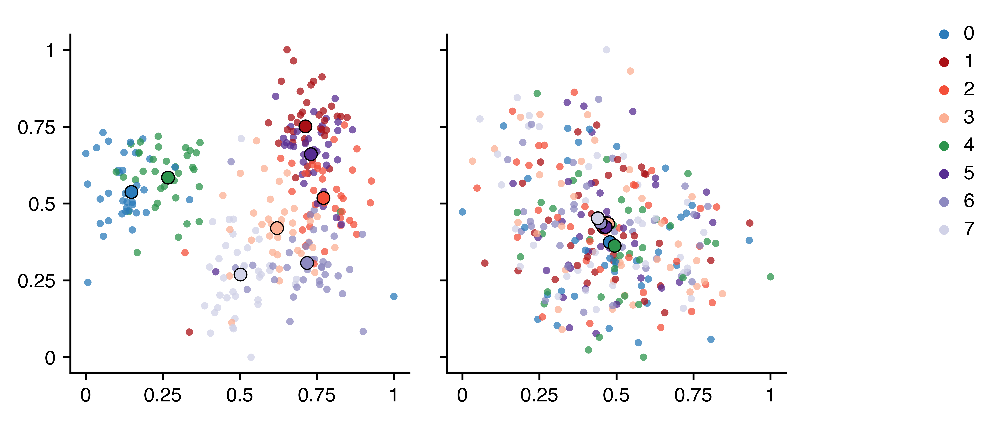

In [82]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 0
overwrite = 0
dpi=1200
alpha_points = 0.75
alpha_stars = 1
point_lw = 0
star_lw = 0.5
ax_linewidth = 0.8
ticklength = 3
tickpad = 3
show_legend = True
figsize = (colws['1'], colws['1'] * 0.5)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
size = 36
bbox_to_anchor = [1.58, 1.05]

# Plot the results.
fig, ax = plot_lda2(lda_results, size=size, figsize=figsize,
                    font=font, dpi=dpi, alpha_points=alpha_points, alpha_stars=alpha_stars,
                    point_lw=point_lw, star_lw=star_lw,
                    ax_linewidth=ax_linewidth, ticklength=ticklength, tickpad=tickpad,
                    show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
    
if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'LDA_predicting_iGameStateTime-{}units-whole_trial-10s_time_steps-trained_odd_trials-fit_even_trials.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight', pad_inches=0)
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight', pad_inches=0)

fig.show()

In [8]:
# Load LDA results.
time_step_size = 5000
save_results = 1
overwrite = 0
lda_results = train_lda(time_step_size=time_step_size,
                        save_results=save_results,
                        overwrite=overwrite)

# Re-sort c1_null, c2_null, and y_test_null on the y_test_null values within each trial.
for col in ['c1_null', 'c2_null', 'y_test_null']:
    lda_results[col] = lda_results.groupby('trial').apply(lambda x: np.array(x[col])[np.argsort(x['y_test_null'])]).explode().tolist()

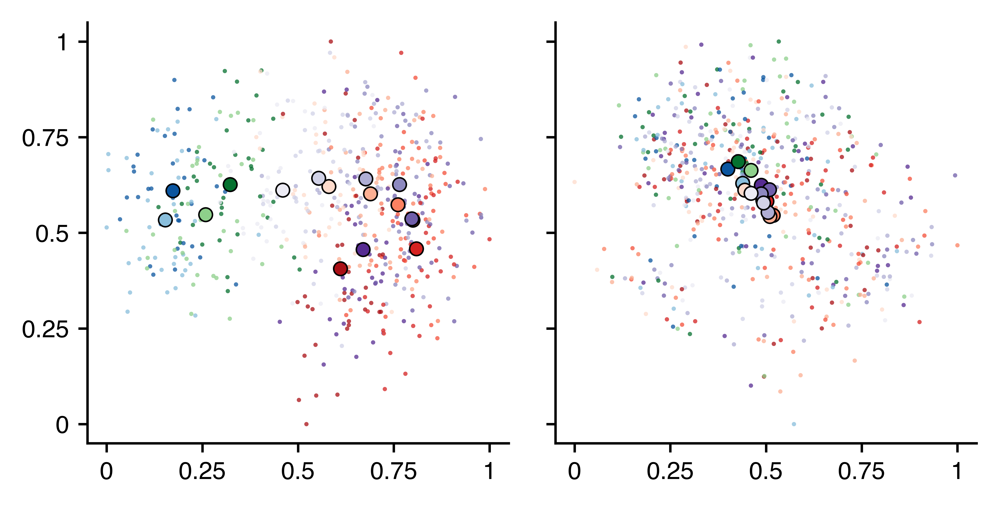

In [9]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 1
overwrite = 0
dpi=1200
plot_type = 'all'
size_points = 8
size_stars = 80
alpha_points = 0.75
alpha_stars = 1
point_lw = 0
star_lw = 0.5
ax_linewidth = 0.8
ticklength = 3
tickpad = 3
show_legend = 0
figsize = (colws['1'], colws['1'] * 0.5)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
bbox_to_anchor = [1.58, 1.05]

# Plot the results.
fig, ax = plot_lda2(lda_results, plot_type=plot_type, figsize=figsize, dpi=dpi,
                    size_points=size_points, size_stars=size_stars,
                    alpha_points=alpha_points, alpha_stars=alpha_stars,
                    point_lw=point_lw, star_lw=star_lw,
                    ax_linewidth=ax_linewidth, ticklength=ticklength, tickpad=tickpad,
                    font=font, show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
# for iax in range(len(ax)):
#     ax[iax].set_xlim([0.2, 0.8])
#     xticks = [0.2, 0.4, 0.6, 0.8]
#     ax[iax].set_xticks(xticks)
#     ax[iax].set_xticklabels(xticks)
#     ax[iax].set_ylim(ax[iax].get_xlim())
#     ax[iax].set_yticks(ax[iax].get_xticks())
#     if iax == 0:
#         ax[iax].set_yticklabels(ax[iax].get_xticklabels())

if savefig:
    pop_spikes = pop_decoding.load_pop_spikes()
    n_units = pop_spikes.neurons.size
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'LDA_predicting_iGameStateTime-{}units-whole_trial-5s_time_steps-LOOCV.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight', pad_inches=0)
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight', pad_inches=0)

fig.show()

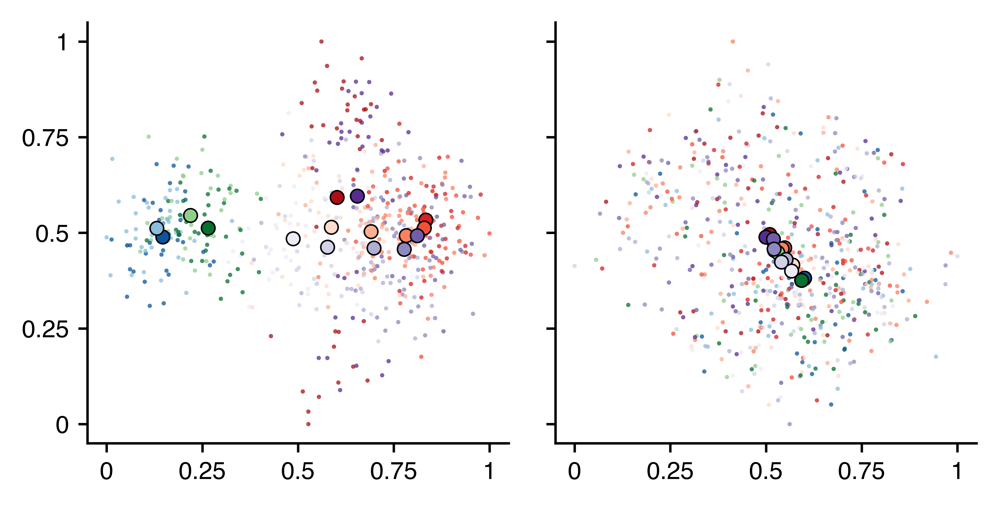

In [31]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 1
overwrite = 0
dpi=1200
plot_type = 'all'
size_points = 8
size_stars = 80
alpha_points = 0.75
alpha_stars = 1
point_lw = 0
star_lw = 0.5
ax_linewidth = 0.8
ticklength = 3
tickpad = 3
show_legend = 0
figsize = (colws['1'], colws['1'] * 0.5)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
bbox_to_anchor = [1.58, 1.05]

# Plot the results.
fig, ax = plot_lda2(lda_results, plot_type=plot_type, figsize=figsize, dpi=dpi,
                    size_points=size_points, size_stars=size_stars,
                    alpha_points=alpha_points, alpha_stars=alpha_stars,
                    point_lw=point_lw, star_lw=star_lw,
                    ax_linewidth=ax_linewidth, ticklength=ticklength, tickpad=tickpad,
                    font=font, show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
# for iax in range(len(ax)):
#     ax[iax].set_xlim([0.2, 0.8])
#     xticks = [0.2, 0.4, 0.6, 0.8]
#     ax[iax].set_xticks(xticks)
#     ax[iax].set_xticklabels(xticks)
#     ax[iax].set_ylim(ax[iax].get_xlim())
#     ax[iax].set_yticks(ax[iax].get_xticks())
#     if iax == 0:
#         ax[iax].set_yticklabels(ax[iax].get_xticklabels())

if savefig:
    pop_spikes = pop_decoding.load_pop_spikes()
    n_units = pop_spikes.neurons.size
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'LDA_predicting_iGameStateTime-{}units-whole_trial-5s_time_steps-LOOCV.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight', pad_inches=0)
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight', pad_inches=0)

fig.show()

In [89]:
# Select a subset of pop_spikes rows.
game_state = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
n_units = pop_spikes.pop_spikes.shape[1] - 3
_pop_spikes = pop_spikes.pop_spikes.query("(gameState=={})".format(game_state)).reset_index(drop=True).copy()

# Add a column for even/odd trials.
_pop_spikes.insert(1, 'is_odd', _pop_spikes['trial'].apply(lambda x: x % 2 != 0))

# Add a column for time step, and drop time bin.
_pop_spikes.insert(4, 'time_step', _pop_spikes['time_bin'].apply(lambda x: int(x/20)))
_pop_spikes.drop(columns=['time_bin'], inplace=True)

# Aggregate the spiking data.
_pop_spikes = _pop_spikes.groupby(['is_odd', 'trial', 'gameState', 'time_step'], observed=True).mean().reset_index()

# Add a column combining game state and time step.
_pop_spikes.insert(2,
                   'gameStateTime',
                   _pop_spikes.apply(lambda x: '{}: {}-{}s'.format(x['gameState'].replace('Delay', 'Delay '),
                                                                   10 * x['time_step'],
                                                                   10 * (x['time_step']+1)), axis=1))

trial_cats = ['Delay 1: 0-10s',
              'Encoding: 0-10s',
              'Encoding: 10-20s',
              'Encoding: 20-30s',
              'Delay 2: 0-10s',
              'Retrieval: 0-10s',
              'Retrieval: 10-20s',
              'Retrieval: 20-30s']
_pop_spikes['gameStateTime'] = _pop_spikes['gameStateTime'].astype(pd.CategoricalDtype(trial_cats, ordered=True))

print('_pop_spikes: {}'.format(_pop_spikes.shape))

_pop_spikes: (288, 462)


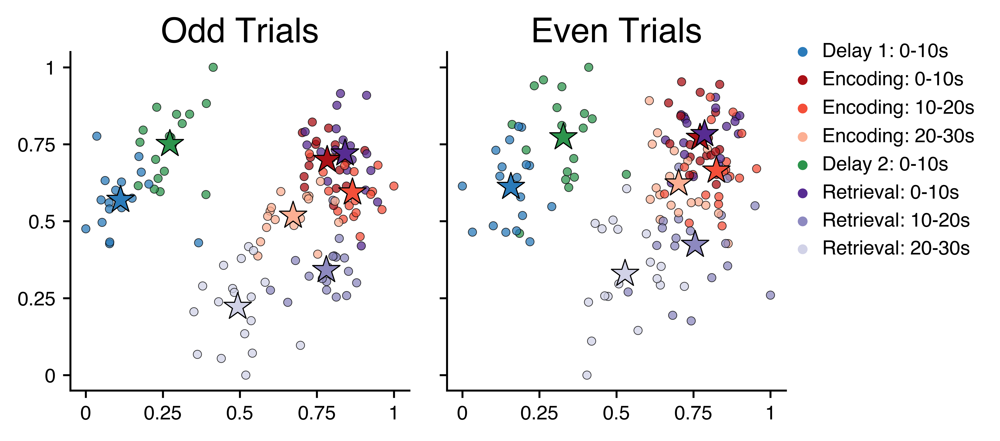

In [90]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 0
overwrite = 0
yvar = 'gameStateTime'
dpi=1200
alpha_points = 0.75
alpha_stars = 1
linewidth = 0.3
ax_linewidth = 0.8
ticklength = 3
tickpad = 3
show_legend = True
# figsize = (colws[2], colws[2] * 0.5)
# font = {'tick': 6, 'label': 7, 'annot': 6, 'fig': 9}
# size = 10
# bbox_to_anchor = [1.92, 1.05]
figsize = (colws['1'], colws['1'] * 0.5)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
size = 46
bbox_to_anchor = [1.58, 1.05]

# Select the training and test data.
odd_idx = _pop_spikes.query("(is_odd==True)").index.tolist()
even_idx = _pop_spikes.query("(is_odd!=True)").index.tolist()
X_odd = _pop_spikes.loc[odd_idx, neurons].values.copy()
y_odd = _pop_spikes.loc[odd_idx, yvar].values.copy()
X_even = _pop_spikes.loc[even_idx, neurons].values.copy()
y_even = _pop_spikes.loc[even_idx, yvar].values.copy()

# Train the classifier on odd trials.
lda = Pipeline(steps=[('impute', SimpleImputer(strategy='median')),
                      ('scale', StandardScaler()),
                      ('lda', LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto', n_components=2))])
X_odd_lda = lda.fit_transform(X_odd, y_odd)

# Fit the classifier on even trials.
X_even_lda = lda.transform(X_even)

# Add LDA columns to the dataframe.
_pop_spikes['c1'] = np.nan
_pop_spikes['c2'] = np.nan
_pop_spikes.loc[odd_idx, 'c1'] = X_odd_lda[:, 0]
_pop_spikes.loc[odd_idx, 'c2'] = X_odd_lda[:, 1]
_pop_spikes.loc[even_idx, 'c1'] = X_even_lda[:, 0]
_pop_spikes.loc[even_idx, 'c2'] = X_even_lda[:, 1]

# Plot the results.
fig, ax = plot_lda(_pop_spikes, 'c1', 'c2', hue=yvar, size=size, figsize=figsize,
                   font=font, dpi=dpi, alpha_points=alpha_points, alpha_stars=alpha_stars,
                   linewidth=linewidth, ax_linewidth=ax_linewidth, ticklength=ticklength, tickpad=tickpad,
                   show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
    
if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'LDA_predicting_gameStateTime-{}units-whole_trial-10s_time_steps-trained_odd_trials-fit_even_trials.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight', pad_inches=0)
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight', pad_inches=0)

fig.show()

In [92]:
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
bins_per_step = {'Delay1': 10, 'Encoding': 20, 'Delay2': 10, 'Retrieval': 20}
yvar = 'gameStateTime'

# Select a subset of pop_spikes rows.
n_units = pop_spikes.pop_spikes.shape[1] - 3
_pop_spikes = pop_spikes.pop_spikes.query("(gameState=={})".format(game_states)).reset_index(drop=True).copy()

# Add a column for even/odd trials.
_pop_spikes.insert(1, 'is_odd', _pop_spikes['trial'].apply(lambda x: x % 2 != 0))

# Add a column for time step, and drop time bin.
_pop_spikes.insert(4, 'time_step', np.nan)
for game_state in game_states:
    _pop_spikes.loc[(_pop_spikes['gameState']==game_state), 'time_step'] = (_pop_spikes.loc[(_pop_spikes['gameState']==game_state), 'time_bin']
                                                                                       .apply(lambda x: int(x/bins_per_step[game_state])))
_pop_spikes.drop(columns=['time_bin'], inplace=True)

# Aggregate the spiking data.
_pop_spikes = _pop_spikes.groupby(['is_odd', 'trial', 'gameState', 'time_step'], observed=True).mean().reset_index()

# Add a column combining game state and time step.
def _f(x):
    game_state = x['gameState']
    mult = bins_per_step[game_state] / 2
    start = mult * x['time_step']
    stop = mult * (x['time_step']+1)
    return '{}: {:.1f}-{:.1f}s'.format(game_state.replace('Delay', 'Delay '), start, stop)

_pop_spikes.insert(3, 'gameStateTime', np.nan)
_pop_spikes['gameStateTime'] = _pop_spikes.apply(lambda x: _f(x), axis=1)
n_time_steps = _pop_spikes.groupby('gameState')['gameStateTime'].apply(lambda x: len(np.unique(x))).to_dict()

trial_cats = ['Delay 1: 0.0-5.0s',
              'Delay 1: 5.0-10.0s',
              'Encoding: 0.0-10.0s',
              'Encoding: 10.0-20.0s',
              'Encoding: 20.0-30.0s',
              'Delay 2: 0.0-5.0s',
              'Delay 2: 5.0-10.0s',
              'Retrieval: 0.0-10.0s',
              'Retrieval: 10.0-20.0s',
              'Retrieval: 20.0-30.0s',]
_pop_spikes['gameStateTime'] = _pop_spikes['gameStateTime'].astype(pd.CategoricalDtype(trial_cats, ordered=True))

# Sort the dataframe.
_pop_spikes = _pop_spikes.sort_values(['trial', 'gameState', 'gameStateTime']).reset_index(drop=True)

# Train LDA classifier on odd trials, fit odd and even trials.
_pop_spikes.insert(5, 'c1', np.nan)
_pop_spikes.insert(6, 'c2', np.nan)
odd_idx = _pop_spikes.query("(gameState=={}) & (is_odd==True)".format(game_states)).index.tolist()
even_idx = _pop_spikes.query("(gameState=={}) & (is_odd==False)".format(game_states)).index.tolist()
X_odd = _pop_spikes.loc[odd_idx, neurons].values.copy()
y_odd = _pop_spikes.loc[odd_idx, yvar].values.copy()
X_even = _pop_spikes.loc[even_idx, neurons].values.copy()
y_even = _pop_spikes.loc[even_idx, yvar].values.copy()

# Train the classifier on odd trials.
lda = Pipeline(steps=[('impute', SimpleImputer(strategy='median')),
                      ('scale', StandardScaler()),
                      ('lda', LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto', n_components=2))])
X_odd_lda = lda.fit_transform(X_odd, y_odd)

# Fit the classifier on even trials.
X_even_lda = lda.transform(X_even)

# Add LDA columns to the dataframe.
_pop_spikes.loc[odd_idx, 'c1'] = X_odd_lda[:, 0]
_pop_spikes.loc[odd_idx, 'c2'] = X_odd_lda[:, 1]
_pop_spikes.loc[even_idx, 'c1'] = X_even_lda[:, 0]
_pop_spikes.loc[even_idx, 'c2'] = X_even_lda[:, 1]
    
print('_pop_spikes: {}'.format(_pop_spikes.shape))

_pop_spikes: (360, 464)


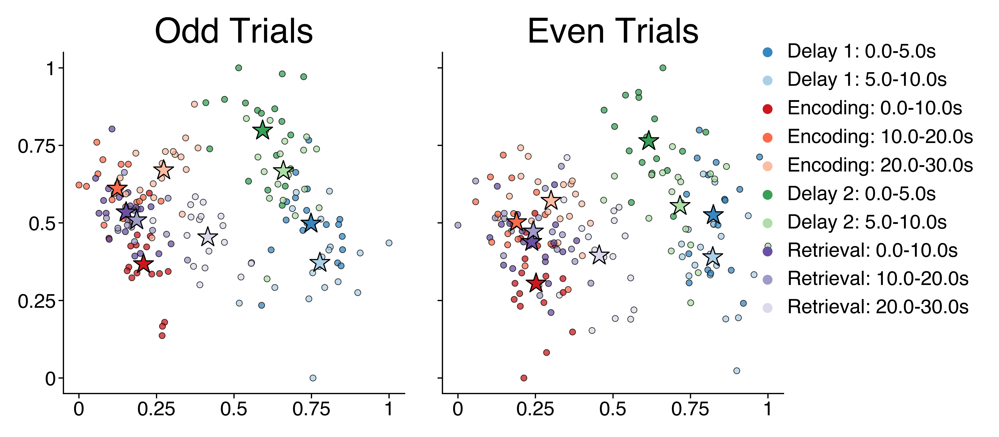

In [93]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 0
overwrite = 0
yvar = 'gameStateTime'
dpi=1200
alpha_points = 0.75
alpha_stars = 1
linewidth = 0.3
ax_linewidth = 0.5
show_legend = True
# figsize = (colws[2], colws[2] * 0.5)
# font = {'tick': 6, 'label': 7, 'annot': 6, 'fig': 9}
# size = 10
# bbox_to_anchor = [1.92, 1.05]
figsize = (colws['1'], colws['1'] * 0.5)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
size = 24
bbox_to_anchor = [1.58, 1.05]
cmaps = {'Delay1': 'Blues_r',
         'Encoding': 'Reds_r',
         'Delay2': 'Greens_r',
         'Retrieval': 'Purples_r'}
_cmap = list(np.concatenate([list(sns.color_palette(cmaps[game_state], n_time_steps[game_state])) 
                             for game_state in game_states]))

# Plot the results.
fig, ax = plot_lda(_pop_spikes, 'c1', 'c2', hue=yvar, size=size, figsize=figsize, _cmap=_cmap,
                   font=font, dpi=dpi, alpha_points=alpha_points, alpha_stars=alpha_stars,
                   linewidth=linewidth, ax_linewidth=ax_linewidth,
                   show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
    
if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'LDA_predicting_gameStateTime-{}units-whole_trial-4_time_bins_per_gameState-trained_odd_trials-fit_even_trials.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight', pad_inches=0)
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight', pad_inches=0)

fig.show()

In [37]:
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
bins_per_step = {'Delay1': 4, 'Encoding': 12, 'Delay2': 4, 'Retrieval': 12}
yvar = 'gameStateTime'

# Select a subset of pop_spikes rows.
n_units = pop_spikes.shape[1] - 3
_pop_spikes = pop_spikes.query("(gameState=={})".format(game_states)).reset_index(drop=True).copy()

# Add a column for even/odd trials.
_pop_spikes.insert(1, 'is_odd', _pop_spikes['trial'].apply(lambda x: x % 2 != 0))

# Add a column for time step, and drop time bin.
_pop_spikes.insert(4, 'time_step', np.nan)
for game_state in game_states:
    _pop_spikes.loc[(_pop_spikes['gameState']==game_state), 'time_step'] = (_pop_spikes.loc[(_pop_spikes['gameState']==game_state), 'time_bin']
                                                                                       .apply(lambda x: int(x/bins_per_step[game_state])))
_pop_spikes.drop(columns=['time_bin'], inplace=True)

# Aggregate the spiking data.
_pop_spikes = _pop_spikes.groupby(['is_odd', 'trial', 'gameState', 'time_step'], observed=True).mean().reset_index()

# Add a column combining game state and time step.
def _f(x):
    game_state = x['gameState']
    mult = int(bins_per_step[game_state] / 2)
    start = int(mult * x['time_step'])
    stop = int(mult * (x['time_step']+1))
    return '{}-{}s'.format(start, stop)

_pop_spikes.insert(3, 'gameStateTime', np.nan)
_pop_spikes['gameStateTime'] = _pop_spikes.apply(lambda x: _f(x), axis=1)
n_time_steps = _pop_spikes.groupby('gameState')['gameStateTime'].apply(lambda x: len(np.unique(x))).to_dict()

# Sort the dataframe.
_pop_spikes = _pop_spikes.sort_values(['trial', 'gameState', 'gameStateTime']).reset_index(drop=True)

# Train LDA classifier on odd trials, fit odd and even trials,
# separately for each game state.
_pop_spikes.insert(5, 'c1', np.nan)
_pop_spikes.insert(6, 'c2', np.nan)
for game_state in game_states:
    odd_idx = _pop_spikes.query("(gameState=='{}') & (is_odd==True)".format(game_state)).index.tolist()
    even_idx = _pop_spikes.query("(gameState=='{}') & (is_odd==False)".format(game_state)).index.tolist()
    X_odd = _pop_spikes.loc[odd_idx, neurons].values.copy()
    y_odd = _pop_spikes.loc[odd_idx, yvar].values.copy()
    X_even = _pop_spikes.loc[even_idx, neurons].values.copy()
    y_even = _pop_spikes.loc[even_idx, yvar].values.copy()

    # Train the classifier on odd trials.
    lda = Pipeline(steps=[('impute', SimpleImputer(strategy='median')),
                          ('scale', StandardScaler()),
                          ('lda', LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto', n_components=2))])
    X_odd_lda = lda.fit_transform(X_odd, y_odd)

    # Fit the classifier on even trials.
    X_even_lda = lda.transform(X_even)

    # Add LDA columns to the dataframe.
    _pop_spikes.loc[odd_idx, 'c1'] = X_odd_lda[:, 0]
    _pop_spikes.loc[odd_idx, 'c2'] = X_odd_lda[:, 1]
    _pop_spikes.loc[even_idx, 'c1'] = X_even_lda[:, 0]
    _pop_spikes.loc[even_idx, 'c2'] = X_even_lda[:, 1]
    
print('_pop_spikes: {}'.format(_pop_spikes.shape))

_pop_spikes: (720, 427)


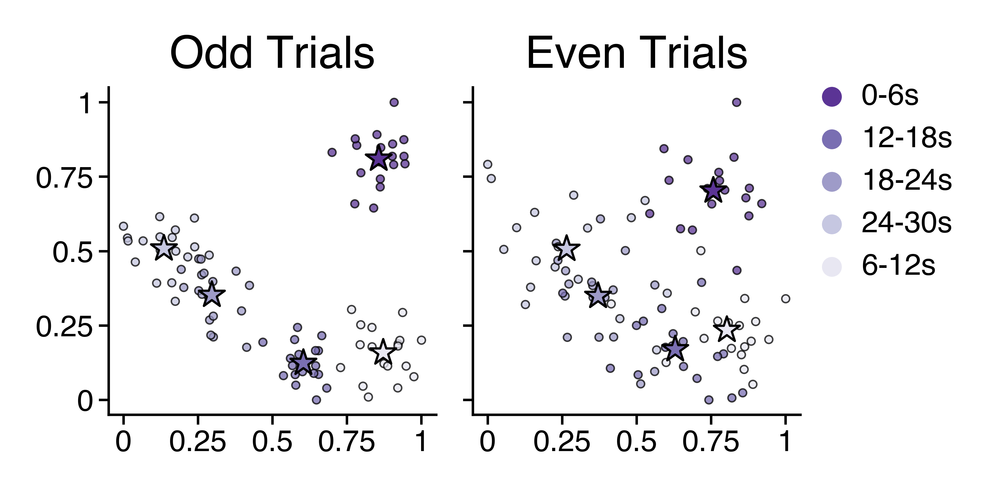

In [38]:
# Project population neural firing onto the first 2 linear discriminant components.
savefig = 1
overwrite = 1
figsize = (colws[2], colws[2] * 0.5)
dpi=1200
font = {'tick': 6, 'label': 7, 'annot': 6, 'fig': 9}
size = 10
alpha_points = 0.75
linewidth = 0.3
show_legend = True
bbox_to_anchor = [1.5, 1.05]
cmaps = {'Delay1': 'Blues_r',
         'Encoding': 'Reds_r',
         'Delay2': 'Greens_r',
         'Retrieval': 'Purples_r'}

# Plot the results.
for ii, game_state in enumerate(game_states):
    df = _pop_spikes.query("(gameState=='{}')".format(game_state))
    _n_time_steps = n_time_steps[game_state]
    _cmap = list(sns.color_palette(cmaps[game_state], _n_time_steps))
    fig, ax = plot_lda(df, 'c1', 'c2', hue=yvar, size=size, figsize=figsize, _cmap=_cmap,
                       font=font, dpi=dpi, alpha_points=alpha_points, linewidth=linewidth, 
                       show_legend=show_legend, bbox_to_anchor=bbox_to_anchor)
    
    if savefig:
        filename = op.join(proj_dir, 'figs', 'classifiers', 
                           'LDA_predicting_gameStateTime-{}units-{}-2s_time_steps-trained_odd_trials-fit_even_trials.pdf'.format(n_units, game_state))
        if overwrite or not op.exists(filename):
            fig.savefig(filename, format='pdf', bbox_inches='tight')
            fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

# SVC

In [14]:
# Train classifiers to predict time in each game state,
# using all neurons and saving the output classifiers.
game_states = ['Delay1', 'Delay2', 'Encoding', 'Retrieval']
# time_steps_per_game_state={'Delay1': 10, 'Encoding': 30, 'Delay2': 10, 'Retrieval': 30}
time_steps_per_game_state={'Delay1': 5, 'Encoding': 15, 'Delay2': 5, 'Retrieval': 15}
drop_first2 = True
save_results = True
overwrite = True
verbose = True

start_time = time()

clf_results = pop_decoding.classify_time(game_states=game_states,
                                         time_steps_per_game_state=time_steps_per_game_state,
                                         drop_first2=drop_first2,
                                         save_clfs=True,
                                         proj_dir=proj_dir,
                                         save_results=save_results,
                                         overwrite=overwrite,
                                         verbose=verbose)

print('Done in {:.1f} min'.format((time() - start_time) / 60))

Delay1: Fitting 457 neurons from all, 0.2 min
Delay2: Fitting 457 neurons from all, 5.2 min
Encoding: Fitting 457 neurons from all, 10.5 min
Retrieval: Fitting 457 neurons from all, 23.3 min
Saved /home1/dscho/projects/time_cells/analysis/classifiers/SVC_predicting_time_step-457units_all-random_search-36fold-Delay1_5bins-Delay2_5bins-Encoding_15bins-Retrieval_15bins-drop_first2s.pkl
Done in 35.0 min
Done in 35.0 min


In [6]:
def get_roi_groups(neurons):
    """Get a list of neurons in each region.
    
    Parameters
    ----------
    neurons : list
        Name of each neuron, e.g. 'U518_ses0-4-1'
        
    Returns
    -------
    roi_groups : OrderedDict roi_name[list_of_neurons]
    """
    roi_map = spike_preproc.roi_mapping(5)
    rois  = ['Hippocampus', 'MTL', 'Frontal', 'Temporal']
    rois_by_neuron = np.array([roi_map[spike_preproc.roi_lookup(neuron.split('-')[0], neuron.split('-')[1])[1:]]
                               for neuron in neurons])
    roi_groups = od([])
    for roi in rois:
        roi_groups[roi] = np.array(neurons)[np.where(rois_by_neuron==roi)[0]]
        
    return roi_groups

In [7]:
roi_groups = get_roi_groups(pop_spikes.neurons)

for roi in roi_groups:
    print('{}: {} neurons'.format(roi, len(roi_groups[roi])))

Hippocampus: 109 neurons
MTL: 204 neurons
Frontal: 69 neurons
Temporal: 75 neurons


In [ ]:
# Train classifiers to predict time in each game state,
# separately for each brain region.
game_states = ['Delay1', 'Delay2', 'Encoding', 'Retrieval']
time_steps_per_game_state={'Delay1': 10, 'Encoding': 30, 'Delay2': 10, 'Retrieval': 30}
drop_first2 = True
save_results = True
overwrite = True
verbose = True

start_time = time()

clf_results = pop_decoding.classify_time(unit_groups=roi_groups,
                                         game_states=game_states,
                                         time_steps_per_game_state=time_steps_per_game_state,
                                         drop_first2=drop_first2,
                                         proj_dir=proj_dir,
                                         save_results=save_results,
                                         overwrite=overwrite,
                                         verbose=verbose)

print('Done in {:.1f} min'.format((time() - start_time) / 60))

Delay1: Fitting 69 neurons from Hippocampus, 0.3 min
Delay1: Fitting 69 neurons from MTL, 21.9 min
Delay1: Fitting 69 neurons from Frontal, 35.8 min
Delay1: Fitting 69 neurons from Temporal, 46.1 min
Delay2: Fitting 69 neurons from Hippocampus, 56.6 min
Delay2: Fitting 69 neurons from MTL, 66.8 min
Delay2: Fitting 69 neurons from Frontal, 76.9 min
Delay2: Fitting 69 neurons from Temporal, 87.3 min
Encoding: Fitting 69 neurons from Hippocampus, 98.2 min
Encoding: Fitting 69 neurons from MTL, 136.1 min
Encoding: Fitting 69 neurons from Frontal, 174.0 min
Encoding: Fitting 69 neurons from Temporal, 211.7 min
Retrieval: Fitting 69 neurons from Hippocampus, 261.1 min


In [124]:
pop_spike_grps = classify_time(roi_groups,
                               game_states=['Delay1'])

In [65]:
unit_groups.keys()

odict_keys(['Hippocampus', 'MTL', 'Frontal', 'Temporal'])

In [125]:
np.mean(np.concatenate([[pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values()]
                                      for unit_group in unit_groups], axis=0), axis=1)

array([1181.04347826, 1005.82608696, 1005.82608696, 1717.92753623])

In [128]:
np.concatenate([[pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values()]
                                      for unit_group in unit_groups], axis=0)

array([[  19.,   28.,   51.,   62.,   65.,   75.,   78.,   81.,   87.,
         116.,  119.,  128.,  131.,  133.,  139.,  161.,  168.,  209.,
         213.,  231.,  272.,  274.,  285.,  286.,  294.,  327.,  332.,
         360.,  383.,  388.,  390.,  437.,  465.,  477.,  483.,  501.,
         525.,  549.,  555.,  594.,  627.,  635.,  650.,  680.,  743.,
         776.,  809.,  880.,  881.,  968., 1073., 1091., 1119., 1121.,
        1225., 1669., 1701., 1950., 2063., 2129., 2213., 2270., 2279.,
        2359., 2842., 2886., 3051., 3738., 8418.],
       [  19.,   28.,   51.,   62.,   65.,   75.,   78.,   81.,   87.,
         116.,  119.,  128.,  131.,  133.,  139.,  161.,  168.,  209.,
         213.,  231.,  272.,  274.,  285.,  286.,  294.,  327.,  332.,
         360.,  383.,  388.,  390.,  437.,  465.,  477.,  483.,  501.,
         525.,  549.,  555.,  594.,  627.,  635.,  650.,  680.,  743.,
         776.,  809.,  880.,  881.,  968., 1073., 1091., 1119., 1121.,
        1225., 1669., 1701

In [126]:
start_time = time()

# Match the number of spikes retained between unit groups,
# sorting the neurons in each unit group by firing rate and then
# randomly removing spikes from each neuron as needed.
keep_spikes = np.min(np.concatenate([[pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values()]
                                      for unit_group in unit_groups], axis=0), axis=0)
for unit_group in unit_groups:
    _keep_spikes = pd.Series(data=keep_spikes,
                             index=pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values().index.values,
                             dtype=int)
    for neuron, n_spikes in _keep_spikes.iteritems():
        spike_vec = pop_spike_grps[unit_group][neuron].values
        n_remove = spike_vec.sum() - n_spikes
        while n_remove > 0:
            iRow = np.random.randint(spike_vec.size)
            if spike_vec[iRow] > 0:
                spike_vec[iRow] -= 1
                n_remove -= 1
            
print(time() - start_time)

0.9538767337799072


In [127]:
np.mean(np.concatenate([[pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values()]
                                      for unit_group in unit_groups], axis=0), axis=1)

array([917.63768116, 917.63768116, 917.63768116, 917.63768116])

In [77]:
unit_group = 'MTL'

_keep_spikes = pd.Series(data=keep_spikes,
                         index=pop_spike_grps[unit_group].iloc[:, 3:].sum().sort_values().index.values,
                         dtype=int)
_keep_spikes

U532_ses0-45-2      19
U518_ses1-41-2      20
U530_ses1-47-1      28
U532_ses0-44-3      38
U532_ses0-44-2      51
U530_ses0-69-2      65
U532_ses0-14-2      68
U536_ses0-20-3      75
U536_ses0-38-3      78
U540_ses0-11-1      84
U518_ses0-31-1     128
U530_ses0-66-1     131
U530_ses0-48-2     133
U536_ses0-67-1     134
U539_ses0-16-2     139
U537_ses0-10-1     161
U536_ses0-17-1     209
U521_ses0-19-1     213
U526_ses0-38-1     230
U530_ses1-42-2     231
U518_ses1-4-4      271
U527_ses0-44-1     279
U530_ses0-46-2     289
U536_ses0-37-1     302
U521_ses0-21-2     308
U536_ses0-56-1     330
U532_ses0-47-2     333
U526_ses0-12-1     357
U536_ses0-18-1     360
U530_ses0-5-2      368
U530_ses0-67-1     390
U530_ses1-41-3     414
U530_ses0-70-1     477
U530_ses1-46-1     483
U527_ses0-44-2     501
U530_ses0-41-3     525
U539_ses0-11-2     549
U530_ses1-41-2     555
U518_ses0-44-1     614
U536_ses0-39-3     680
U518_ses0-28-1     693
U536_ses0-24-1     743
U521_ses0-21-1     841
U527_ses0-1

In [115]:
roi_groups = get_roi_groups(neurons)

for roi in roi_groups:
    print('{}: {} neurons'.format(roi, len(roi_groups[roi])))

Hippocampus: 91 neurons
MTL: 192 neurons
Cortex: 137 neurons


In [ ]:
# Classify time in each game state using subsets
# of neurons in each region.
time_steps_per_game_state = {'Delay1': 10, 'Encoding': 30, 'Delay2': 10, 'Retrieval': 30}
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']

clf_results = classify_time(unit_groups=roi_groups,
                            unit_group_n_perm=1,
                            game_states=game_states,
                            time_steps_per_game_state=time_steps_per_game_state,
                            search_method='random',
                            save_results=1,
                            overwrite=1,
                            verbose=1)

Loading saved Events file
Hippocampus, Delay1, loop 0, fitting 91 neurons: 0.1 min


In [5]:
# Cross-decode time within each game state from population neural activity,
# using support vector classification with nested cross-validation.
# E.g., use a decoder trained to predict Delay 1 time on a hold-out
# set of test trials to instead predict Delay 2 time on the same trials.
n_units = 420

start_time = time()

# Input params.
time_steps_per_game_state = {'Delay1': 10,
                             'Encoding': 30,
                             'Delay2': 10,
                             'Retrieval': 30}
filename = op.join(proj_dir, 'analysis', 'classifiers', 
                   'SVC_predicting_time_step-{}units-random_search-36fold-Delay1_{}bins-Encoding_{}bins-Delay2_{}bins-Retrieval_{}bins.pkl'
                   .format(n_units, time_steps_per_game_state['Delay1'], time_steps_per_game_state['Encoding'], 
                           time_steps_per_game_state['Delay2'], time_steps_per_game_state['Retrieval']))
clf_results = dio.open_pickle(filename)
y_col = 'time_step'
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
xgame_states = {'Delay1': 'Delay2',
                'Delay2': 'Delay1',
                'Encoding': 'Retrieval',
                'Retrieval': 'Encoding'}
kfold_outer = 36
search_method = 'random' # 'grid' or 'random'
save_results = 1
overwrite = 0
verbose = 0

def get_mean_accuracy(acc_vec, reshp):
    """Return mean accuracy across time_bins.
    
    Parameters
    ----------
    acc_vec : list
        Accuracy vector comparing y_test to y_test_pred 
        at each time bin, across test trials.
    reshp : list
        (n_test_trials, n_time_bins)
    """
    return np.mean(np.array(acc_vec).reshape(reshp), axis=0).tolist()

xclf_results = []
for game_state in game_states:
    print('{}: {:.1f}s'.format(game_state, time() - start_time))
    
    # Select output rows.
    clf_results_idx = clf_results.query("(gameState=='{}')".format(game_state)).index.tolist()
    
    # Select time bins across trials for the cross-decoded game state.
    xgame_state = xgame_states[game_state]
    _pop_spikes = pop_spikes.query("(gameState=='{}')".format(xgame_state)).copy()
    
    # Aggregate time bins into a defined number of equal-size, larger time steps.
    n_time_bins = np.unique(_pop_spikes['time_bin']).size
    n_time_steps = time_steps_per_game_state[game_state]
    bins_per_step = int(n_time_bins / n_time_steps)
    _pop_spikes.insert(2, 'time_step', _pop_spikes['time_bin'].apply(lambda time_bin: int(time_bin/bins_per_step)))

    # For each unit, sum spikes within each time step.
    _pop_spikes = _pop_spikes.groupby(['gameState', 'trial', 'time_step'], observed=True)[neurons].apply(np.sum).reset_index()

    # Perform repeated, nested cross-validation, splitting trials into 
    # test and nested train/val sets.
    for idx in clf_results_idx:
        row = clf_results.loc[idx]
        
        # Select the test trials.
        test = row['test_trials']
        
        # ---------------------------------
        # Observed data:
        #
        # Split trials into trainval and test sets.
        X_test = _pop_spikes.loc[np.isin(_pop_spikes['trial'], test)][neurons].values
        y_test = row['y_test']
        
        # Select the trained classifer.
        clf = row['clf']
        
        # Predict time from neural activity on test data.
        y_test_pred = clf.predict(X_test).tolist()

        # Calculate accuracy.
        accuracy = [y_test_pred[iVal]==y_test[iVal] for iVal in range(len(y_test))]
        acc_by_time = get_mean_accuracy(accuracy, reshp=(len(test), n_time_steps))
        mean_acc = np.mean(accuracy)

        # ---------------------------------
        # Null distribution:
        #
        # Circ-shift time steps within each trial to randomize 
        # time_step ~ pop_spiking associations across trials.
        shuf_idx = np.concatenate(_pop_spikes.reset_index()
                                             .groupby('trial')['index']
                                             .apply(lambda x: np.roll(x, np.random.randint(0, len(x))))
                                             .tolist())
        _pop_spikes_null = _pop_spikes.copy()
        _pop_spikes_null[y_col] = _pop_spikes_null.loc[shuf_idx, y_col].values
        
        # Split trials into trainval and test sets, using the same split as
        # for the observed data.
        X_test_null = X_test
        y_test_null = row['y_test_null']

        # Select the trained classifer.
        clf_null = row['clf_null']
        
        # Predict time from neural activity on test data.
        y_test_pred_null = clf_null.predict(X_test_null).tolist()

        # Calculate accuracy.
        accuracy_null = [y_test_pred_null[iVal]==y_test_null[iVal] for iVal in range(len(y_test_null))]
        acc_by_time_null = get_mean_accuracy(accuracy_null, reshp=(len(test), n_time_steps))
        mean_acc_null = np.mean(accuracy_null)
        
        # Append results to the output dataframe.
        xclf_results.append([game_state,
                             xgame_state,
                             n_time_steps,
                             test,
                             y_test,
                             y_test_pred,
                             mean_acc,
                             acc_by_time,
                             accuracy,
                             y_test_null,
                             y_test_pred_null,
                             mean_acc_null,
                             acc_by_time_null,
                             accuracy_null])

cols = ['gameState_train',
        'gameState_test',
        'n_time_steps',
        'test_trials',
        'y_test',
        'y_test_pred',
        'mean_acc',
        'acc_by_time',
        'accuracy',
        'y_test_null',
        'y_test_pred_null',
        'mean_acc_null',
        'acc_by_time_null',
        'accuracy_null']
xclf_results = pd.DataFrame(xclf_results, columns=cols)

if save_results:
    basename = 'SVC_predicting_{}'.format(y_col)
    basename += '-{}units'.format(len(neurons))
    basename += '-{}_search'.format(search_method)
    basename += '-{}fold'.format(kfold_outer)
    basename += '-cross_decoding'
    basename += '-' + '-'.join(['{}_{}bins'.format(game_state, time_steps_per_game_state[game_state]) for game_state in game_states])
    basename += '.pkl'
    filename = op.join(proj_dir, 'analysis', 'classifiers', basename)
    if overwrite or not op.exists(filename):
        dio.save_pickle(xclf_results, filename)
        
print('Done in {:.1f}s'.format(time() - start_time))

Delay1: 1.4s
Encoding: 18.7s
Delay2: 70.9s
Retrieval: 88.2s
Saved /home1/dscho/projects/time_cells/analysis/classifiers/SVC_predicting_time_step-420units-random_search-36fold-cross_decoding-Delay1_10bins-Encoding_30bins-Delay2_10bins-Retrieval_30bins.pkl
Done in 140.4s


In [34]:
n_units = 420
time_steps_per_game_state = {'Delay1': 10,
                             'Encoding': 30,
                             'Delay2': 10,
                             'Retrieval': 30}
filename = op.join(proj_dir, 'analysis', 'classifiers', 
                   'SVC_predicting_time_step-{}units-random_search-36fold-Delay1_{}bins-Encoding_{}bins-Delay2_{}bins-Retrieval_{}bins.pkl'
                   .format(n_units, time_steps_per_game_state['Delay1'], time_steps_per_game_state['Encoding'], 
                           time_steps_per_game_state['Delay2'], time_steps_per_game_state['Retrieval']))
clf_results = dio.open_pickle(filename)

filename = op.join(proj_dir, 'analysis', 'classifiers', 
                   'SVC_predicting_time_step-{}units-random_search-36fold-cross_decoding-Delay1_{}bins-Encoding_{}bins-Delay2_{}bins-Retrieval_{}bins.pkl'
                   .format(n_units, time_steps_per_game_state['Delay1'], time_steps_per_game_state['Encoding'], 
                           time_steps_per_game_state['Delay2'], time_steps_per_game_state['Retrieval']))
xclf_results = dio.open_pickle(filename)

# --------------------------
# Resort y_test_null and y_test_pred_null on the values within each y_test_null test trial.
def sort_onto(sort_on, 
              apply_to, 
              n_split=1):
    """Sort the values within each split of sort_on.
    
    Apply the sorting indices to apply_to."""
    # Split the input vectors.
    sort_on = np.split(np.array(sort_on), n_split)
    apply_to = np.split(np.array(apply_to), n_split)
    
    v_out = []
    for iSplit in range(len(sort_on)):
        v_out += list(apply_to[iSplit][np.argsort(sort_on[iSplit])])
    
    return v_out

for _df in (clf_results, xclf_results):
    for col in ['y_test_pred_null', 'y_test_null']:
        _df[col] = _df.apply(lambda x: sort_onto(x['y_test_null'], x[col], len(x['test_trials'])), axis=1)

# --------------------------
# Add error distances between actual and predicted values.
def clf_error_dist(y_test, y_test_pred):
    """Return the difference between predicted and actual values."""
    return list(np.array(y_test_pred) - np.array(y_test))

for _df in (clf_results, xclf_results):
    if 'error_dist' not in _df:
        _df.insert(_df.columns.tolist().index('accuracy')+1,
                   'error_dist',
                   _df.apply(lambda x: clf_error_dist(x['y_test'], x['y_test_pred']), axis=1))
    if 'error_dist_null' not in _df:
        _df.insert(_df.columns.tolist().index('accuracy_null')+1,
                   'error_dist_null',
                   _df.apply(lambda x: clf_error_dist(x['y_test_null'], x['y_test_pred_null']), axis=1))
    if 'mean_abs_error_dist' not in _df:
        _df.insert(_df.columns.tolist().index('error_dist')+1,
                   'mean_abs_error_dist',
                   _df['error_dist'].apply(lambda x: np.mean(np.abs(x))).tolist())
    if 'mean_abs_error_dist_null' not in _df:
        _df.insert(_df.columns.tolist().index('error_dist_null')+1,
                   'mean_abs_error_dist_null',
                   _df['error_dist_null'].apply(lambda x: np.mean(np.abs(x))).tolist())
        
null_error_dists = clf_results.groupby('gameState')['error_dist_null'].apply(lambda x: np.abs(x.tolist())) # game_state: trial x time
null_error_time = clf_results.groupby('gameState')['error_dist_null'].apply(lambda x: [np.mean(np.abs(x.tolist()), axis=0), stats.sem(np.abs(x.tolist()), axis=0)]) # game_state: time
null_error_trial = clf_results.groupby('gameState')['error_dist_null'].apply(lambda x: [np.mean(np.abs(x.tolist()), axis=1), stats.sem(np.abs(x.tolist()), axis=1)]) # game_state: trial

# Convert test_trials from list to int for LOO-CV where only one trial is tested at a time.
clf_results['test_trials'] = clf_results['test_trials'].apply(lambda x: int(x[0]))
xclf_results['test_trials'] = xclf_results['test_trials'].apply(lambda x: int(x[0]))

# Add correlations between actual and predicted times, by trial.
clf_results['pred_corr'] = clf_results.apply(lambda x: stats.pearsonr(x['y_test_pred'], x['y_test'])[0], axis=1).fillna(0)
clf_results['pred_corr_null'] = clf_results.apply(lambda x: stats.pearsonr(x['y_test_pred_null'], x['y_test_null'])[0], axis=1).fillna(0)
xclf_results['pred_corr'] = xclf_results.apply(lambda x: stats.pearsonr(x['y_test_pred'], x['y_test'])[0], axis=1).fillna(0)
xclf_results['pred_corr_null'] = xclf_results.apply(lambda x: stats.pearsonr(x['y_test_pred_null'], x['y_test_null'])[0], axis=1).fillna(0)

print(clf_results.shape, xclf_results.shape)

(144, 27) (144, 20)


/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


In [227]:
_df = clf_results

cols = ['y_test', 'y_test_pred', 'error_dist', 'accuracy',
        'y_test_null', 'y_test_pred_null', 'error_dist_null', 'accuracy_null']
grp = _df.groupby('gameState')
clf_dat = pd.concat([grp[col].apply(lambda x: np.concatenate(x.tolist())).explode()
                     for col in cols], axis=1).reset_index()
clf_dat.shape

(2880, 9)

In [228]:
_df = xclf_results

cols = ['y_test', 'y_test_pred', 'error_dist', 'accuracy',
        'y_test_null', 'y_test_pred_null', 'error_dist_null', 'accuracy_null']
grp = _df.groupby('gameState_test')
xclf_dat = pd.concat([grp[col].apply(lambda x: np.concatenate(x.tolist())).explode()
                      for col in cols], axis=1).reset_index()
xclf_dat.shape

(2880, 9)

In [253]:
def _acc_in_thirds(game_state, acc):
    acc *= 1
    if 'Delay' in game_state:
        n_time_bins = 4
        return [np.sum(acc[:4])/n_time_bins, np.sum(acc[3:7])/n_time_bins, np.sum(acc[6:])/n_time_bins]
    else:
        n_time_bins = 10
        return [np.sum(acc[:10])/n_time_bins, np.sum(acc[10:20])/n_time_bins, np.sum(acc[20:])/n_time_bins]

clf_results['acc3'] = clf_results.apply(lambda x: _acc_in_thirds(x['gameState'], x['accuracy']), axis=1) # trial x time_window
clf_results['acc3_null'] = clf_results.apply(lambda x: _acc_in_thirds(x['gameState'], x['accuracy_null']), axis=1)
xclf_results['acc3'] = clf_results.apply(lambda x: _acc_in_thirds(x['gameState'], x['accuracy']), axis=1)
xclf_results['acc3_null'] = clf_results.apply(lambda x: _acc_in_thirds(x['gameState'], x['accuracy_null']), axis=1)

In [276]:
def _err_dist_in_thirds(game_state, err_dist):
    err_dist = np.abs(err_dist)
    if 'Delay' in game_state:
        n_time_bins = 4
        return [np.mean(err_dist[:4]), np.mean(err_dist[3:7]), np.mean(err_dist[6:])]
    else:
        n_time_bins = 10
        return [np.mean(err_dist[:10]), np.mean(err_dist[10:20]), np.mean(err_dist[20:])]

clf_results['err3'] = clf_results.apply(lambda x: _err_dist_in_thirds(x['gameState'], x['error_dist']), axis=1) # trial x time_window
clf_results['err3_null'] = clf_results.apply(lambda x: _err_dist_in_thirds(x['gameState'], x['error_dist_null']), axis=1)
xclf_results['err3'] = clf_results.apply(lambda x: _err_dist_in_thirds(x['gameState'], x['error_dist']), axis=1)
xclf_results['err3_null'] = clf_results.apply(lambda x: _err_dist_in_thirds(x['gameState'], x['error_dist_null']), axis=1)

In [285]:
game_states = ['Delay1', 'Delay2', 'Encoding', 'Retrieval']
for game_state in game_states:
    acc3 = np.array(clf_results.query("(gameState=='{}')".format(game_state))['acc3'].tolist())
    acc3_null = np.array(clf_results.query("(gameState=='{}')".format(game_state))['acc3_null'].tolist())
    xacc3 = np.array(xclf_results.query("(gameState_test=='{}')".format(game_state))['acc3'].tolist())
    xacc3_null = np.array(xclf_results.query("(gameState_test=='{}')".format(game_state))['acc3_null'].tolist())
    
    matched_v_null = sm.stats.multipletests(stats.ttest_rel(acc3, acc3_null, axis=0)[1], method='holm')[:2]
    matched_v_cross = sm.stats.multipletests(stats.ttest_rel(acc3, xacc3, axis=0)[1], method='holm')[:2]
    cross_v_null = sm.stats.multipletests(stats.ttest_rel(xacc3, xacc3_null, axis=0)[1], method='holm')[:2]
    
    print(game_state, '-' * len(game_state),
          'matched    : {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}'
          .format(np.mean(acc3[:, 0]), stats.sem(acc3[:, 0]), np.mean(acc3[:, 1]), stats.sem(acc3[:, 1]), np.mean(acc3[:, 2]), stats.sem(acc3[:, 2])),
          'cross      : {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}'
          .format(np.mean(xacc3[:, 0]), stats.sem(xacc3[:, 0]), np.mean(xacc3[:, 1]), stats.sem(xacc3[:, 1]), np.mean(xacc3[:, 2]), stats.sem(xacc3[:, 2])),
          'null       : {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}'
          .format(np.mean(acc3_null[:, 0]), stats.sem(acc3_null[:, 0]), np.mean(acc3_null[:, 1]), stats.sem(acc3_null[:, 1]), np.mean(acc3_null[:, 2]), stats.sem(acc3_null[:, 2])),
          'cross null : {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}, {:>5.1%} ± {:>5.1%}'
          .format(np.mean(xacc3_null[:, 0]), stats.sem(xacc3_null[:, 0]), np.mean(xacc3_null[:, 1]), stats.sem(xacc3_null[:, 1]), np.mean(xacc3_null[:, 2]), stats.sem(xacc3_null[:, 2])),
          'matched vs. null  : {}'.format(matched_v_null),
          'matched vs. cross : {}'.format(matched_v_cross),
          'cross vs. null    : {}'.format(cross_v_null),
          sep='\n', end='\n\n')

Delay1
------
matched    : 29.2% ±  3.4%, 12.5% ±  2.5%, 16.0% ±  3.0%
cross      : 31.2% ±  3.9%, 13.2% ±  3.1%, 11.8% ±  2.9%
null       :  9.7% ±  2.3%, 10.4% ±  2.1%,  8.3% ±  2.2%
cross null :  9.7% ±  3.0%,  7.6% ±  1.9%,  9.7% ±  2.7%
matched vs. null  : (array([ True, False, False]), array([4.50322974e-05, 5.55943178e-01, 1.55630679e-01]))
matched vs. cross : (array([False, False, False]), array([1.        , 1.        , 0.73409527]))
cross vs. null    : (array([ True, False, False]), array([4.84160750e-04, 2.64904876e-01, 6.08483865e-01]))

Delay2
------
matched    : 31.2% ±  3.9%, 13.2% ±  3.1%, 11.8% ±  2.9%
cross      : 29.2% ±  3.4%, 12.5% ±  2.5%, 16.0% ±  3.0%
null       :  9.7% ±  3.0%,  7.6% ±  1.9%,  9.7% ±  2.7%
cross null :  9.7% ±  2.3%, 10.4% ±  2.1%,  8.3% ±  2.2%
matched vs. null  : (array([ True, False, False]), array([4.84160750e-04, 2.64904876e-01, 6.08483865e-01]))
matched vs. cross : (array([False, False, False]), array([1.        , 1.        , 0.73409527]))

In [286]:
game_states = ['Delay1', 'Delay2', 'Encoding', 'Retrieval']
for game_state in game_states:
    err3 = np.array(clf_results.query("(gameState=='{}')".format(game_state))['err3'].tolist())
    err3_null = np.array(clf_results.query("(gameState=='{}')".format(game_state))['err3_null'].tolist())
    xerr3 = np.array(xclf_results.query("(gameState_test=='{}')".format(game_state))['err3'].tolist())
    xerr3_null = np.array(xclf_results.query("(gameState_test=='{}')".format(game_state))['err3_null'].tolist())
    
    matched_v_null = sm.stats.multipletests(stats.ttest_rel(err3, err3_null, axis=0)[1], method='holm')[:2]
    matched_v_cross = sm.stats.multipletests(stats.ttest_rel(err3, xerr3, axis=0)[1], method='holm')[:2]
    cross_v_null = sm.stats.multipletests(stats.ttest_rel(xerr3, xerr3_null, axis=0)[1], method='holm')[:2]
    
    print(game_state, '-' * len(game_state),
          'matched    : {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}'
          .format(np.mean(err3[:, 0]), stats.sem(err3[:, 0]), np.mean(err3[:, 1]), stats.sem(err3[:, 1]), np.mean(err3[:, 2]), stats.sem(err3[:, 2])),
          'cross      : {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}'
          .format(np.mean(xerr3[:, 0]), stats.sem(xerr3[:, 0]), np.mean(xerr3[:, 1]), stats.sem(xerr3[:, 1]), np.mean(xerr3[:, 2]), stats.sem(xerr3[:, 2])),
          'null       : {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}'
          .format(np.mean(err3_null[:, 0]), stats.sem(err3_null[:, 0]), np.mean(err3_null[:, 1]), stats.sem(err3_null[:, 1]), np.mean(err3_null[:, 2]), stats.sem(err3_null[:, 2])),
          'cross null : {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}, {:>4.1f} ± {:>4.1f}'
          .format(np.mean(xerr3_null[:, 0]), stats.sem(xerr3_null[:, 0]), np.mean(xerr3_null[:, 1]), stats.sem(xerr3_null[:, 1]), np.mean(xerr3_null[:, 2]), stats.sem(xerr3_null[:, 2])),
          'matched vs. null  : {}'.format(matched_v_null),
          'matched vs. cross : {}'.format(matched_v_cross),
          'cross vs. null    : {}'.format(cross_v_null),
          sep='\n', end='\n\n')

Delay1
------
matched    :  2.2 ±  0.2,  2.1 ±  0.1,  2.4 ±  0.2
cross      :  2.1 ±  0.2,  2.1 ±  0.1,  2.7 ±  0.2
null       :  3.5 ±  0.2,  2.7 ±  0.2,  3.9 ±  0.3
cross null :  3.6 ±  0.2,  2.7 ±  0.1,  3.5 ±  0.3
matched vs. null  : (array([ True,  True,  True]), array([2.23168851e-04, 1.97927223e-03, 8.06626361e-05]))
matched vs. cross : (array([False, False, False]), array([1.        , 1.        , 0.79678266]))
cross vs. null    : (array([ True,  True,  True]), array([5.66185952e-05, 3.11696912e-02, 3.11696912e-02]))

Delay2
------
matched    :  2.1 ±  0.2,  2.1 ±  0.1,  2.7 ±  0.2
cross      :  2.2 ±  0.2,  2.1 ±  0.1,  2.4 ±  0.2
null       :  3.6 ±  0.2,  2.7 ±  0.1,  3.5 ±  0.3
cross null :  3.5 ±  0.2,  2.7 ±  0.2,  3.9 ±  0.3
matched vs. null  : (array([ True,  True,  True]), array([5.66185952e-05, 3.11696912e-02, 3.11696912e-02]))
matched vs. cross : (array([False, False, False]), array([1.        , 1.        , 0.79678266]))
cross vs. null    : (array([ True,  True,  True

In [35]:
# Get lag-CRP style curves for classifier performance vs. actual time.
def _count_error_dists(game_state, err_dists):
    if 'Delay' in game_state:
        err_props = pd.Series(data=np.zeros(19, dtype=int), index=np.arange(-9, 10))
    else:
        err_props = pd.Series(data=np.zeros(59, dtype=int), index=np.arange(-29, 30))
    
    counts = aop.unique(err_dists)
    for err_dist in err_props.index:
        err_props[err_dist] = counts.get(err_dist, 0)
    
    return err_props

# --------------------------------------
# Matched-decoding
err_counts = od({game_state: clf_results.query("(gameState=='{}')".format(game_state)).apply(lambda x: _count_error_dists(x['gameState'], x['error_dist']), axis=1)
                 for game_state in game_states})
err_props = od([])
for game_state in err_counts:
    if 'Delay' in game_state:
        n_time_bins = 10
    else:
        n_time_bins = 30
    _err_props = err_counts[game_state]/n_time_bins # trial x err_dist
    err_props[game_state] = {'means': np.mean(_err_props, axis=0),
                             'sems': stats.sem(_err_props, axis=0)}
    
# --------------------------------------
# Cross-decoding
xerr_counts = od({game_state: xclf_results.query("(gameState_test=='{}')".format(game_state)).apply(lambda x: _count_error_dists(x['gameState_test'], x['error_dist']), axis=1)
                  for game_state in game_states})
xerr_props = od([])
for game_state in xerr_counts:
    if 'Delay' in game_state:
        n_time_bins = 10
    else:
        n_time_bins = 30
    _err_props = xerr_counts[game_state]/n_time_bins # trial x err_dist
    xerr_props[game_state] = {'means': np.mean(_err_props, axis=0),
                              'sems': stats.sem(_err_props, axis=0)}
    
# --------------------------------------
# Null
err_counts_null = od({game_state: clf_results.query("(gameState=='{}')".format(game_state)).apply(lambda x: _count_error_dists(x['gameState'], x['error_dist_null']), axis=1)
                      for game_state in game_states})
err_props_null = od([])
for game_state in err_counts_null:
    if 'Delay' in game_state:
        n_time_bins = 10
    else:
        n_time_bins = 30
    _err_props = err_counts_null[game_state]/n_time_bins # trial x err_dist
    err_props_null[game_state] = {'means': np.mean(_err_props, axis=0),
                                  'sems': stats.sem(_err_props, axis=0)}
    
# --------------------------------------
err_props_all = od([('matched', err_props),
                    ('cross', xerr_props),
                    ('null', err_props_null)])

/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:1377: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/matplotlib/axes/_base.py:239: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


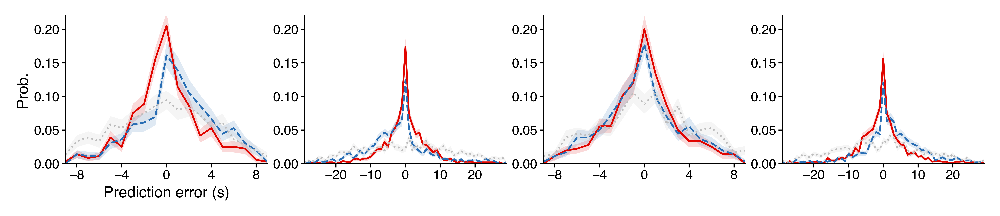

In [36]:
savefig = 0
overwrite = 0
figsize = (colws[2]*2, colws[2]*0.4)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
colors = ['#e10600', '#296eb4', '#bebebe']
linestyles = ['-', '--', 'dotted']
linewidth = 0.8
alpha = 0.15
spine_lw = 0.5
spine_len = 1.8
labelpad = 2
xlim = {'Delay1': [-9, 9],
        'Encoding': [-29, 29],
        'Delay2': [-9, 9],
        'Retrieval': [-29, 29]}
xticks = {'Delay1': [-8, -4, 0, 4, 8],
          'Encoding': [-20, -10, 0, 10, 20],
          'Delay2': [-8, -4, 0, 4, 8],
          'Retrieval': [-20, -10, 0, 10, 20]}
ymin = 0
ymax = 0.22
yticks = [0, 0.05, 0.1, 0.15, 0.2]
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']

plt.close()
fig, ax = plt.subplots(1, 4, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

for iax, game_state in enumerate(game_states):
    xvals = err_props[game_state]['means'].index.tolist()
    for iColor, clf_type in enumerate(err_props_all.keys()):
        ax[iax].fill_between(xvals, 
                             err_props_all[clf_type][game_state]['means'] + err_props_all[clf_type][game_state]['sems'],
                             err_props_all[clf_type][game_state]['means'] - err_props_all[clf_type][game_state]['sems'],
                             color=colors[iColor], linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, err_props_all[clf_type][game_state]['means'],
                     color=colors[iColor], linewidth=linewidth, linestyle=linestyles[iColor], zorder=1)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    ax[iax].set_xlim(xlim[game_state])
    ax[iax].set_xticks(xticks[game_state])
    ax[iax].set_ylim([ymin, ymax])
    ax[iax].set_yticks(yticks)
    if iax == 0:
        ax[iax].set_xlabel('Prediction error (s)', fontsize=font['label'], labelpad=labelpad)
        ax[iax].set_ylabel('Prob.', fontsize=font['label'], labelpad=labelpad)

fig.tight_layout(pad=0.25, h_pad=1.05)

if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_time_step-{}units-random_search-36fold-{}_{}bins-{}_{}bins___.pdf'
                       .format(n_units, game_states[0], n_time_steps, game_states[1], n_time_steps))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

In [193]:
# Get correlations between classifier predicted vs. actual times, by trial.
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']

def _corr_pred_actual(pred, actual):
    return stats.pearsonr(pred, actual)[0]

# --------------------------------------
# Matched-decoding
pred_corrs = od({game_state: clf_results.query("(gameState=='{}')".format(game_state)).apply(lambda x: _corr_pred_actual(x['y_test_pred'], x['y_test']), axis=1).fillna(0)
                 for game_state in game_states})
    
# --------------------------------------
# Cross-decoding
xpred_corrs = od({game_state: xclf_results.query("(gameState_test=='{}')".format(game_state)).apply(lambda x: _corr_pred_actual(x['y_test_pred'], x['y_test']), axis=1).fillna(0)
                  for game_state in game_states})
    
# --------------------------------------
# Null
pred_corrs_null = od({game_state: clf_results.query("(gameState=='{}')".format(game_state)).apply(lambda x: _corr_pred_actual(x['y_test_pred_null'], x['y_test_null']), axis=1).fillna(0)
                      for game_state in game_states})

# --------------------------------------
pred_corrs_all = od([('matched', pred_corrs),
                     ('cross', xpred_corrs),
                     ('null', pred_corrs_null)])

/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


In [198]:
# What are the correlations between predicted and actual performance, by trial?
for game_state in game_states:
    print(game_state, '-' * len(game_state),
          'matched: {:.3f} ± {:.3f}'.format(pred_corrs_all['matched'][game_state].mean(), stats.sem(pred_corrs_all['matched'][game_state])),
          'cross: {:.3f} ± {:.3f}'.format(pred_corrs_all['cross'][game_state].mean(), stats.sem(pred_corrs_all['cross'][game_state])),
          'null: {:.3f} ± {:.3f}'.format(pred_corrs_all['null'][game_state].mean(), stats.sem(pred_corrs_all['null'][game_state])),
          sep='\n', end='\n\n')

Delay1
------
matched: 0.468 ± 0.048
cross: 0.293 ± 0.063
null: -0.029 ± 0.067

Encoding
--------
matched: 0.720 ± 0.021
cross: 0.415 ± 0.037
null: -0.063 ± 0.037

Delay2
------
matched: 0.409 ± 0.059
cross: 0.332 ± 0.057
null: -0.027 ± 0.065

Retrieval
---------
matched: 0.668 ± 0.036
cross: 0.511 ± 0.031
null: -0.005 ± 0.034



In [ ]:
savefig = 0
overwrite = 0
figsize = (colws[2]*2, colws[2]*0.4)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
colors = ['#e10600', '#296eb4', '#bebebe']
linestyles = ['-', '--', 'dotted']
linewidth = 0.8
alpha = 0.15
spine_lw = 0.5
spine_len = 1.8
labelpad = 2
xlim = {'Delay1': [-9, 9],
        'Encoding': [-29, 29],
        'Delay2': [-9, 9],
        'Retrieval': [-29, 29]}
xticks = {'Delay1': [-8, -4, 0, 4, 8],
          'Encoding': [-20, -10, 0, 10, 20],
          'Delay2': [-8, -4, 0, 4, 8],
          'Retrieval': [-20, -10, 0, 10, 20]}
ymin = 0
ymax = 0.22
yticks = [0, 0.05, 0.1, 0.15, 0.2]
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']

plt.close()
fig, ax = plt.subplots(1, 4, figsize=figsize, dpi=dpi)
ax = np.ravel(ax)

for iax, game_state in enumerate(game_states):
    xvals = err_props[game_state]['means'].index.tolist()
    for iColor, clf_type in enumerate(err_props_all.keys()):
        ax[iax].fill_between(xvals, 
                             err_props_all[clf_type][game_state]['means'] + err_props_all[clf_type][game_state]['sems'],
                             err_props_all[clf_type][game_state]['means'] - err_props_all[clf_type][game_state]['sems'],
                             color=colors[iColor], linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, err_props_all[clf_type][game_state]['means'],
                     color=colors[iColor], linewidth=linewidth, linestyle=linestyles[iColor], zorder=1)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    ax[iax].set_xlim(xlim[game_state])
    ax[iax].set_xticks(xticks[game_state])
    ax[iax].set_ylim([ymin, ymax])
    ax[iax].set_yticks(yticks)
    if iax == 0:
        ax[iax].set_xlabel('Prediction error (s)', fontsize=font['label'], labelpad=labelpad)
        ax[iax].set_ylabel('Prob.', fontsize=font['label'], labelpad=labelpad)

fig.tight_layout(pad=0.25, h_pad=1.05)

if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_time_step-{}units-random_search-36fold-{}_{}bins-{}_{}bins___.pdf'
                       .format(n_units, game_states[0], n_time_steps, game_states[1], n_time_steps))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

In [213]:
def _f_all(x):
    return ('{:.1f} ± {:.1f}; {:.1f} ± {:.1f}'
            .format(np.mean(x), stats.sem(x), np.mean(np.abs(x)), stats.sem(np.abs(x))))

def _f_sign(x):
    return ('{:.1f} ± {:.1f}'
            .format(np.mean(x), stats.sem(x)))

def _f_abs(x):
    return ('{:.1f} ± {:.1f}'
            .format(np.mean(np.abs(x)), stats.sem(np.abs(x))))

_f = _f_abs
grpby = ['gameState', 'y_test']
df = pd.concat([(clf_dat.rename(columns={'error_dist': 'error_dist', 
                                         'error_dist_null': 'error_dist_null'})
                        .groupby(grpby)
                        .agg({'error_dist': lambda x: _f_sign(x), 
                              'error_dist_null': lambda x: _f_sign(x)})),
                (xclf_dat.rename(columns={'gameState_test': 'gameState', 
                                          'error_dist': 'xerror_dist', 
                                          'error_dist_null': 'xerror_dist_null'})
                         .groupby(grpby)
                         .agg({'xerror_dist': lambda x: _f_sign(x), 
                               'xerror_dist_null': lambda x: _f_sign(x)})),
                (clf_dat.rename(columns={'error_dist': 'abs_error_dist', 
                                         'error_dist_null': 'abs_error_dist_null'})
                        .groupby(grpby)
                        .agg({'abs_error_dist': lambda x: _f_abs(x), 
                              'abs_error_dist_null': lambda x: _f_abs(x)})),
                (xclf_dat.rename(columns={'gameState_test': 'gameState', 
                                          'error_dist': 'abs_xerror_dist', 
                                          'error_dist_null': 'abs_xerror_dist_null'})
                         .groupby(grpby)
                         .agg({'abs_xerror_dist': lambda x: _f_abs(x), 
                               'abs_xerror_dist_null': lambda x: _f_abs(x)}))],
               axis=1)[['error_dist', 'xerror_dist', 'error_dist_null', 'xerror_dist_null',
                        'abs_error_dist', 'abs_xerror_dist', 'abs_error_dist_null', 'abs_xerror_dist_null']]

df[['abs_error_dist', 'abs_xerror_dist', 'abs_error_dist_null', 'abs_xerror_dist_null']]

In [10]:
def _f(x):
    return '{:.1%}'.format(np.mean(x.astype(int)))

grpby = ['gameState']
df = pd.concat([(clf_dat.groupby(grpby)
                        .agg({'accuracy': lambda x: _f(x), 'accuracy_null': lambda x: _f(x)})),
                (xclf_dat.rename(columns={'gameState_test': 'gameState', 
                                          'accuracy': 'xaccuracy', 
                                          'accuracy_null': 'xaccuracy_null'})
                         .groupby(grpby)
                         .agg({'xaccuracy': lambda x: _f(x), 'xaccuracy_null': lambda x: _f(x)}))],
               axis=1)[['accuracy', 'xaccuracy', 'accuracy_null', 'xaccuracy_null']]

df

,accuracy,xaccuracy,accuracy_null,xaccuracy_null
gameState,,,,
Delay1,20.6%,16.1%,9.4%,8.1%
Delay2,20.0%,17.8%,8.9%,9.2%
Encoding,17.4%,12.4%,2.2%,2.9%
Retrieval,15.6%,12.0%,3.4%,2.6%


Delay1
------
Accuracy
within-decoding: 20.6 ± 1.9%
cross-decoding: 16.1 ± 1.8%
within null: 9.4 ± 1.4%
cross null: 8.1 ± 1.5%
within_vs_null: T(35) = 4.4, P = 0.000091, P_holm = 0.000272, reject = True
within_vs_cross: T(35) = 1.5, P = 0.132452, P_holm = 0.132452, reject = False
cross_vs_null: T(35) = 3.8, P = 0.000504, P_holm = 0.001008, reject = True

Error distance
within-decoding: 2.2 ± 0.1
cross-decoding: 2.7 ± 0.1
within null: 3.5 ± 0.1
cross null: 3.5 ± 0.1
within_vs_null: T(35) = -7.6, P = 0.000000, P_holm = 0.000000, reject = True
within_vs_cross: T(35) = -3.2, P = 0.002739, P_holm = 0.002739, reject = True
cross_vs_null: T(35) = -4.4, P = 0.000105, P_holm = 0.000211, reject = True

Actual vs. predicted time correlation
within-decoding: 0.468 ± 0.048
cross-decoding: 0.293 ± 0.063
within null: -0.029 ± 0.067
cross null: -0.045 ± 0.060
within_vs_null: T(35) = 5.9, P = 0.000001, P_holm = 0.000003, reject = True
within_vs_cross: T(35) = 2.7, P = 0.009604, P_holm = 0.009604, rejec

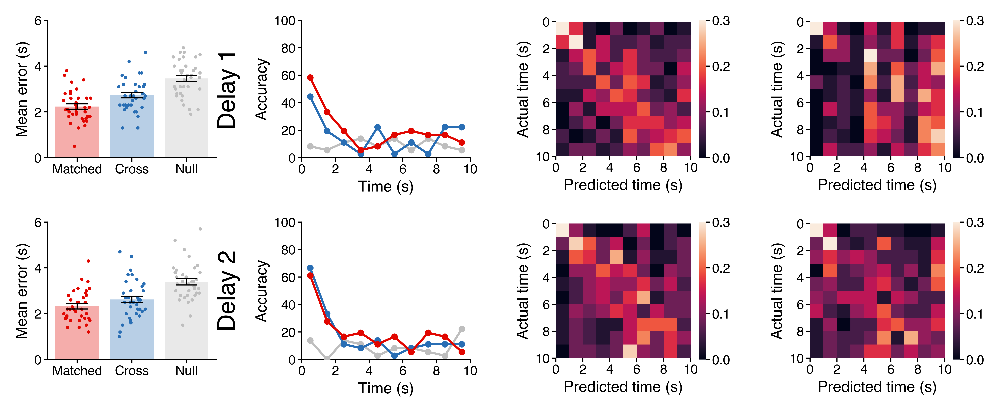

In [290]:
savefig = 0
overwrite = 0
game_states = ['Delay1', 'Delay2']
figsize = (colws[2]*2, colws[2]*0.8)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
ymin_acc = 0
ymax_acc = 1
yticks_acc = [0, 0.2, 0.4, 0.6, 0.8, 1]
error_dist_mult = 1 # 2
ymin_error_dist = 0
ymax_error_dist = 6
yticks_error_dist = [0, 2, 4, 6]
vmin = 0
vmax = 0.3
cbar_ticks = [0.0, 0.1, 0.2, 0.3] # [0.0, 0.2, 0.4, 0.6]
spine_lw = 0.5
spine_len = 1.8
labelpad = 2
add_cbar = True
plot_decode = True
plot_xdecode = True
plot_null = True
alpha = 0.15 #0.3
linewidth = 1 # 0.6
fliersize = 2.5

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(2, 4, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

for iState, game_state in enumerate(game_states):
    clf_dat = clf_results.query("(gameState=='{}')".format(game_state))
    xclf_dat = xclf_results.query("(gameState_test=='{}')".format(game_state))
    n_test = 1 # len(clf_dat.iloc[0]['test_trials'])
    n_time_steps = clf_dat.iloc[0]['n_time_steps']
    reshp = [n_test, n_time_steps]
    if game_state[:5] == 'Delay':
        xticks = np.linspace(0, n_time_steps, num=6)
        xticklabels = [0, 2, 4, 6, 8, 10]
    else:
        xticks = np.linspace(0, n_time_steps, num=4)
        xticklabels = [0, 10, 20, 30]
    
    # Run stats.
    _mean, _sem = clf_dat['mean_acc'].mean(), stats.sem(clf_dat['mean_acc'])
    _mean_null, _sem_null = clf_dat['mean_acc_null'].mean(), stats.sem(clf_dat['mean_acc_null'])
    _xmean, _xsem = xclf_dat['mean_acc'].mean(), stats.sem(xclf_dat['mean_acc'])
    _xmean_null, _xsem_null = xclf_dat['mean_acc_null'].mean(), stats.sem(xclf_dat['mean_acc_null'])
    print('{}\n{}'.format(game_state, '-' * len(game_state)),
          'Accuracy',
          'within-decoding: {:.1f} ± {:.1%}'.format(_mean * 100, _sem),
          'cross-decoding: {:.1f} ± {:.1%}'.format(_xmean * 100, _xsem),
          'within null: {:.1f} ± {:.1%}'.format(_mean_null * 100, _sem_null),
          'cross null: {:.1f} ± {:.1%}'.format(_xmean_null * 100, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['mean_acc'], xclf_dat['mean_acc'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['mean_acc'], xclf_dat['mean_acc_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
    
    _mean, _sem = clf_dat['mean_abs_error_dist'].mean(), stats.sem(clf_dat['mean_abs_error_dist'])
    _mean_null, _sem_null = clf_dat['mean_abs_error_dist_null'].mean(), stats.sem(clf_dat['mean_abs_error_dist_null'])
    _xmean, _xsem = xclf_dat['mean_abs_error_dist'].mean(), stats.sem(xclf_dat['mean_abs_error_dist'])
    _xmean_null, _xsem_null = xclf_dat['mean_abs_error_dist_null'].mean(), stats.sem(xclf_dat['mean_abs_error_dist_null'])
    print('',
          'Error distance',
          'within-decoding: {:.1f} ± {:.1}'.format(_mean, _sem),
          'cross-decoding: {:.1f} ± {:.1}'.format(_xmean, _xsem),
          'within null: {:.1f} ± {:.1}'.format(_mean_null, _sem_null),
          'cross null: {:.1f} ± {:.1}'.format(_xmean_null, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['mean_abs_error_dist'], clf_dat['mean_abs_error_dist_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['mean_abs_error_dist'], xclf_dat['mean_abs_error_dist'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['mean_abs_error_dist'], xclf_dat['mean_abs_error_dist_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
        
    _mean, _sem = clf_dat['pred_corr'].mean(), stats.sem(clf_dat['pred_corr'])
    _mean_null, _sem_null = clf_dat['pred_corr_null'].mean(), stats.sem(clf_dat['pred_corr_null'])
    _xmean, _xsem = xclf_dat['pred_corr'].mean(), stats.sem(xclf_dat['pred_corr'])
    _xmean_null, _xsem_null = xclf_dat['pred_corr_null'].mean(), stats.sem(xclf_dat['pred_corr_null'])
    print('',
          'Actual vs. predicted time correlation',
          'within-decoding: {:.3f} ± {:.3f}'.format(_mean, _sem),
          'cross-decoding: {:.3f} ± {:.3f}'.format(_xmean, _xsem),
          'within null: {:.3f} ± {:.3f}'.format(_mean_null, _sem_null),
          'cross null: {:.3f} ± {:.3f}'.format(_xmean_null, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['pred_corr'], clf_dat['pred_corr_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['pred_corr'], xclf_dat['pred_corr'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['pred_corr'], xclf_dat['pred_corr_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
        
    print('')
    
    # Make plots.
    iax = 4 * iState
    
    # Mean error across time bins.
    mean_errors = pd.DataFrame(np.vstack((np.vstack((['matched'] * len(clf_dat), clf_dat['mean_abs_error_dist'].tolist())).T,
                                          np.vstack((['cross'] * len(clf_dat), xclf_dat['mean_abs_error_dist'].tolist())).T,
                                          np.vstack((['null'] * len(clf_dat), clf_dat['mean_abs_error_dist_null'].tolist())).T)),
                               columns=['level', 'value'])
    mean_errors['level'] = mean_errors['level'].astype(pd.CategoricalDtype(['matched', 'cross', 'null'], ordered=True))
    mean_errors['value'] = mean_errors['value'].astype(float)
    sns.set_context(rc={'patch.linewidth': spine_lw})
    ax[iax] = sns.barplot(x='level', y='value', data=mean_errors, ax=ax[iax],
                          ci=None, palette=['#e10600', '#296eb4', '#bebebe'],
                          saturation=1, alpha=0.33, zorder=0)
    ax[iax] = sns.stripplot(x='level', y='value', data=mean_errors, ax=ax[iax],
                            palette=['#e10600', '#296eb4', '#bebebe'], size=1.5, alpha=1, jitter=0.25, zorder=1)
    ax[iax].errorbar(np.arange(3), mean_errors.groupby('level')['value'].mean().values,
                     yerr=mean_errors.groupby('level')['value'].apply(lambda x: stats.sem(x)).values,
                     ecolor='k', elinewidth=spine_lw, capsize=5, capthick=spine_lw, linewidth=0, zorder=2)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    ax[iax].set_xticks(np.arange(3))
    ax[iax].set_xticklabels(['Matched', 'Cross', 'Null'], fontsize=font['tick'])
    ax[iax].set_xlabel('')
    ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
    ax[iax].set_yticks(yticks_error_dist)
    ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
    ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)
    
    iax += 1
    # Accuracy.
    if plot_decode:
        _means = np.mean(clf_dat['acc_by_time'].tolist(), axis=0)
        _sems = stats.sem(clf_dat['acc_by_time'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#e10600', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=5)
    if plot_xdecode:
        _means = np.mean(xclf_dat['acc_by_time'].tolist(), axis=0)
        _sems = stats.sem(xclf_dat['acc_by_time'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#296eb4', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=4)
    if plot_null:
        _means = np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0)
        _sems = stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#bebebe', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=3)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks - 0.5
    ax[iax].set_xlim([-0.5, xvals.size-0.5])
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylim([ymin_acc, ymax_acc])
    ax[iax].set_yticks(yticks_acc)
    ax[iax].set_yticklabels([int(x*100) for x in yticks_acc], fontsize=font['tick'])
    ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)
    ax[iax].text(x=ax[iax].get_xlim()[0] - (np.diff(ax[iax].get_xlim()) * 0.5), # 0.4
                 y=np.mean(ax[iax].get_ylim()),
                 s=game_state.replace('Delay', 'Delay '),
                 fontsize=font['fig'], rotation=90, va='center')
    
#     iax += 1
#     # Error distance.
#     if plot_decode:
#         _means = np.mean(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#e10600', linewidth=0, alpha=alpha, zorder=2)
#         ax[iax].plot(xvals, _means, color='#e10600', linewidth=linewidth,
#                      linestyle='-', zorder=5) # , marker='o', markersize=font['annot']/3
#     if plot_xdecode:
#         _means = np.mean(np.abs(xclf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(xclf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#296eb4', linewidth=0, alpha=alpha, zorder=1)
#         ax[iax].plot(xvals, _means, color='#296eb4', linewidth=linewidth,
#                      linestyle='-', zorder=4) # , marker='o', markersize=font['annot']/3
#     if plot_null:
#         _means = np.mean(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means, color='#bebebe', linewidth=linewidth,
#                      linestyle='-', zorder=3) # , marker='o', markersize=font['annot']/3
#     for axis in ['left', 'bottom']:
#         ax[iax].spines[axis].set_linewidth(spine_lw)
#     ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
#     _xticks = xticks - 0.5
#     ax[iax].set_xlim([-0.5, xvals.size-0.5])
#     ax[iax].set_xticks(_xticks)
#     ax[iax].set_xticklabels(xticklabels)
#     ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
#     ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
#     ax[iax].set_yticks(yticks_error_dist)
#     ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
#     ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)
    
    iax += 1
    # Within-state confusion matrix.
    cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
    vmin = vmin
    vmax = vmax
    ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks
    ax[iax].set_xlim((_xticks.min(), _xticks.max()))
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_yticks(ax[iax].get_xticks())
    ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
    ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
    if add_cbar:
        cbar = ax[iax].collections[0].colorbar
        cbar.ax.tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
        cbar.set_ticks(cbar_ticks)
        cbar.set_ticklabels(cbar_ticks)
    else:
        ax[iax].collections[0].colorbar.remove()
    
    iax += 1
    # Cross-decoder confusion matrix.
    cmat = np.mean(xclf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
    vmin = vmin
    vmax = vmax
    ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks
    ax[iax].set_xlim((_xticks.min(), _xticks.max()))
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_yticks(ax[iax].get_xticks())
    ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
    ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
    if add_cbar:
        cbar = ax[iax].collections[0].colorbar
        cbar.ax.tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
        cbar.set_ticks(cbar_ticks)
        cbar.set_ticklabels(cbar_ticks)
    else:
        ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0.25, h_pad=1.05)

if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_time_step-{}units-random_search-36fold-{}_{}bins-{}_{}bins.pdf'
                       .format(n_units, game_states[0], n_time_steps, game_states[1], n_time_steps))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

Encoding
--------
Accuracy
within-decoding: 17.4 ± 1.2%
cross-decoding: 12.4 ± 0.7%
within null: 2.2 ± 0.4%
cross null: 2.9 ± 0.5%
within_vs_null: T(35) = 12.2, P = 0.000000, P_holm = 0.000000, reject = True
within_vs_cross: T(35) = 4.5, P = 0.000075, P_holm = 0.000075, reject = True
cross_vs_null: T(35) = 12.9, P = 0.000000, P_holm = 0.000000, reject = True

Error distance
within-decoding: 4.4 ± 0.2
cross-decoding: 6.8 ± 0.2
within null: 11.0 ± 0.3
cross null: 9.9 ± 0.2
within_vs_null: T(35) = -18.1, P = 0.000000, P_holm = 0.000000, reject = True
within_vs_cross: T(35) = -9.5, P = 0.000000, P_holm = 0.000000, reject = True
cross_vs_null: T(35) = -10.5, P = 0.000000, P_holm = 0.000000, reject = True

Actual vs. predicted time correlation
within-decoding: 0.720 ± 0.021
cross-decoding: 0.415 ± 0.037
within null: -0.063 ± 0.037
cross null: 0.057 ± 0.037
within_vs_null: T(35) = 18.3, P = 0.000000, P_holm = 0.000000, reject = True
within_vs_cross: T(35) = 7.0, P = 0.000000, P_holm = 0.00000

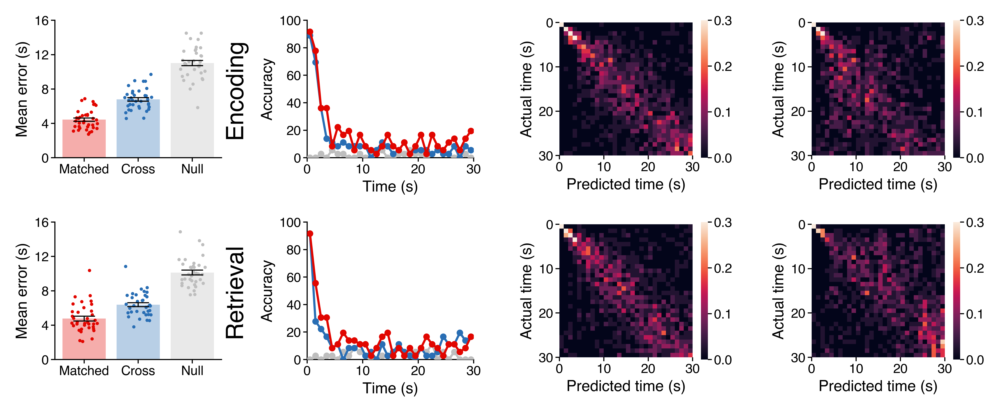

In [291]:
savefig = 0
overwrite = 0
game_states = ['Encoding', 'Retrieval']
figsize = (colws[2]*2, colws[2]*0.8)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 11, 'annot': 6}
ymin_acc = 0
ymax_acc = 1
yticks_acc = [0, 0.2, 0.4, 0.6, 0.8, 1]
error_dist_mult = 1 # 2
ymin_error_dist = 0
ymax_error_dist = 20
yticks_error_dist = [0, 4, 8, 12, 16, 20]
vmin = 0
vmax = 0.3
cbar_ticks = [0.0, 0.1, 0.2, 0.3] # [0.0, 0.2, 0.4, 0.6]
spine_lw = 0.5
spine_len = 1.8
labelpad = 2
add_cbar = True
plot_decode = True
plot_xdecode = True
plot_null = True
alpha = 0.15 #0.3
linewidth = 1 # 0.6
fliersize = 2.5

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(2, 4, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

for iState, game_state in enumerate(game_states):
    clf_dat = clf_results.query("(gameState=='{}')".format(game_state))
    xclf_dat = xclf_results.query("(gameState_test=='{}')".format(game_state))
    n_test = 1 # len(clf_dat.iloc[0]['test_trials'])
    n_time_steps = clf_dat.iloc[0]['n_time_steps']
    reshp = [n_test, n_time_steps]
    if game_state[:5] == 'Delay':
        xticks = np.linspace(0, n_time_steps, num=6)
        xticklabels = [0, 2, 4, 6, 8, 10]
    else:
        xticks = np.linspace(0, n_time_steps, num=4)
        xticklabels = [0, 10, 20, 30]
    
    # Run stats.
    _mean, _sem = clf_dat['mean_acc'].mean(), stats.sem(clf_dat['mean_acc'])
    _mean_null, _sem_null = clf_dat['mean_acc_null'].mean(), stats.sem(clf_dat['mean_acc_null'])
    _xmean, _xsem = xclf_dat['mean_acc'].mean(), stats.sem(xclf_dat['mean_acc'])
    _xmean_null, _xsem_null = xclf_dat['mean_acc_null'].mean(), stats.sem(xclf_dat['mean_acc_null'])
    print('{}\n{}'.format(game_state, '-' * len(game_state)),
          'Accuracy',
          'within-decoding: {:.1f} ± {:.1%}'.format(_mean * 100, _sem),
          'cross-decoding: {:.1f} ± {:.1%}'.format(_xmean * 100, _xsem),
          'within null: {:.1f} ± {:.1%}'.format(_mean_null * 100, _sem_null),
          'cross null: {:.1f} ± {:.1%}'.format(_xmean_null * 100, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['mean_acc'], xclf_dat['mean_acc'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['mean_acc'], xclf_dat['mean_acc_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
    
    _mean, _sem = clf_dat['mean_abs_error_dist'].mean(), stats.sem(clf_dat['mean_abs_error_dist'])
    _mean_null, _sem_null = clf_dat['mean_abs_error_dist_null'].mean(), stats.sem(clf_dat['mean_abs_error_dist_null'])
    _xmean, _xsem = xclf_dat['mean_abs_error_dist'].mean(), stats.sem(xclf_dat['mean_abs_error_dist'])
    _xmean_null, _xsem_null = xclf_dat['mean_abs_error_dist_null'].mean(), stats.sem(xclf_dat['mean_abs_error_dist_null'])
    print('',
          'Error distance',
          'within-decoding: {:.1f} ± {:.1}'.format(_mean, _sem),
          'cross-decoding: {:.1f} ± {:.1}'.format(_xmean, _xsem),
          'within null: {:.1f} ± {:.1}'.format(_mean_null, _sem_null),
          'cross null: {:.1f} ± {:.1}'.format(_xmean_null, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['mean_abs_error_dist'], clf_dat['mean_abs_error_dist_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['mean_abs_error_dist'], xclf_dat['mean_abs_error_dist'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['mean_abs_error_dist'], xclf_dat['mean_abs_error_dist_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
        
    _mean, _sem = clf_dat['pred_corr'].mean(), stats.sem(clf_dat['pred_corr'])
    _mean_null, _sem_null = clf_dat['pred_corr_null'].mean(), stats.sem(clf_dat['pred_corr_null'])
    _xmean, _xsem = xclf_dat['pred_corr'].mean(), stats.sem(xclf_dat['pred_corr'])
    _xmean_null, _xsem_null = xclf_dat['pred_corr_null'].mean(), stats.sem(xclf_dat['pred_corr_null'])
    print('',
          'Actual vs. predicted time correlation',
          'within-decoding: {:.3f} ± {:.3f}'.format(_mean, _sem),
          'cross-decoding: {:.3f} ± {:.3f}'.format(_xmean, _xsem),
          'within null: {:.3f} ± {:.3f}'.format(_mean_null, _sem_null),
          'cross null: {:.3f} ± {:.3f}'.format(_xmean_null, _xsem_null),
          sep='\n')
    ttests = od([('within_vs_null', stats.ttest_rel(clf_dat['pred_corr'], clf_dat['pred_corr_null'])),
                 ('within_vs_cross', stats.ttest_rel(clf_dat['pred_corr'], xclf_dat['pred_corr'])),
                 ('cross_vs_null', stats.ttest_rel(xclf_dat['pred_corr'], xclf_dat['pred_corr_null']))])
    df = len(clf_dat) - 1
    pvals_holm = sm.stats.multipletests([_test[1] for _test in ttests.values()], alpha=0.05, method='holm')
    for iTest, _test in enumerate(ttests):
        ttests[_test] = {'tstat': ttests[_test][0],
                         'pval': ttests[_test][1],
                         'pval_holm': pvals_holm[1][iTest],
                         'sig_holm': pvals_holm[0][iTest]}
        print('{}: T({}) = {:.1f}, P = {:.6f}, P_holm = {:.6f}, reject = {}'
              .format(_test, df, ttests[_test]['tstat'], ttests[_test]['pval'], ttests[_test]['pval_holm'], ttests[_test]['sig_holm']))
        
    print('')
    
    # Make plots.
    iax = 4 * iState
    
    # Mean error across time bins.
    mean_errors = pd.DataFrame(np.vstack((np.vstack((['matched'] * len(clf_dat), clf_dat['mean_abs_error_dist'].tolist())).T,
                                          np.vstack((['cross'] * len(clf_dat), xclf_dat['mean_abs_error_dist'].tolist())).T,
                                          np.vstack((['null'] * len(clf_dat), clf_dat['mean_abs_error_dist_null'].tolist())).T)),
                               columns=['level', 'value'])
    mean_errors['level'] = mean_errors['level'].astype(pd.CategoricalDtype(['matched', 'cross', 'null'], ordered=True))
    mean_errors['value'] = mean_errors['value'].astype(float)
    sns.set_context(rc={'patch.linewidth': spine_lw})
    ax[iax] = sns.barplot(x='level', y='value', data=mean_errors, ax=ax[iax],
                          ci=None, palette=['#e10600', '#296eb4', '#bebebe'],
                          saturation=1, alpha=0.33, zorder=0)
    ax[iax] = sns.stripplot(x='level', y='value', data=mean_errors, ax=ax[iax],
                            palette=['#e10600', '#296eb4', '#bebebe'], size=1.5, alpha=1, jitter=0.25, zorder=1)
    ax[iax].errorbar(np.arange(3), mean_errors.groupby('level')['value'].mean().values,
                     yerr=mean_errors.groupby('level')['value'].apply(lambda x: stats.sem(x)).values,
                     ecolor='k', elinewidth=spine_lw, capsize=5, capthick=spine_lw, linewidth=0, zorder=2)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    ax[iax].set_xticks(np.arange(3))
    ax[iax].set_xticklabels(['Matched', 'Cross', 'Null'], fontsize=font['tick'])
    ax[iax].set_xlabel('')
    ax[iax].set_ylim([ymin_error_dist, ymax_error_dist - 4])
    ax[iax].set_yticks(yticks_error_dist[:-1])
    ax[iax].set_yticklabels(yticks_error_dist[:-1], fontsize=font['tick'])
    ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)
    
    iax += 1
    # Accuracy.
    if plot_decode:
        _means = np.mean(clf_dat['acc_by_time'].tolist(), axis=0)
        _sems = stats.sem(clf_dat['acc_by_time'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#e10600', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=5)
    if plot_xdecode:
        _means = np.mean(xclf_dat['acc_by_time'].tolist(), axis=0)
        _sems = stats.sem(xclf_dat['acc_by_time'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#296eb4', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=4)
    if plot_null:
        _means = np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0)
        _sems = stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0)
        xvals = np.arange(len(_means))
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
        __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
        ax[iax].plot(xvals, _means, color='#bebebe', linewidth=linewidth,
                     linestyle='-', marker='o', markersize=font['annot']/3, zorder=3)
    for axis in ['left', 'bottom']:
        ax[iax].spines[axis].set_linewidth(spine_lw)
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks - 0.5
    ax[iax].set_xlim([-0.5, xvals.size-0.5])
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylim([ymin_acc, ymax_acc])
    ax[iax].set_yticks(yticks_acc)
    ax[iax].set_yticklabels([int(x*100) for x in yticks_acc], fontsize=font['tick'])
    ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)
    ax[iax].text(x=ax[iax].get_xlim()[0] - (np.diff(ax[iax].get_xlim()) * 0.5), # 0.4
                 y=np.mean(ax[iax].get_ylim()),
                 s=game_state.replace('Delay', 'Delay '),
                 fontsize=font['fig'], rotation=90, va='center')
    
#     iax += 1
#     # Error distance.
#     if plot_decode:
#         _means = np.mean(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#e10600', linewidth=0, alpha=alpha, zorder=2)
#         ax[iax].plot(xvals, _means, color='#e10600', linewidth=linewidth,
#                      linestyle='-', zorder=5) # , marker='o', markersize=font['annot']/3
#     if plot_xdecode:
#         _means = np.mean(np.abs(xclf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(xclf_dat['error_dist'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#296eb4', linewidth=0, alpha=alpha, zorder=1)
#         ax[iax].plot(xvals, _means, color='#296eb4', linewidth=linewidth,
#                      linestyle='-', zorder=4) # , marker='o', markersize=font['annot']/3
#     if plot_null:
#         _means = np.mean(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult
#         _sems = stats.sem(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult
#         xvals = np.arange(len(_means))
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means = np.concatenate([(_means[0],), _means, (_means[-1],)])
#         __sems = np.concatenate([(_sems[0],), _sems, (_sems[-1],)])
#         ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means, color='#bebebe', linewidth=linewidth,
#                      linestyle='-', zorder=3) # , marker='o', markersize=font['annot']/3
#     for axis in ['left', 'bottom']:
#         ax[iax].spines[axis].set_linewidth(spine_lw)
#     ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
#     _xticks = xticks - 0.5
#     ax[iax].set_xlim([-0.5, xvals.size-0.5])
#     ax[iax].set_xticks(_xticks)
#     ax[iax].set_xticklabels(xticklabels)
#     ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
#     ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
#     ax[iax].set_yticks(yticks_error_dist)
#     ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
#     ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)
    
    iax += 1
    # Within-state confusion matrix.
    cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
    vmin = vmin
    vmax = vmax
    ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks
    ax[iax].set_xlim((_xticks.min(), _xticks.max()))
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_yticks(ax[iax].get_xticks())
    ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
    ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
    if add_cbar:
        cbar = ax[iax].collections[0].colorbar
        cbar.ax.tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
        cbar.set_ticks(cbar_ticks)
        cbar.set_ticklabels(cbar_ticks)
    else:
        ax[iax].collections[0].colorbar.remove()
    
    iax += 1
    # Cross-decoder confusion matrix.
    cmat = np.mean(xclf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
    vmin = vmin
    vmax = vmax
    ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
    ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    _xticks = xticks
    ax[iax].set_xlim((_xticks.min(), _xticks.max()))
    ax[iax].set_xticks(_xticks)
    ax[iax].set_xticklabels(xticklabels)
    ax[iax].set_yticks(ax[iax].get_xticks())
    ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
    ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
    ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
    if add_cbar:
        cbar = ax[iax].collections[0].colorbar
        cbar.ax.tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
        cbar.set_ticks(cbar_ticks)
        cbar.set_ticklabels(cbar_ticks)
    else:
        ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0.25, h_pad=1.05)

if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_time_step-{}units-random_search-36fold-{}_{}bins-{}_{}bins.pdf'
                       .format(n_units, game_states[0], n_time_steps, game_states[1], n_time_steps))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

In [85]:
n_units = 420
filename = op.join(proj_dir, 'analysis', 'classifiers',
                   'SVC_predicting_iGameState-{}units-random_search-36fold.pkl'.format(n_units))
clf_results = dio.open_pickle(filename)
clf_results.rename(columns={'gameState': 'iGameState'}, inplace=True)

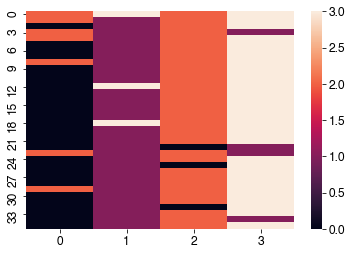

In [20]:
sns.heatmap(np.array(clf_results['y_test_pred'].tolist()))

In [88]:
np.mean(clf_results['acc_by_time'].tolist(), axis=0)

array([0.80555556, 0.91666667, 0.91666667, 0.88888889])

iGameState: 88.2 ± 2.7% (t(35)=11.0, p=7.014800554591937e-13)


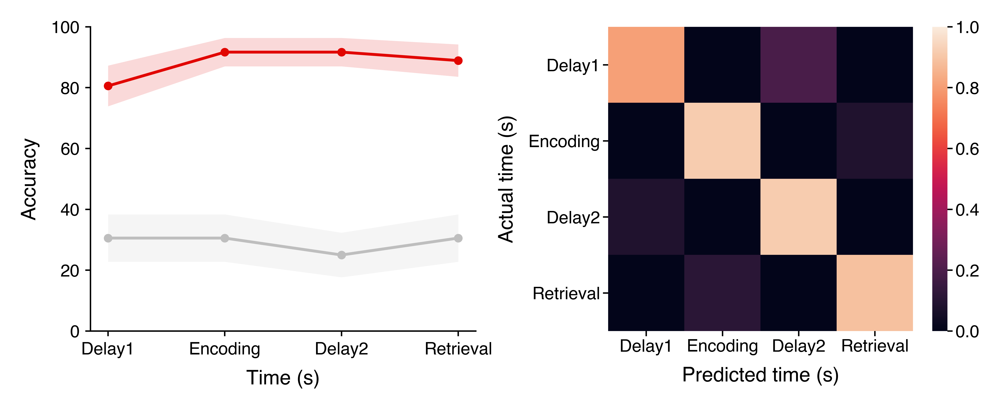

In [21]:
savefig = 1
overwrite = 1
figsize = (1.5*colws[2], 1.5*colws[2]*0.38)
dpi = 1200
font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
xticks = np.arange(4)
xticklabels = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
vmax = 1
cbar_ticks = [0.0, 0.2, 0.4, 0.6, 0.8, 1.0]
spine_lw = 0.5
spine_len = 1.8
labelpad = 4
add_cbar = True
plot_null = True
y_col = 'iGameState'
alpha = 0.15
linewidth = 1

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
reshp = [n_test, n_time_steps]

# Report mean accuracy.
_mean = np.mean(np.concatenate(clf_dat['accuracy'].tolist()))
_sem = stats.sem(np.concatenate(clf_dat['accuracy'].tolist()))
df = len(clf_dat) - 1
tval, pval = stats.ttest_rel(clf_dat['mean_acc'].tolist(), clf_dat['mean_acc_null'].tolist())
print('{}: {:.1f} ± {:.1%} (t({})={:.1f}, p={})'.format(y_col, _mean * 100, _sem, df, tval, pval))
obs = np.array(clf_dat['acc_by_time'].tolist())
null = np.array(clf_dat['acc_by_time_null'].tolist())
pvals = [stats.wilcoxon(obs[:, iTime], null[:, iTime], zero_method='pratt', alternative='greater')[1] for iTime in range(obs.shape[1])]
sig, pvals_corr, *_ = sm.stats.multipletests(pvals, alpha=0.05, method='holm')

# Make plots.
iax = 0
_means = np.mean(clf_dat['acc_by_time'].tolist(), axis=0)
_sems = stats.sem(clf_dat['acc_by_time'].tolist(), axis=0)
ax[iax].fill_between(np.arange(len(_means)), _means + _sems, _means - _sems,
                     color='#e10600', linewidth=0, alpha=alpha)
ax[iax].plot(_means, color='#e10600', linewidth=linewidth,
             linestyle='-') # , marker='o', markersize=font['annot']/3)
if plot_null:
    _means_null = np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0)
    _sems_null = stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0)
    ax[iax].fill_between(np.arange(len(_means_null)), _means_null + _sems_null, _means_null - _sems_null,
                         color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
    ax[iax].plot(_means_null, color='#bebebe', linewidth=linewidth,
                 linestyle='-') # , marker='o', markersize=font['annot']/3, zorder=1)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], pad=2, length=spine_len, width=spine_lw)
_xticks = xticks
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin, ymax])
ax[iax].set_yticks(yticks)
ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)

iax += 1
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
vmin = vmin
vmax = vmax
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
_xticks = xticks + 0.5
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0)

if savefig:
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameState-{}units-random_search-36fold.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

In [5]:
n_units = 420
filename = op.join(proj_dir, 'analysis', 'classifiers',
                   'SVC_predicting_iGameStateOverTime-{}units-random_search-40time_steps-4levels-36fold.pkl'.format(n_units))
clf_results = dio.open_pickle(filename)
clf_results.rename(columns={'gameState': 'iGameState'}, inplace=True)

# --------------------------
# Resort y_test_null and y_test_pred_null on the values within each y_test_null test trial.
def sort_onto(sort_on, 
              apply_to, 
              n_split=1):
    """Sort the values within each split of sort_on.
    
    Apply the sorting indices to apply_to."""
    # Split the input vectors.
    sort_on = np.split(np.array(sort_on), n_split)
    apply_to = np.split(np.array(apply_to), n_split)
    
    v_out = []
    for iSplit in range(len(sort_on)):
        v_out += list(apply_to[iSplit][np.argsort(sort_on[iSplit])])
    
    return v_out

for _df in (clf_results,):
    for col in ['y_test_pred_null', 'accuracy_null', 'acc_by_time_null', 'y_test_null']:
        _df[col] = _df.apply(lambda x: sort_onto(x['y_test_null'], x[col], len(x['test_trials'])), axis=1)
    assert np.array_equal(np.array(_df['y_test'].tolist()), np.array(_df['y_test_null'].tolist()))

In [6]:
np.mean(clf_results.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)

array([[0.72222222, 0.        , 0.27777778, 0.        ],
       [0.        , 0.80555556, 0.        , 0.19444444],
       [0.27777778, 0.        , 0.72222222, 0.        ],
       [0.        , 0.18611111, 0.        , 0.81388889]])

In [85]:
square = 1

plt.close()
fig, ax = plt.subplots(2, 3, figsize=(11, 6), dpi=1200)
ax = np.ravel(ax)

sns.heatmap(clf_results['y_test'].tolist(), ax=ax[0])
sns.heatmap(clf_results['y_test_pred'].tolist(), ax=ax[1])
sns.heatmap(np.mean(clf_results.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0), square=square, ax=ax[2])
ax[2].s

sns.heatmap(clf_results['y_test_null'].tolist(), ax=ax[3])
sns.heatmap(clf_results['y_test_pred_null'].tolist(), ax=ax[4])
sns.heatmap(np.mean(clf_results.apply(lambda x: confusion_matrix(x['y_test_null'], x['y_test_pred_null'], normalize='true'), axis=1).tolist(), axis=0), square=square, ax=ax[5])

fig.tight_layout()
fig.show()

In [88]:
square = 1
cmat = np.mean(clf_results.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
cmat_null = np.mean(clf_results.apply(lambda x: confusion_matrix(x['y_test_null'], x['y_test_pred_null'], normalize='true'), axis=1).tolist(), axis=0)
vmin = 0
vmax = np.max((cmat.max(), cmat_null.max()))

plt.close()
fig, ax = plt.subplots(2, 3, figsize=(11, 6), dpi=1200)
ax = np.ravel(ax)

sns.heatmap(clf_results['y_test'].tolist(), ax=ax[0])
sns.heatmap(clf_results['y_test_pred'].tolist(), ax=ax[1])
sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=square, ax=ax[2])

sns.heatmap(clf_results['y_test_null'].tolist(), ax=ax[3])
sns.heatmap(clf_results['y_test_pred_null'].tolist(), ax=ax[4])
sns.heatmap(cmat_null, vmin=vmin, vmax=vmax, square=square, ax=ax[5])

fig.tight_layout()
fig.show()

iGameStateOverTime: 76.6 ± 1.5% (t(35)=19.5, p=2.3884820088701166e-20)


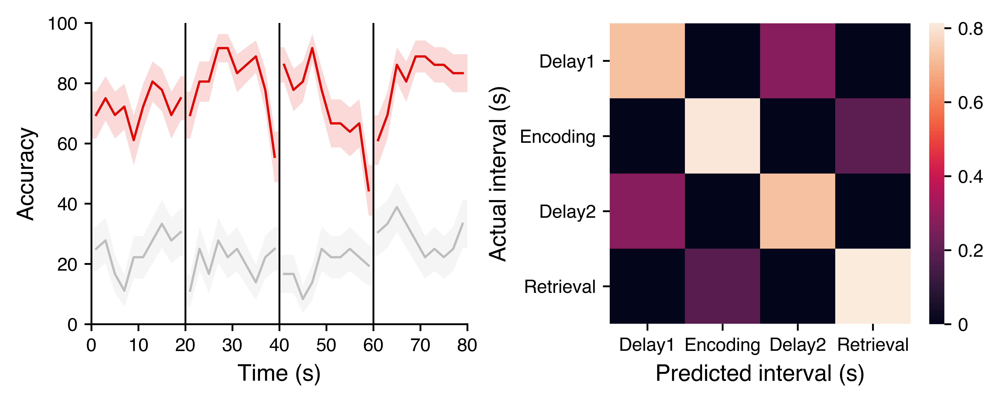

In [7]:
savefig = 1
overwrite = 0
dpi = 1200
vlines = [0, 10, 20, 30, 40] # [0, 5, 20, 25, 40]
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
cbar_ticks = [0, 0.2, 0.4, 0.6, 0.8, 1.0]
labelpad = 4
add_cbar = True
plot_null = True
alpha = 0.15
# figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# linewidth = 1
# spine_len = 1.8
# spine_lw = 0.5
figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
linewidth = 1
ticklength = 3
tickpad = 3
spine_len = 3
spine_lw = 0.8
xlinewidth = 0.25
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
reshp = [n_test, n_time_steps]
xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
xticklabels = xticks * int(80/n_time_steps)

# Report mean accuracy.
_mean = clf_dat['mean_acc'].mean()
_sem = stats.sem(clf_dat['mean_acc'].tolist())
df = len(clf_dat) - 1
tval, pval = stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null'])
print('{}: {:.1f} ± {:.1%} (t({})={:.1f}, p={})'.format('iGameStateOverTime', _mean * 100, _sem, df, tval, pval))
# obs = np.array(clf_dat['acc_by_time'].tolist())
# null = np.array(clf_dat['acc_by_time_null'].tolist())
# pvals = [stats.wilcoxon(obs[:, iTime], null[:, iTime], zero_method='pratt', alternative='greater')[1] for iTime in range(obs.shape[1])]
# sig, pvals_corr, *_ = sm.stats.multipletests(pvals, alpha=0.05, method='holm')

# Make plots.
iax = 0
ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
_means = np.split(np.mean(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
_sems = np.split(stats.sem(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
for ii in range(len(_means)):
    xvals = np.arange(vlines[ii], vlines[ii+1])
    _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
    __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
    __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
    ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
                         color='#e10600', linewidth=0, alpha=alpha, zorder=1)
    ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
                 linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/4)
if plot_null:
    _means_null = np.split(np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    _sems_null = np.split(stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    for ii in range(len(_means_null)):
        xvals = np.arange(vlines[ii], vlines[ii+1])
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
        __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
        ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
                             color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
                     linestyle='-', zorder=2) #, marker='o', markersize=font['annot']/4)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
_xticks = xticks - 0.5
ax[iax].set_xlim((_xticks[0], _xticks[-1]))
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin, ymax])
ax[iax].set_yticks(yticks)
ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)

iax += 1
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
vmin = vmin
vmax = vmax = cmat.max()
_xticks = np.arange(4) + 0.5
xticklabels = game_states
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
#ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
#ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Predicted interval (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Actual interval (s)', fontsize=font['label'], labelpad=labelpad)

if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0, w_pad=0.5)

if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateOverTime-{}units-random_search-80time_steps-4levels-36fold.pdf'.format(n_units))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.set_facecolor('w')
fig.show()

# SVC whole-trial time

In [3]:
n_units = 457 # 420
filename = op.join(proj_dir, 'analysis', 'classifiers',
                   'SVC_predicting_iGameStateTime-{}units-random_search-40bins-36fold.pkl'.format(n_units))
# filename = op.join(proj_dir, 'analysis', 'classifiers',
#                    'SVC_predicting_iGameStateTime-{}units-random_search-80bins-5foldin-36foldout.pkl'.format(n_units))
clf_results = dio.open_pickle(filename)
clf_results.rename(columns={'gameState': 'iGameState'}, inplace=True)

In [6]:
def sort_onto(sort_on, 
              apply_to, 
              n_split=1):
    """Sort the values within each split of sort_on.
    
    Apply the sorting indices to apply_to."""
    # Split the input vectors.
    sort_on = np.split(np.array(sort_on), n_split)
    apply_to = np.split(np.array(apply_to), n_split)
    
    v_out = []
    for iSplit in range(len(sort_on)):
        v_out += list(apply_to[iSplit][np.argsort(sort_on[iSplit])])
    
    return v_out


def clf_error_dist(y_test, y_test_pred):
    """Return the difference between predicted and actual values."""
    return list(np.array(y_test_pred) - np.array(y_test))


def clf_pred_corr(y_test, y_test_pred):
    """Return the Pearson correlation between predicted and actual times."""
    return stats.pearsonr(y_test, y_test_pred)[0]


# Resort y_test_null and y_test_pred_null on the values within each y_test_null test trial.
for _df in (clf_results,):
    for col in ['y_test_pred_null', 'y_test_null']:
        _df[col] = _df.apply(lambda x: sort_onto(x['y_test_null'], x[col], len(x['test_trials'])), axis=1)

# Add error distances between actual and predicted values.
for _df in (clf_results,):
    if 'error_dist' not in _df:
        _df.insert(_df.columns.tolist().index('accuracy')+1,
                   'error_dist',
                   _df.apply(lambda x: clf_error_dist(x['y_test'], x['y_test_pred']), axis=1))
    if 'error_dist_null' not in _df:
        _df.insert(_df.columns.tolist().index('accuracy_null')+1,
                   'error_dist_null',
                   _df.apply(lambda x: clf_error_dist(x['y_test_null'], x['y_test_pred_null']), axis=1))
    if 'mean_abs_error_dist' not in _df:
        _df.insert(_df.columns.tolist().index('error_dist')+1,
                   'mean_abs_error_dist',
                   _df['error_dist'].apply(lambda x: np.mean(np.abs(x))).tolist())
    if 'mean_abs_error_dist_null' not in _df:
        _df.insert(_df.columns.tolist().index('error_dist_null')+1,
                   'mean_abs_error_dist_null',
                   _df['error_dist_null'].apply(lambda x: np.mean(np.abs(x))).tolist())

# Add correlations between actual and predicted times.
for _df in (clf_results,):
    if 'pred_corr' not in _df:
        _df.insert(_df.columns.tolist().index('mean_abs_error_dist')+1,
                   'pred_corr',
                   _df.apply(lambda x: clf_pred_corr(x['y_test'], x['y_test_pred']), axis=1).fillna(0))
    if 'pred_corr_null' not in _df:
        _df.insert(_df.columns.tolist().index('mean_abs_error_dist_null')+1,
                   'pred_corr_null',
                   _df.apply(lambda x: clf_pred_corr(x['y_test_null'], x['y_test_pred_null']), axis=1).fillna(0))
    
print(clf_results.shape)

(36, 25)


/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


In [17]:
from helper_funcs import *

In [27]:
arr.shape

(36, 40)

In [28]:
arr = np.array(clf_results['acc_by_time'].tolist())
null_arr = np.array(clf_results['acc_by_time_null'].tolist())

print('Classifier accuracy',
      len('Classifier accuracy'),
      'Delay1    : {} (null = {})'.format(mean_sem(arr[:, 0:5].ravel()), mean_sem(null_arr[:, 0:5].ravel())),
      'Encoding  : {} (null = {})'.format(mean_sem(arr[:, 5:20].ravel()), mean_sem(null_arr[:, 5:20].ravel())),
      'Delay2    : {} (null = {})'.format(mean_sem(arr[:, 20:25].ravel()), mean_sem(null_arr[:, 20:25].ravel())),
      'Retrieval : {} (null = {})'.format(mean_sem(arr[:, 25:40].ravel()), mean_sem(null_arr[:, 25:40].ravel())),
      'All       : {} (null = {})'.format(mean_sem(arr.ravel(), 3), mean_sem(null_arr.ravel(), 3)),
      'All       : {} (null = {})'.format(mean_sem(np.mean(arr, axis=0), 3), mean_sem(np.mean(null_arr, axis=0), 3)),
      sep='\n')

Classifier accuracy
19
Delay1    : 0.33 ± 0.04 (null = 0.01 ± 0.01)
Encoding  : 0.25 ± 0.02 (null = 0.03 ± 0.01)
Delay2    : 0.28 ± 0.03 (null = 0.02 ± 0.01)
Retrieval : 0.22 ± 0.02 (null = 0.03 ± 0.01)
All       : 0.252 ± 0.011 (null = 0.024 ± 0.004)
All       : 0.252 ± 0.029 (null = 0.024 ± 0.004)


iGameStateTime: 25.2 ± 1.2% (t(35)=18.1, p=2.1955300173741087e-19)


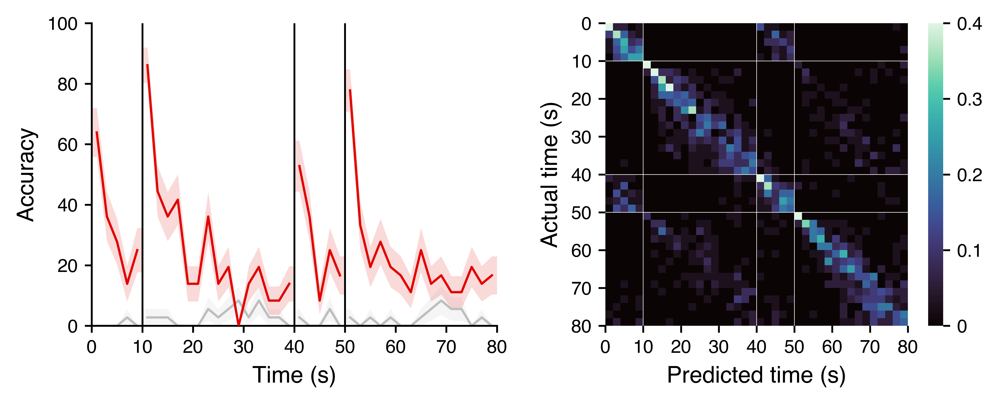

In [7]:
savefig = 0
overwrite = 1
dpi = 1200
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
vmax = 0.4 # 0.2
cbar_ticks = [0, 0.1, 0.2, 0.3, 0.4] # [0, 0.05, 0.1, 0.15, 0.2]
labelpad = 4
add_cbar = True
plot_null = True
alpha = 0.15
# figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# linewidth = 1
# spine_len = 1.8
# spine_lw = 0.5
figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
linewidth = 1
ticklength = 3
tickpad = 3
spine_len = 3
spine_lw = 0.8
xlinewidth = 0.25
y_col = 'iGameStateTime'
_cmap = 'mako'

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
if n_time_steps == 40:
    vlines = [0, 5, 20, 25, 40]
elif n_time_steps == 80:
    vlines = [0, 10, 40, 50, 80]
else:
    raise ValueError('Unexpected number of time steps; define vlines.')
reshp = [n_test, n_time_steps]
xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
xticklabels = xticks * int(80/n_time_steps)

# Report mean accuracy.
_mean = clf_dat['mean_acc'].mean()
_sem = stats.sem(clf_dat['mean_acc'].tolist())
df = len(clf_dat) - 1
tval, pval = stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null'])
print('{}: {:.1f} ± {:.1%} (t({})={:.1f}, p={})'.format(y_col, _mean * 100, _sem, df, tval, pval))
# obs = np.array(clf_dat['acc_by_time'].tolist())
# null = np.array(clf_dat['acc_by_time_null'].tolist())
# pvals = [stats.wilcoxon(obs[:, iTime], null[:, iTime], zero_method='pratt', alternative='greater')[1] for iTime in range(obs.shape[1])]
# sig, pvals_corr, *_ = sm.stats.multipletests(pvals, alpha=0.05, method='holm')

# Make plots.
iax = 0
ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
_means = np.split(np.mean(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
_sems = np.split(stats.sem(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
for ii in range(len(_means)):
    xvals = np.arange(vlines[ii], vlines[ii+1])
    _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
    __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
    __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
    ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
                         color='#e10600', linewidth=0, alpha=alpha, zorder=1)
    ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
                 linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/4)
if plot_null:
    _means_null = np.split(np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    _sems_null = np.split(stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    for ii in range(len(_means_null)):
        xvals = np.arange(vlines[ii], vlines[ii+1])
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
        __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
        ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
                             color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
                     linestyle='-', zorder=2) #, marker='o', markersize=font['annot']/4)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
_xticks = xticks - 0.5
ax[iax].set_xlim((_xticks[0], _xticks[-1]))
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin, ymax])
ax[iax].set_yticks(yticks)
ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)

iax += 1
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
vmin = vmin
vmax = vmax

ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, cmap=_cmap, ax=ax[iax])
ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
_xticks = xticks
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)

if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0, w_pad=0.5)

if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateTime-accuracy-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

iGameStateTime: 25.2 ± 1.2% (t(35)=18.1, p=2.1955300173741087e-19)


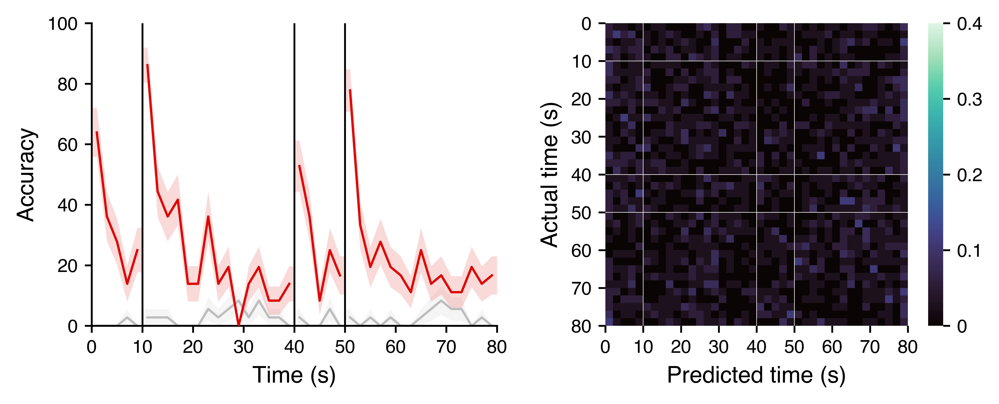

In [11]:
# Null confusion matrix.
savefig = 0
overwrite = 1
dpi = 1200
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
vmax = 0.4 # 0.2
cbar_ticks = [0, 0.1, 0.2, 0.3, 0.4] # [0, 0.05, 0.1, 0.15, 0.2]
labelpad = 4
add_cbar = True
plot_null = True
alpha = 0.15
# figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# linewidth = 1
# spine_len = 1.8
# spine_lw = 0.5
figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
linewidth = 1
ticklength = 3
tickpad = 3
spine_len = 3
spine_lw = 0.8
xlinewidth = 0.25
y_col = 'iGameStateTime'
_cmap = 'mako'

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
if n_time_steps == 40:
    vlines = [0, 5, 20, 25, 40]
elif n_time_steps == 80:
    vlines = [0, 10, 40, 50, 80]
else:
    raise ValueError('Unexpected number of time steps; define vlines.')
reshp = [n_test, n_time_steps]
xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
xticklabels = xticks * int(80/n_time_steps)

# Report mean accuracy.
_mean = clf_dat['mean_acc'].mean()
_sem = stats.sem(clf_dat['mean_acc'].tolist())
df = len(clf_dat) - 1
tval, pval = stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null'])
print('{}: {:.1f} ± {:.1%} (t({})={:.1f}, p={})'.format(y_col, _mean * 100, _sem, df, tval, pval))
# obs = np.array(clf_dat['acc_by_time'].tolist())
# null = np.array(clf_dat['acc_by_time_null'].tolist())
# pvals = [stats.wilcoxon(obs[:, iTime], null[:, iTime], zero_method='pratt', alternative='greater')[1] for iTime in range(obs.shape[1])]
# sig, pvals_corr, *_ = sm.stats.multipletests(pvals, alpha=0.05, method='holm')

# Make plots.
iax = 0
ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
_means = np.split(np.mean(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
_sems = np.split(stats.sem(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
for ii in range(len(_means)):
    xvals = np.arange(vlines[ii], vlines[ii+1])
    _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
    __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
    __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
    ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
                         color='#e10600', linewidth=0, alpha=alpha, zorder=1)
    ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
                 linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/4)
if plot_null:
    _means_null = np.split(np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    _sems_null = np.split(stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
    for ii in range(len(_means_null)):
        xvals = np.arange(vlines[ii], vlines[ii+1])
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
        __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
        ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
                             color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
                     linestyle='-', zorder=2) #, marker='o', markersize=font['annot']/4)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
_xticks = xticks - 0.5
ax[iax].set_xlim((_xticks[0], _xticks[-1]))
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin, ymax])
ax[iax].set_yticks(yticks)
ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)

iax += 1
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test_null'], x['y_test_pred_null'], normalize='true'), axis=1).tolist(), axis=0)
vmin = vmin
vmax = vmax

ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, cmap=_cmap, ax=ax[iax])
ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
_xticks = xticks
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)

if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0, w_pad=0.5)

if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateTime-accuracy-{}units-random_search-{}bins-36fold-null.pdf'.format(n_units, n_timebins))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

Accuracy
observed: 25.2 ± 1.2%
null: 2.4 ± 0.4%
within vs. null:  Ttest_relResult(statistic=18.14875166076022, pvalue=2.1955300173741087e-19)

Error distance
observed: 5.8 ± 0.3
null: 13.5 ± 0.3
within vs. null:  Ttest_relResult(statistic=-19.971193906091134, pvalue=1.0275846226342938e-20)



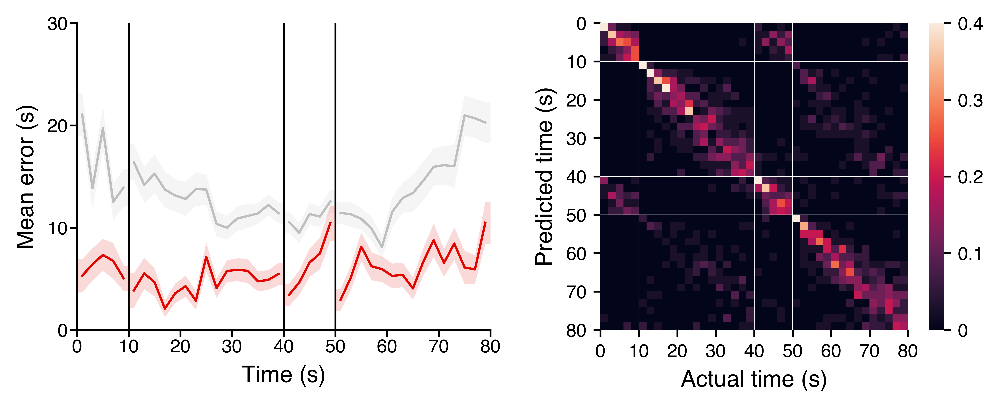

In [12]:
savefig = 0
overwrite = 0
dpi = 1200
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
vmax = 0.4 # 0.2
cbar_ticks = [0, 0.1, 0.2, 0.3, 0.4] # [0, 0.05, 0.1, 0.15, 0.2]
labelpad = 4
add_cbar = True
plot_null = True
alpha = 0.15
# figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# linewidth = 1
# spine_len = 1.8
# spine_lw = 0.5
figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
linewidth = 1
ticklength = 3
tickpad = 3
spine_len = 3
spine_lw = 0.8
xlinewidth = 0.25
y_col = 'iGameStateTime'
error_dist_mult = 1
ymin_error_dist = 0
ymax_error_dist = 30 # 60
yticks_error_dist = [0, 10, 20, 30] # [0, 20, 40, 60]

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
if n_time_steps == 40:
    vlines = [0, 5, 20, 25, 40]
elif n_time_steps == 80:
    vlines = [0, 10, 40, 50, 80]
else:
    raise ValueError('Unexpected number of time steps; define vlines.')
reshp = [n_test, n_time_steps]
xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
xticklabels = xticks * int(80/n_time_steps)

# Report mean accuracy.
# obs = np.array(clf_dat['acc_by_time'].tolist())
# null = np.array(clf_dat['acc_by_time_null'].tolist())
# pvals = [stats.wilcoxon(obs[:, iTime], null[:, iTime], zero_method='pratt', alternative='greater')[1] for iTime in range(obs.shape[1])]
# sig, pvals_corr, *_ = sm.stats.multipletests(pvals, alpha=0.05, method='holm')

# Run stats.
_mean, _sem = clf_dat['mean_acc'].mean(), stats.sem(clf_dat['mean_acc'])
_mean_null, _sem_null = clf_dat['mean_acc_null'].mean(), stats.sem(clf_dat['mean_acc_null'])
print('Accuracy',
      'observed: {:.1f} ± {:.1%}'.format(_mean * 100, _sem),
      'null: {:.1f} ± {:.1%}'.format(_mean_null * 100, _sem_null), sep='\n')
print('within vs. null: ', stats.ttest_rel(clf_dat['mean_acc'], clf_dat['mean_acc_null']), end='\n\n')

_mean, _sem = clf_dat['mean_abs_error_dist'].mean(), stats.sem(clf_dat['mean_abs_error_dist'])
_mean_null, _sem_null = clf_dat['mean_abs_error_dist_null'].mean(), stats.sem(clf_dat['mean_abs_error_dist_null'])
print('Error distance',
      'observed: {:.1f} ± {:.1}'.format(_mean, _sem),
      'null: {:.1f} ± {:.1}'.format(_mean_null, _sem_null), sep='\n')
print('within vs. null: ', stats.ttest_rel(clf_dat['mean_abs_error_dist'], clf_dat['mean_abs_error_dist_null']), end='\n\n')

# Make plots.
iax = -1

# Accuracy.
# iax += 1
# ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
# _means = np.split(np.mean(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
# _sems = np.split(stats.sem(clf_dat['acc_by_time'].tolist(), axis=0), vlines[1:-1])
# for ii in range(len(_means)):
#     xvals = np.arange(vlines[ii], vlines[ii+1])
#     _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#     __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
#     __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
#     ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                          color='#e10600', linewidth=0, alpha=alpha, zorder=1)
#     ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
#                  linestyle='-', marker='o', markersize=font['annot']/4, zorder=3)
# if plot_null:
#     _means_null = np.split(np.mean(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
#     _sems_null = np.split(stats.sem(clf_dat['acc_by_time_null'].tolist(), axis=0), vlines[1:-1])
#     for ii in range(len(_means_null)):
#         xvals = np.arange(vlines[ii], vlines[ii+1])
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
#         __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
#         ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
#                      linestyle='-', marker='o', markersize=font['annot']/4, zorder=2)
# for axis in ['left', 'bottom']:
#     ax[iax].spines[axis].set_linewidth(spine_lw)
# ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
# _xticks = xticks - 0.5
# ax[iax].set_xlim((_xticks[0], _xticks[-1]))
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylim([ymin, ymax])
# ax[iax].set_yticks(yticks)
# ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
# ax[iax].set_ylabel('Accuracy', fontsize=font['label'], labelpad=labelpad)

# Error distance.
iax += 1
ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin_error_dist, ymax_error_dist, colors='k', linewidths=spine_lw)
_means = np.split(np.mean(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
_sems = np.split(stats.sem(np.abs(clf_dat['error_dist'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
for ii in range(len(_means)):
    xvals = np.arange(vlines[ii], vlines[ii+1])
    _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
    __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
    __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
    ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
                         color='#e10600', linewidth=0, alpha=alpha, zorder=2)
    ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
                 linestyle='-', zorder=5) #, marker='o', markersize=font['annot']/3)
if plot_null:
    _means_null = np.split(np.mean(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
    _sems_null = np.split(stats.sem(np.abs(clf_dat['error_dist_null'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
    for ii in range(len(_means_null)):
        xvals = np.arange(vlines[ii], vlines[ii+1])
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
        __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
        ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
                             color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
                     linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/3)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
_xticks = xticks - 0.5
ax[iax].set_xlim([-0.5, xvals.size-0.5])
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
ax[iax].set_yticks(yticks_error_dist)
ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)

iax += 1
# cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
# vmin = vmin
# vmax = vmax

# ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
# ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
# _xticks = xticks
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_yticks(ax[iax].get_xticks())
# ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
# ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0).T
vmin = vmin
vmax = vmax

ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
_xticks = xticks
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels, rotation=0)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)

if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0, w_pad=0.5)

if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateTime-error_dist-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

In [35]:
np.flip(np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0).T, axis=0)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

observed: 68.6% ± 1.1%
null: 31.2% ± 1.6%

   Delay1: 69.2% ± 2.1% (null: 11.4% ± 2.0%)
 Encoding: 74.0% ± 1.9% (null: 39.4% ± 1.7%)
   Delay2: 61.9% ± 2.4% (null: 10.8% ± 0.6%)
Retrieval: 65.4% ± 1.5% (null: 36.3% ± 1.4%)


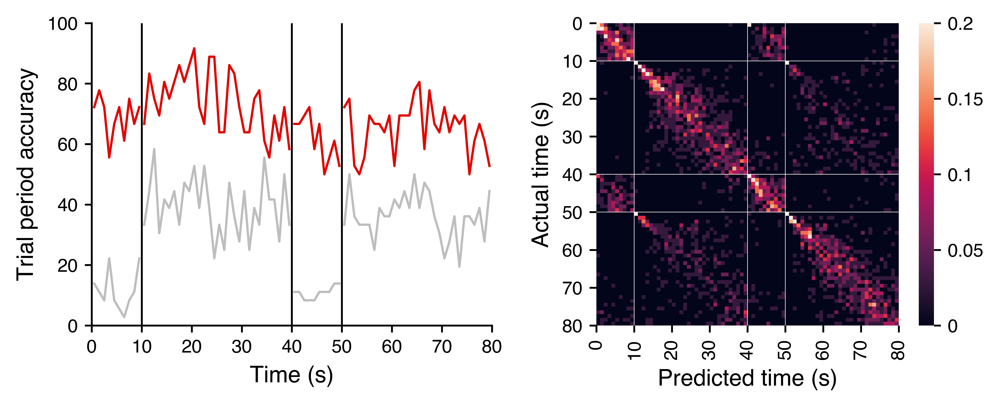

In [26]:
savefig = 0
overwrite = 0
dpi = 1200
vlines = [0, 10, 40, 50, 80] # [0, 5, 20, 25, 40]
ymin= 0
ymax = 1
yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
vmin = 0
vmax = 0.2
cbar_ticks = [0, 0.05, 0.1, 0.15, 0.2]
labelpad = 4
add_cbar = True
plot_null = True
alpha = 0.15
# figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# linewidth = 1
# spine_len = 1.8
# spine_lw = 0.5
figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
linewidth = 1
ticklength = 3
tickpad = 3
spine_len = 3
spine_lw = 0.8
xlinewidth = 0.25

# -----------------------------------------
plt.close()
fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
ax = np.ravel(ax)

clf_dat = clf_results
n_test = len(clf_dat.iloc[0]['test_trials'])
n_time_steps = clf_dat.iloc[0]['n_time_steps']
reshp = [n_test, n_time_steps]
xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
xticklabels = xticks * int(80/n_time_steps)

# Map each iGameStateTime value to its game state index.
gst_map = od({k: v
             for d in [{iTime: iGameState
                        for iTime in range(vlines[iGameState], vlines[iGameState+1])}
                       for iGameState in range(len(vlines)-1)]
             for k, v in d.items()})
clf_dat['y_test_gameState'] = clf_dat['y_test'].apply(lambda x: [gst_map[_x] for _x in x])
clf_dat['y_test_pred_gameState'] = clf_dat['y_test_pred'].apply(lambda x: [gst_map[_x] for _x in x])
clf_dat['accuracy_gameState'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState'][ii]==x['y_test_pred_gameState'][ii])) for ii in range(x['n_time_steps'])], axis=1)
clf_dat['y_test_gameState_null'] = clf_dat['y_test_null'].apply(lambda x: [gst_map[_x] for _x in x])
clf_dat['y_test_pred_gameState_null'] = clf_dat['y_test_pred_null'].apply(lambda x: [gst_map[_x] for _x in x])
clf_dat['accuracy_gameState_null'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState_null'][ii]==x['y_test_pred_gameState_null'][ii])) for ii in range(x['n_time_steps'])], axis=1)
acc_gs = np.array(clf_dat['accuracy_gameState'].tolist())
acc_gs_null = np.array(clf_dat['accuracy_gameState_null'].tolist())
acc_gs_split = np.split(np.mean(acc_gs, axis=0), vlines[1:-1])
acc_gs_null_split = np.split(np.mean(acc_gs_null, axis=0), vlines[1:-1])
print('observed: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs, axis=0)), stats.sem(np.mean(acc_gs, axis=0))))
print('null: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs_null, axis=0)), stats.sem(np.mean(acc_gs_null, axis=0))), end='\n\n')
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
for ii in range(len(game_states)):
    print('{:>9}: {:.1%} ± {:.1%} (null: {:.1%} ± {:.1%})'.format(game_states[ii],
                                                                  np.mean(acc_gs_split[ii]),
                                                                  stats.sem(acc_gs_split[ii]),
                                                                  np.mean(acc_gs_null_split[ii]),
                                                                  stats.sem(acc_gs_null_split[ii])))

# Make plots.

# Game state accuracy.
iax = 0
ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
_means = np.split(np.mean(acc_gs, axis=0), vlines[1:-1])
_sems = np.split(stats.sem(acc_gs, axis=0), vlines[1:-1])
for ii in range(len(_means)):
    xvals = np.arange(vlines[ii], vlines[ii+1])
    _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
    __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
    __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
#     ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                          color='#e10600', linewidth=0, alpha=alpha, zorder=1)
    ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
                 linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/4)
if plot_null:
    _means_null = np.split(np.mean(acc_gs_null, axis=0), vlines[1:-1])
    _sems_null = np.split(stats.sem(acc_gs_null, axis=0), vlines[1:-1])
    for ii in range(len(_means_null)):
        xvals = np.arange(vlines[ii], vlines[ii+1])
        _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
        __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
        __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
#         ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
        ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
                     linestyle='-', zorder=2) #, marker='o', markersize=font['annot']/4)
for axis in ['left', 'bottom']:
    ax[iax].spines[axis].set_linewidth(spine_lw)
ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
_xticks = xticks - 0.5
ax[iax].set_xlim((_xticks[0], _xticks[-1]))
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylim([ymin, ymax])
ax[iax].set_yticks(yticks)
ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
ax[iax].set_ylabel('Trial period accuracy', fontsize=font['label'], labelpad=labelpad)

# Confusion matrix.
iax += 1
cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
vmin = vmin
vmax = vmax
ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
_xticks = xticks
ax[iax].set_xticks(_xticks)
ax[iax].set_xticklabels(xticklabels)
ax[iax].set_yticks(ax[iax].get_xticks())
ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)

if add_cbar:
    cbar = ax[iax].collections[0].colorbar
    cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticks)
else:
    ax[iax].collections[0].colorbar.remove()
        
fig.tight_layout(pad=0, w_pad=0.5)

if savefig:
    n_timebins = cmat.shape[0]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateTime-gameStateAccuracy-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

fig.show()

observed: 68.6% ± 1.1%
null: 31.2% ± 1.6%

   Delay1: 69.2% ± 2.1% (null: 11.4% ± 2.0%)
 Encoding: 74.0% ± 1.9% (null: 39.4% ± 1.7%)
   Delay2: 61.9% ± 2.4% (null: 10.8% ± 0.6%)
Retrieval: 65.4% ± 1.5% (null: 36.3% ± 1.4%)


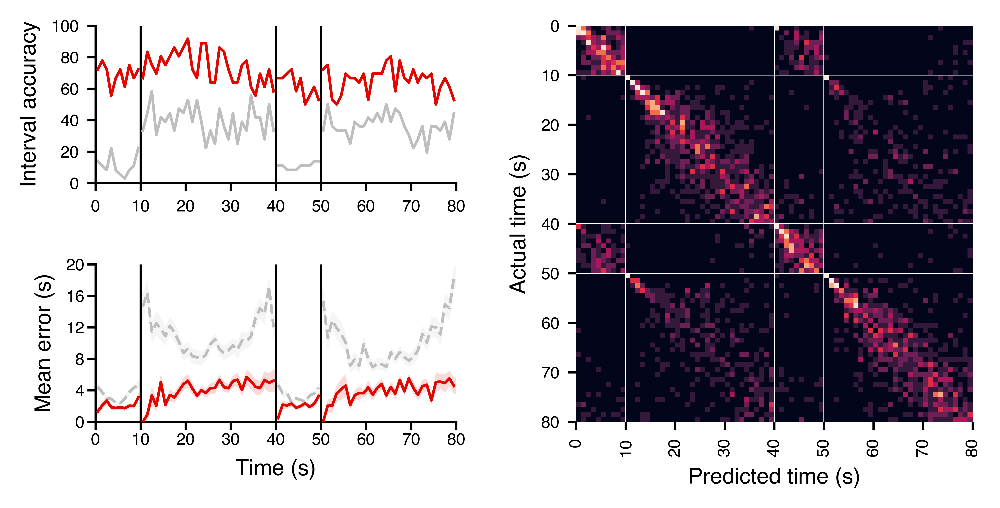

In [101]:
# savefig = 0
# overwrite = 0
# dpi = 1200
# vlines = [0, 10, 40, 50, 80] # [0, 5, 20, 25, 40]
# ymin= 0
# ymax = 1
# yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
# vmin = 0
# vmax = 0.2
# cbar_ticks = [0, 0.05, 0.1, 0.15, 0.2]
# add_cbar = False
# labelpad = 4
# plot_null = True
# alpha = 0.15
# # figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# font = {'tick': 6, 'label': 8, 'fig': 9, 'annot': 6}
# # linewidth = 1
# # spine_len = 1.8
# # spine_lw = 0.5
# figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.45)
# # font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
# linewidth = 1
# ticklength = 3
# tickpad = 3
# spine_len = 3
# spine_lw = 0.8
# xlinewidth = 0.25
# y_col = 'iGameStateTime'
# error_dist_mult = 1
# ymin_error_dist = 0
# ymax_error_dist = 20
# yticks_error_dist = [0, 4, 8, 12, 16, 20]

# # -----------------------------------------
# plt.close()
# # fig, ax = plt.subplots(1, 3, dpi=dpi, figsize=figsize)
# # ax = np.ravel(ax)
# fig = plt.figure(figsize=figsize, dpi=dpi)
# grid_shp = [45, 100]
# ax = [plt.subplot2grid(grid_shp, (0, 0), rowspan=18, colspan=40),
#       plt.subplot2grid(grid_shp, (27, 0), rowspan=18, colspan=40),
#       plt.subplot2grid(grid_shp, (0, 50), rowspan=45, colspan=50)]

# clf_dat = clf_results
# n_test = len(clf_dat.iloc[0]['test_trials'])
# n_time_steps = clf_dat.iloc[0]['n_time_steps']
# reshp = [n_test, n_time_steps]
# xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
# xticklabels = xticks * int(80/n_time_steps)

# # Map each iGameStateTime value to its game state index.
# gst_map = od({k: v
#              for d in [{iTime: iGameState
#                         for iTime in range(vlines[iGameState], vlines[iGameState+1])}
#                        for iGameState in range(len(vlines)-1)]
#              for k, v in d.items()})
# clf_dat['y_test_gameState'] = clf_dat['y_test'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['y_test_pred_gameState'] = clf_dat['y_test_pred'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['accuracy_gameState'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState'][ii]==x['y_test_pred_gameState'][ii])) for ii in range(x['n_time_steps'])], axis=1)
# clf_dat['y_test_gameState_null'] = clf_dat['y_test_null'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['y_test_pred_gameState_null'] = clf_dat['y_test_pred_null'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['accuracy_gameState_null'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState_null'][ii]==x['y_test_pred_gameState_null'][ii])) for ii in range(x['n_time_steps'])], axis=1)
# acc_gs = np.array(clf_dat['accuracy_gameState'].tolist())
# acc_gs_null = np.array(clf_dat['accuracy_gameState_null'].tolist())
# acc_gs_split = np.split(np.mean(acc_gs, axis=0), vlines[1:-1])
# acc_gs_null_split = np.split(np.mean(acc_gs_null, axis=0), vlines[1:-1])
# print('observed: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs, axis=0)), stats.sem(np.mean(acc_gs, axis=0))))
# print('null: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs_null, axis=0)), stats.sem(np.mean(acc_gs_null, axis=0))), end='\n\n')
# game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
# for ii in range(len(game_states)):
#     print('{:>9}: {:.1%} ± {:.1%} (null: {:.1%} ± {:.1%})'.format(game_states[ii],
#                                                                   np.mean(acc_gs_split[ii]),
#                                                                   stats.sem(acc_gs_split[ii]),
#                                                                   np.mean(acc_gs_null_split[ii]),
#                                                                   stats.sem(acc_gs_null_split[ii])))

# # Make plots.
# iax = -1

# # Game state accuracy.
# iax = 0
# ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin, ymax, colors='k', linewidths=spine_lw)
# _means = np.split(np.mean(acc_gs, axis=0), vlines[1:-1])
# _sems = np.split(stats.sem(acc_gs, axis=0), vlines[1:-1])
# for ii in range(len(_means)):
#     xvals = np.arange(vlines[ii], vlines[ii+1])
#     _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#     __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
#     __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
# #     ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
# #                          color='#e10600', linewidth=0, alpha=alpha, zorder=1)
#     ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
#                  linestyle='-', zorder=3) #, marker='o', markersize=font['annot']/4)
# if plot_null:
#     _means_null = np.split(np.mean(acc_gs_null, axis=0), vlines[1:-1])
#     _sems_null = np.split(stats.sem(acc_gs_null, axis=0), vlines[1:-1])
#     for ii in range(len(_means_null)):
#         xvals = np.arange(vlines[ii], vlines[ii+1])
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
#         __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
# #         ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
# #                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
#                      linestyle='-', zorder=2) #, marker='o', markersize=font['annot']/4)
# for axis in ['left', 'bottom']:
#     ax[iax].spines[axis].set_linewidth(spine_lw)
# ax[iax].tick_params(labelsize=font['tick'], length=spine_len, pad=tickpad, width=spine_lw)
# _xticks = xticks - 0.5
# ax[iax].set_xlim((_xticks[0], _xticks[-1]))
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_xlabel('') # Time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylim([ymin, ymax])
# ax[iax].set_yticks(yticks)
# ax[iax].set_yticklabels([int(x*100) for x in yticks], fontsize=font['tick'])
# ax[iax].set_ylabel('Interval accuracy', fontsize=font['label'], labelpad=labelpad)

# # Error distance.
# iax += 1
# ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin_error_dist, ymax_error_dist, colors='k', linewidths=spine_lw)

# def _f(x, idx_on, output_col):
#     output = np.ones(x['n_time_steps']) * np.nan
#     idx = np.where(x[idx_on])[0]
#     output[idx] = np.array(x[output_col])[idx]
#     return output.tolist()

# _means = np.split(np.nanmean(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState', 'error_dist')), axis=1).tolist(), axis=0) * error_dist_mult, vlines[1:-1])
# _sems = np.split(stats.sem(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState', 'error_dist')), axis=1).tolist(), axis=0, nan_policy='omit') * error_dist_mult, vlines[1:-1])
# for ii in range(len(_means)):
#     xvals = np.arange(vlines[ii], vlines[ii+1])
#     _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#     __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
#     __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
#     ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                          color='#e10600', linewidth=0, alpha=alpha, zorder=2)
#     ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
#                  linestyle='-', zorder=5) #, marker='o', markersize=font['annot']/3)
# if plot_null:
#     _means_null = [null_error_time[game_state][0] for game_state in game_states]
#     _sems_null = [null_error_time[game_state][1] for game_state in game_states]
# #     _means_null = np.split(np.nanmean(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState_null', 'error_dist_null')), axis=1).tolist(),
# #                                       axis=0) * error_dist_mult, vlines[1:-1])
# #     _sems_null = np.split(stats.sem(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState_null', 'error_dist_null')), axis=1).tolist(),
# #                                     axis=0, nan_policy='omit') * error_dist_mult, vlines[1:-1])
#     for ii in range(len(_means_null)):
#         xvals = np.arange(vlines[ii], vlines[ii+1])
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
#         __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
#         ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
#                      linestyle='--', zorder=3) #, marker='o', markersize=font['annot']/3)
# for axis in ['left', 'bottom']:
#     ax[iax].spines[axis].set_linewidth(spine_lw)
# ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
# _xticks = xticks - 0.5
# ax[iax].set_xlim([-0.5, xvals.size-0.5])
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
# ax[iax].set_yticks(yticks_error_dist)
# ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
# ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)

# iax += 1
# cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
# vmin = vmin
# vmax = vmax

# ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, cbar=add_cbar, ax=ax[iax])
# ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
# _xticks = xticks
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_yticks(ax[iax].get_xticks())
# ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
# ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)

# if add_cbar:
#     cbar = ax[iax].collections[0].colorbar
#     cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
#     cbar.set_ticks(cbar_ticks)
#     cbar.set_ticklabels(cbar_ticks)
# # else:
# #     ax[iax].collections[0].colorbar.remove()
        
# # fig.tight_layout(pad=0, w_pad=0.5)

# if savefig:
#     n_timebins = cmat.shape[0]
#     filename = op.join(proj_dir, 'figs', 'classifiers', 
#                        'SVC_predicting_iGameStateTime-accuracy_and_error_dist-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
#     if overwrite or not op.exists(filename):
#         fig.savefig(filename, format='pdf', bbox_inches='tight')
#         fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

# fig.show()

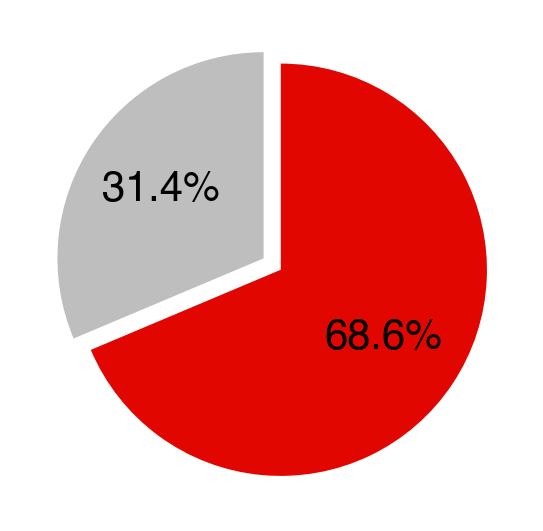

In [90]:
# Make a pie chart to show percent of time bins whose
# game states were correctly classified.
savefig = 0
overwrite = 1
dpi = 1200
font = {'tick': 8, 'label': 8, 'annot': 8, 'fig': 10}
_cmap = ['#bebebe', '#e10600']
spine_lw = 0.5

# -------------------
plt.close()
fig, ax = plt.subplots(1, 1, figsize=(colws[1], colws[1]), dpi=300)

n_correct = np.sum(acc_gs)
n_incorrect = acc_gs.size - n_correct

ax.pie([n_incorrect, n_correct],
       colors=_cmap, explode=[0.1, 0],
       autopct='%1.1f%%', shadow=False, startangle=90)
ax.axis('equal')

if savefig:
    n_timebins = acc_gs.shape[1]
    filename = op.join(proj_dir, 'figs', 'classifiers', 
                       'SVC_predicting_iGameStateTime-game_state_accuracy-pie_chart-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
    if overwrite or not op.exists(filename):
        fig.savefig(filename, format='pdf', bbox_inches='tight')
        fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')
        
fig.show()

observed: 68.6% ± 1.1%
null: 31.2% ± 1.6%

   Delay1: 69.2% ± 2.1% (null: 11.4% ± 2.0%)
 Encoding: 74.0% ± 1.9% (null: 39.4% ± 1.7%)
   Delay2: 61.9% ± 2.4% (null: 10.8% ± 0.6%)
Retrieval: 65.4% ± 1.5% (null: 36.3% ± 1.4%)


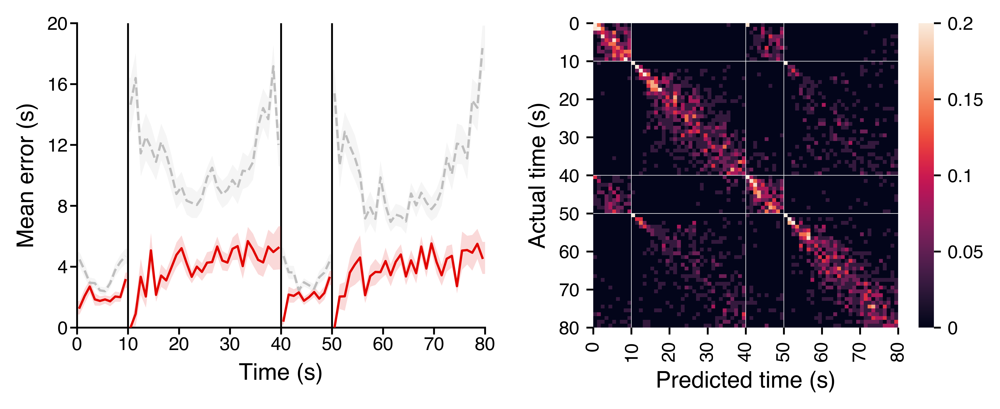

In [41]:
# savefig = 0
# overwrite = 0
# dpi = 1200
# vlines = [0, 10, 40, 50, 80] # [0, 5, 20, 25, 40]
# ymin= 0
# ymax = 1
# yticks = [0, 0.2, 0.4, 0.6, 0.8, 1]
# vmin = 0
# vmax = 0.2
# cbar_ticks = [0, 0.05, 0.1, 0.15, 0.2]
# labelpad = 4
# add_cbar = True
# plot_null = True
# alpha = 0.15
# # figsize = (colws[3]*0.75, colws[2]*0.85*0.75)
# # font = {'tick': 6, 'label': 7, 'fig': 9, 'annot': 6}
# # linewidth = 1
# # spine_len = 1.8
# # spine_lw = 0.5
# figsize = (0.9 * colws['1'], 0.9 * colws['1']*0.38)
# font = {'tick': 8, 'label': 10, 'annot': 8, 'fig': 14}
# linewidth = 1
# ticklength = 3
# tickpad = 3
# spine_len = 3
# spine_lw = 0.8
# xlinewidth = 0.25
# y_col = 'iGameStateTime'
# error_dist_mult = 1
# ymin_error_dist = 0
# ymax_error_dist = 20
# yticks_error_dist = [0, 4, 8, 12, 16, 20]

# # -----------------------------------------
# plt.close()
# fig, ax = plt.subplots(1, 2, dpi=dpi, figsize=figsize)
# ax = np.ravel(ax)

# clf_dat = clf_results
# n_test = len(clf_dat.iloc[0]['test_trials'])
# n_time_steps = clf_dat.iloc[0]['n_time_steps']
# reshp = [n_test, n_time_steps]
# xticks = np.arange(0, n_time_steps+1, 10/int(80/n_time_steps), dtype=int)
# xticklabels = xticks * int(80/n_time_steps)

# # Map each iGameStateTime value to its game state index.
# gst_map = od({k: v
#              for d in [{iTime: iGameState
#                         for iTime in range(vlines[iGameState], vlines[iGameState+1])}
#                        for iGameState in range(len(vlines)-1)]
#              for k, v in d.items()})
# clf_dat['y_test_gameState'] = clf_dat['y_test'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['y_test_pred_gameState'] = clf_dat['y_test_pred'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['accuracy_gameState'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState'][ii]==x['y_test_pred_gameState'][ii])) for ii in range(x['n_time_steps'])], axis=1)
# clf_dat['y_test_gameState_null'] = clf_dat['y_test_null'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['y_test_pred_gameState_null'] = clf_dat['y_test_pred_null'].apply(lambda x: [gst_map[_x] for _x in x])
# clf_dat['accuracy_gameState_null'] = clf_dat.apply(lambda x: [int(1 * (x['y_test_gameState_null'][ii]==x['y_test_pred_gameState_null'][ii])) for ii in range(x['n_time_steps'])], axis=1)
# acc_gs = np.array(clf_dat['accuracy_gameState'].tolist())
# acc_gs_null = np.array(clf_dat['accuracy_gameState_null'].tolist())
# acc_gs_split = np.split(np.mean(acc_gs, axis=0), vlines[1:-1])
# acc_gs_null_split = np.split(np.mean(acc_gs_null, axis=0), vlines[1:-1])
# print('observed: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs, axis=0)), stats.sem(np.mean(acc_gs, axis=0))))
# print('null: {:.1%} ± {:.1%}'.format(np.mean(np.mean(acc_gs_null, axis=0)), stats.sem(np.mean(acc_gs_null, axis=0))), end='\n\n')
# game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
# for ii in range(len(game_states)):
#     print('{:>9}: {:.1%} ± {:.1%} (null: {:.1%} ± {:.1%})'.format(game_states[ii],
#                                                                   np.mean(acc_gs_split[ii]),
#                                                                   stats.sem(acc_gs_split[ii]),
#                                                                   np.mean(acc_gs_null_split[ii]),
#                                                                   stats.sem(acc_gs_null_split[ii])))

# # Make plots.
# iax = -1

# # Error distance.
# iax += 1
# ax[iax].vlines(np.array(vlines)[1:-1] - 0.5, ymin_error_dist, ymax_error_dist, colors='k', linewidths=spine_lw)

# def _f(x, idx_on, output_col):
#     output = np.ones(x['n_time_steps']) * np.nan
#     idx = np.where(x[idx_on])[0]
#     output[idx] = np.array(x[output_col])[idx]
#     return output.tolist()

# _means = np.split(np.nanmean(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState', 'error_dist')), axis=1).tolist(), axis=0) * error_dist_mult, vlines[1:-1])
# _sems = np.split(stats.sem(clf_dat.apply(lambda x: np.abs(_f(x, 'accuracy_gameState', 'error_dist')), axis=1).tolist(), axis=0, nan_policy='omit') * error_dist_mult, vlines[1:-1])
# for ii in range(len(_means)):
#     xvals = np.arange(vlines[ii], vlines[ii+1])
#     _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#     __means = np.concatenate([(_means[ii][0],), _means[ii], (_means[ii][-1],)])
#     __sems = np.concatenate([(_sems[ii][0],), _sems[ii], (_sems[ii][-1],)])
#     ax[iax].fill_between(_xvals, __means + __sems, __means - __sems,
#                          color='#e10600', linewidth=0, alpha=alpha, zorder=2)
#     ax[iax].plot(xvals, _means[ii], color='#e10600', linewidth=linewidth,
#                  linestyle='-', zorder=5) #, marker='o', markersize=font['annot']/3)
# if plot_null:
#     _means_null = [null_error_time[game_state][0] for game_state in game_states]
#     _sems_null = [null_error_time[game_state][1] for game_state in game_states]
# #     _means_null = np.split(np.mean(np.abs(clf_dat.query("(accuracy_gameState_null==1)")['error_dist_null'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
# #     _sems_null = np.split(stats.sem(np.abs(clf_dat.query("(accuracy_gameState_null==1)")['error_dist_null'].tolist()), axis=0) * error_dist_mult, vlines[1:-1])
#     for ii in range(len(_means_null)):
#         xvals = np.arange(vlines[ii], vlines[ii+1])
#         _xvals = np.concatenate([(xvals[0]-0.5,), xvals, (xvals[-1]+0.5,)])
#         __means_null = np.concatenate([(_means_null[ii][0],), _means_null[ii], (_means_null[ii][-1],)])
#         __sems_null = np.concatenate([(_sems_null[ii][0],), _sems_null[ii], (_sems_null[ii][-1],)])
#         ax[iax].fill_between(_xvals, __means_null + __sems_null, __means_null - __sems_null,
#                              color='#bebebe', linewidth=0, alpha=alpha, zorder=0)
#         ax[iax].plot(xvals, _means_null[ii], color='#bebebe', linewidth=linewidth,
#                      linestyle='--', zorder=3) #, marker='o', markersize=font['annot']/3)
# for axis in ['left', 'bottom']:
#     ax[iax].spines[axis].set_linewidth(spine_lw)
# ax[iax].tick_params(labelsize=font['tick'], pad=1, length=spine_len, width=spine_lw)
# _xticks = xticks - 0.5
# ax[iax].set_xlim([-0.5, xvals.size-0.5])
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_xlabel('Time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylim([ymin_error_dist, ymax_error_dist])
# ax[iax].set_yticks(yticks_error_dist)
# ax[iax].set_yticklabels(yticks_error_dist, fontsize=font['tick'])
# ax[iax].set_ylabel('Mean error (s)', fontsize=font['label'], labelpad=labelpad)

# iax += 1
# cmat = np.mean(clf_dat.apply(lambda x: confusion_matrix(x['y_test'], x['y_test_pred'], normalize='true'), axis=1).tolist(), axis=0)
# vmin = vmin
# vmax = vmax

# ax[iax] = sns.heatmap(cmat, vmin=vmin, vmax=vmax, square=True, ax=ax[iax])
# ax[iax].hlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].vlines(np.array(vlines)[1:-1], 0, n_time_steps, colors='w', linewidths=xlinewidth)
# ax[iax].tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
# _xticks = xticks
# ax[iax].set_xticks(_xticks)
# ax[iax].set_xticklabels(xticklabels)
# ax[iax].set_yticks(ax[iax].get_xticks())
# ax[iax].set_yticklabels(ax[iax].get_xticklabels(), rotation=0)
# ax[iax].set_xlabel('Predicted time (s)', fontsize=font['label'], labelpad=labelpad)
# ax[iax].set_ylabel('Actual time (s)', fontsize=font['label'], labelpad=labelpad)

# if add_cbar:
#     cbar = ax[iax].collections[0].colorbar
#     cbar.ax.tick_params(labelsize=font['tick'], pad=tickpad, length=spine_len, width=spine_lw)
#     cbar.set_ticks(cbar_ticks)
#     cbar.set_ticklabels(cbar_ticks)
# else:
#     ax[iax].collections[0].colorbar.remove()
        
# fig.tight_layout(pad=0, w_pad=0.5)

# if savefig:
#     n_timebins = cmat.shape[0]
#     filename = op.join(proj_dir, 'figs', 'classifiers', 
#                        'SVC_predicting_iGameStateTime-error_dist-{}units-random_search-{}bins-36fold.pdf'.format(n_units, n_timebins))
#     if overwrite or not op.exists(filename):
#         fig.savefig(filename, format='pdf', bbox_inches='tight')
#         fig.savefig(filename.replace('pdf', 'png'), format='png', dpi=dpi, bbox_inches='tight')

# fig.show()

# Processing

In [ ]:
# Predict time within each game state from population neural activity,
# using support vector classification with nested cross-validation.
start_time = time()

# Input params.
y_col = 'time_step'
game_states = ['Delay1', 'Encoding', 'Delay2', 'Retrieval']
time_steps_per_game_state = {'Delay1': 5,
                             'Encoding': 15,
                             'Delay2': 5,
                             'Retrieval': 15}
n_perm = 1000
n_trials = 36
n_test_trials = 6
kfold_inner = 5
search_method = 'random' # 'grid' or 'random'
n_vals_per_hyperparam = 7 # for grid search
n_iter = 100 # for random search
n_jobs = 32 # for running parameter search
save_results = True
overwrite = True
verbose = 0

# Build a processing pipeline.
# 1. Impute missing data by replacing NaNs with their column-wise median.
# 2. Z-score the values in each column.
# 3. Train a support vector classifier with RBF kernel.
pipe = Pipeline(steps=[('impute', SimpleImputer(strategy='median')),
                       ('scale', StandardScaler()),
                       ('svc', SVC(kernel='rbf'))])

# Define a function that sets up parameter search 
# for the inner cross-validation.
def setup_param_search():
    """Return an estimator."""
    inner_cv = KFold(kfold_inner)
    
    if search_method == 'grid':    
        param_grid = {'svc__C'     : np.logspace(-5, 5, n_vals_per_hyperparam),
                      'svc__gamma' : np.logspace(-5, 5, n_vals_per_hyperparam)}
        clf = GridSearchCV(estimator=pipe,
                           param_grid=param_grid,
                           refit=True,
                           cv=inner_cv,
                           n_jobs=n_jobs,
                           verbose=verbose)
    elif search_method == 'random':
        param_dist = {'svc__C'     : loguniform(1e-9, 1e9),
                      'svc__gamma' : loguniform(1e-9, 1e9)}
        clf = RandomizedSearchCV(estimator=pipe,
                                 param_distributions=param_dist,
                                 refit=True,
                                 cv=inner_cv,
                                 n_jobs=n_jobs,
                                 n_iter=n_iter)
    return clf

def get_mean_accuracy(acc_vec, reshp):
    """Return mean accuracy across time_bins.
    
    Parameters
    ----------
    acc_vec : list
        Accuracy vector comparing y_test to y_test_pred 
        at each time bin, across test trials.
    reshp : list
        (n_test_trials, n_time_bins)
    """
    return np.mean(np.array(acc_vec).reshape(reshp), axis=0).tolist()

clf_results = []
for game_state in game_states:
    print('{}: {:.1f}s'.format(game_state, time() - start_time))
    
    # Select time bins across trials for the current game state.
    _pop_spikes = pop_spikes.query("(gameState=='{}')".format(game_state)).copy()

    # Aggregate time bins into a defined number of equal-size, larger time steps.
    n_time_bins = np.unique(_pop_spikes['time_bin']).size
    n_time_steps = time_steps_per_game_state[game_state]
    bins_per_step = int(n_time_bins / n_time_steps)
    _pop_spikes.insert(2, 'time_step', _pop_spikes['time_bin'].apply(lambda time_bin: int(time_bin/bins_per_step)))

    # For each unit, sum spikes within each time step.
    _pop_spikes = _pop_spikes.groupby(['gameState', 'trial', 'time_step'], observed=True)[neurons].apply(np.sum).reset_index()
    
    # Randomly split trials into test and trainval sets.
    test_trainval = []
    for iPerm in range(n_perm):
        trials = np.random.permutation(np.arange(1, n_trials+1)).tolist()
        test_trainval.append([trials[:n_test_trials], trials[n_test_trials:]])

    # Perform repeated, nested cross-validation, splitting trials into 
    # test and nested train/val sets.
    for iPerm in range(n_perm):
        # Select the test and trainval trials.
        test, trainval = test_trainval[iPerm]
        
        # ---------------------------------
        # Observed data:
        #
        # Split trials into trainval and test sets.
        X_test = _pop_spikes.loc[np.isin(_pop_spikes['trial'], test)][neurons].values
        y_test = _pop_spikes.loc[np.isin(_pop_spikes['trial'], test)][y_col].values
        X_trainval = _pop_spikes.loc[np.isin(_pop_spikes['trial'], trainval)][neurons].values
        y_trainval = _pop_spikes.loc[np.isin(_pop_spikes['trial'], trainval)][y_col].values

        # Setup grid search on the inner CV.
        clf = setup_param_search()

        # Train the model on trainval data.
        clf.fit(X_trainval, y_trainval)
        best_trainval_score = clf.best_score_
        best_trainval_C = clf.best_params_['svc__C']
        best_trainval_gamma = clf.best_params_['svc__gamma']

        # Predict time from neural activity on test data.
        y_test_pred = clf.predict(X_test).tolist()

        # Calculate accuracy.
        accuracy = [y_test_pred[iVal]==y_test[iVal] for iVal in range(len(y_test))]
        acc_by_time = get_mean_accuracy(accuracy, reshp=(len(test), n_time_steps))
        mean_acc = np.mean(accuracy)

        # ---------------------------------
        # Null distribution:
        #
        # Circ-shift time steps within each trial to randomize 
        # time_step ~ pop_spiking associations across trials.
        shuf_idx = np.concatenate(_pop_spikes.reset_index()
                                             .groupby('trial')['index']
                                             .apply(lambda x: np.roll(x, np.random.randint(0, len(x))))
                                             .tolist())
        _pop_spikes_null = _pop_spikes.copy()
        _pop_spikes_null[y_col] = _pop_spikes_null.loc[shuf_idx, y_col].values
        
        # Split trials into trainval and test sets, using the same split as
        # for the observed data.
        X_test_null = _pop_spikes_null.loc[np.isin(_pop_spikes_null['trial'], test)][neurons].values
        y_test_null = _pop_spikes_null.loc[np.isin(_pop_spikes_null['trial'], test)][y_col].values
        X_trainval_null = _pop_spikes_null.loc[np.isin(_pop_spikes_null['trial'], trainval)][neurons].values
        y_trainval_null = _pop_spikes_null.loc[np.isin(_pop_spikes_null['trial'], trainval)][y_col].values

        # Setup grid search on the inner CV.
        clf_null = setup_param_search()

        # Train the model on trainval data.
        clf_null.fit(X_trainval_null, y_trainval_null)
        best_trainval_score_null = clf_null.best_score_
        best_trainval_C_null = clf_null.best_params_['svc__C']
        best_trainval_gamma_null = clf_null.best_params_['svc__gamma']
        
        # Predict time from neural activity on test data.
        y_test_pred_null = clf_null.predict(X_test_null).tolist()

        # Calculate accuracy.
        accuracy_null = [y_test_pred_null[iVal]==y_test_null[iVal] for iVal in range(len(y_test_null))]
        acc_by_time_null = get_mean_accuracy(accuracy_null, reshp=(len(test), n_time_steps))
        mean_acc_null = np.mean(accuracy_null)
        
        # Append results to the output dataframe.
        clf_results.append([game_state,
                            n_time_steps,
                            test,
                            best_trainval_score,
                            best_trainval_C,
                            best_trainval_gamma,
                            y_test,
                            y_test_pred,
                            mean_acc,
                            acc_by_time,
                            accuracy,
                            clf,
                            best_trainval_score_null,
                            best_trainval_C_null,
                            best_trainval_gamma_null,
                            y_test_null,
                            y_test_pred_null,
                            mean_acc_null,
                            acc_by_time_null,
                            accuracy_null,
                            clf_null])

cols = ['gameState',
        'n_time_steps',
        'test_trials',
        'best_trainval_score',
        'best_trainval_C',
        'best_trainval_gamma',
        'y_test',
        'y_test_pred',
        'mean_acc',
        'acc_by_time',
        'accuracy',
        'clf',
        'best_trainval_score_null',
        'best_trainval_C_null',
        'best_trainval_gamma_null',
        'y_test_null',
        'y_test_pred_null',
        'mean_acc_null',
        'acc_by_time_null',
        'accuracy_null',
        'clf_null']
clf_results = pd.DataFrame(clf_results, columns=cols)

if save_results:
    basename = 'SVC_predicting_{}'.format(y_col)
    basename += '-{}units'.format(len(neurons))
    basename += '-{}_search'.format(search_method)
    basename += '-{}perm'.format(n_perm)
    basename += '-' + '-'.join(['{}_{}bins'.format(game_state, time_steps_per_game_state[game_state]) for game_state in game_states])
    basename += '.pkl'
    filename = op.join(proj_dir, 'analysis', 'classifiers', basename)
    if overwrite or not op.exists(filename):
        dio.save_pickle(clf_results, filename)
        
print('Done in {:.1f}s'.format(time() - start_time))

Delay1: 0.0s
Encoding: 5201.9s
Delay2: 15934.9s
